In [1]:
# sph related imports
from sph import *
from perlin import *
# neural network rlated imports
from torch.optim import Adam
from rbfConv import *
from torch_geometric.loader import DataLoader
from trainingHelper import *
# plotting/UI related imports
from plotting import *
import matplotlib as mpl
# plt.style.use('dark_background')
cmap = mpl.colormaps['viridis']
from tqdm.notebook import trange, tqdm
from IPython.display import display, Latex
from datetime import datetime
from rbfNet import *
from tqdm.notebook import tqdm
import h5py
import matplotlib.colors as colors
%matplotlib notebook

In [2]:
torch.cuda.is_available()

True

In [3]:
trainingFiles = ['./output/' + f for f in os.listdir('./output/') if f.endswith('.hdf5')]
testingFiles = ['./outputTest/' + f for f in os.listdir('./outputTest/') if f.endswith('.hdf5')]
# print(testingFiles)

In [4]:
# Load generic settings
inFile = h5py.File(trainingFiles[0],'r')
minDomain = inFile.attrs['minDomain']
maxDomain = inFile.attrs['maxDomain']

baseArea = inFile.attrs['baseArea']
particleRadius = inFile.attrs['particleRadius']
particleSupport = inFile.attrs['particleSupport']

xsphConstant = inFile.attrs['xsphConstant']
diffusionAlpha = inFile.attrs['diffusionAlpha']
diffusionBeta = inFile.attrs['diffusionBeta']
kappa = inFile.attrs['kappa']
restDensity = inFile.attrs['restDensity']
c0 = inFile.attrs['c0']
dt = inFile.attrs['dt']

numParticles = inFile.attrs['numParticles']
timesteps = inFile.attrs['timesteps']

generator = inFile.attrs['generator']
inFile.close()

# Load generator settings
settings = {}
for f in trainingFiles:
    inFile = h5py.File(f,'r')
    generatorSettings = {}
    for k in inFile['generatorSettings'].attrs.keys():
        generatorSettings[k] = inFile['generatorSettings'].attrs[k]
#     print(generatorSettings)
    setup = {}
    setup['generatorSettings'] = generatorSettings
    setup['minDomain'] = inFile.attrs['minDomain']
    setup['maxDomain'] = inFile.attrs['maxDomain']

    setup['baseArea'] = inFile.attrs['baseArea']
    setup['particleRadius'] = inFile.attrs['particleRadius']
    setup['particleSupport'] = inFile.attrs['particleSupport']

    setup['xsphConstant'] = inFile.attrs['xsphConstant']
    setup['diffusionAlpha'] = inFile.attrs['diffusionAlpha']
    setup['diffusionBeta'] = inFile.attrs['diffusionBeta']
    setup['kappa'] = inFile.attrs['kappa']
    setup['restDensity'] = inFile.attrs['restDensity']
    setup['c0'] = inFile.attrs['c0']
    setup['dt'] = inFile.attrs['dt']

    setup['numParticles'] = inFile.attrs['numParticles']
    setup['timesteps'] = inFile.attrs['timesteps']

    setup['generator'] = inFile.attrs['generator']
    settings[f] = setup
    inFile.close()
    
for f in testingFiles:
    inFile = h5py.File(f,'r')
    generatorSettings = {}
    for k in inFile['generatorSettings'].attrs.keys():
        generatorSettings[k] = inFile['generatorSettings'].attrs[k]
#     print(generatorSettings)
    setup = {}
    setup['generatorSettings'] = generatorSettings
    setup['minDomain'] = inFile.attrs['minDomain']
    setup['maxDomain'] = inFile.attrs['maxDomain']

    setup['baseArea'] = inFile.attrs['baseArea']
    setup['particleRadius'] = inFile.attrs['particleRadius']
    setup['particleSupport'] = inFile.attrs['particleSupport']

    setup['xsphConstant'] = inFile.attrs['xsphConstant']
    setup['diffusionAlpha'] = inFile.attrs['diffusionAlpha']
    setup['diffusionBeta'] = inFile.attrs['diffusionBeta']
    setup['kappa'] = inFile.attrs['kappa']
    setup['restDensity'] = inFile.attrs['restDensity']
    setup['c0'] = inFile.attrs['c0']
    setup['dt'] = inFile.attrs['dt']

    setup['numParticles'] = inFile.attrs['numParticles']
    setup['timesteps'] = inFile.attrs['timesteps']

    setup['generator'] = inFile.attrs['generator']
    settings[f] = setup
    inFile.close()

<IPython.core.display.Javascript object>


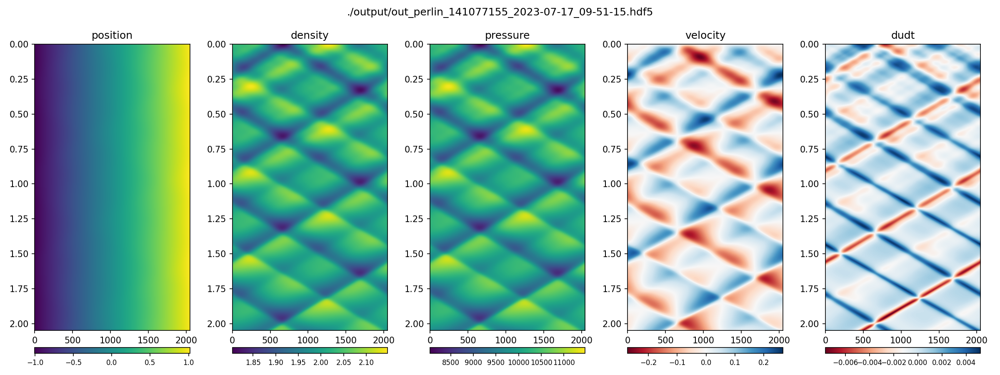

In [5]:
def loadFile(t, plot = False):
    inFile = h5py.File(t,'r')
    fluidPositions = np.array(inFile['simulationData']['fluidPosition'])
    
    fluidVelocities = np.array(inFile['simulationData']['fluidVelocities'])
    fluidDensity = np.array(inFile['simulationData']['fluidDensity'])
    fluidPressure = np.array(inFile['simulationData']['fluidPressure'])
    fluidAreas = np.array(inFile['simulationData']['fluidAreas'])
    dudt = np.array(inFile['simulationData']['dudt'])
    if plot:
        fig, axis = plt.subplots(1, 5, figsize=(16,6), sharex = False, sharey = False, squeeze = False)

        def plot(fig, axis, mat, title, cmap = 'viridis'):
            im = axis.imshow(mat, extent = [0,numParticles,dt * timesteps,0], cmap = cmap)
            axis.axis('auto')
            ax1_divider = make_axes_locatable(axis)
            cax1 = ax1_divider.append_axes("bottom", size="2%", pad="6%")
            cb1 = fig.colorbar(im, cax=cax1,orientation='horizontal')
            cb1.ax.tick_params(labelsize=8) 
            axis.set_title(title)
        plot(fig,axis[0,0], fluidPositions, 'position')
        plot(fig,axis[0,1], fluidDensity, 'density')
        plot(fig,axis[0,2], fluidPressure, 'pressure')
        plot(fig,axis[0,3], fluidVelocities, 'velocity', 'RdBu')
        plot(fig,axis[0,4], dudt, 'dudt', 'RdBu')

        fig.suptitle(t)
        fig.tight_layout()
    inFile.close()
    return {'positions': torch.tensor(fluidPositions).type(torch.float32), 'density': torch.tensor(fluidDensity).type(torch.float32), 'pressure':torch.tensor(fluidPressure).type(torch.float32), 'area': torch.tensor(fluidAreas).type(torch.float32), 'velocity': torch.tensor(fluidVelocities).type(torch.float32), 'dudt' : torch.tensor(dudt).type(torch.float32)}
data = loadFile(trainingFiles[0], True)

<IPython.core.display.Javascript object>


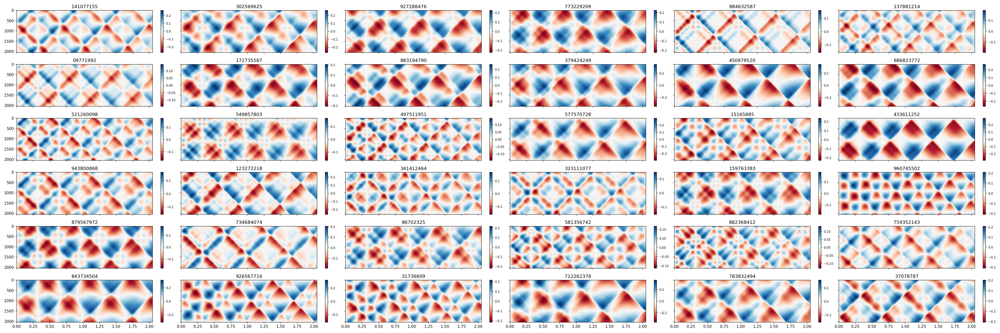

In [6]:
ns = int(np.sqrt(len(trainingFiles)))
fig, axis = plt.subplots(ns, ns, figsize=(ns*6,ns * 2), sharex = True, sharey = True, squeeze = False)

def plot(fig, axis, mat, title, cmap = 'viridis'):
    im = axis.imshow(mat, extent = [0,dt * timesteps,numParticles,0], cmap = cmap)
    axis.axis('auto')
    ax1_divider = make_axes_locatable(axis)
    cax1 = ax1_divider.append_axes("right", size="2%", pad="6%")
    cb1 = fig.colorbar(im, cax=cax1,orientation='vertical')
    cb1.ax.tick_params(labelsize=8) 
    axis.set_title(title)

for i in range(ns):
    for j in range(ns):
        data = loadFile(trainingFiles[ns * j + i], False)
        plot(fig,axis[i,j], data['velocity'].mT, trainingFiles[ns * j + i].split('/')[-1].split('.')[0].split('_')[2], 'RdBu')
#         plot(fig,axis[i,j], data['dudt'].mT, trainingFiles[ns * j + i].split('/')[-1].split('.')[0].split('_')[2], 'RdBu')

fig.tight_layout()

<IPython.core.display.Javascript object>


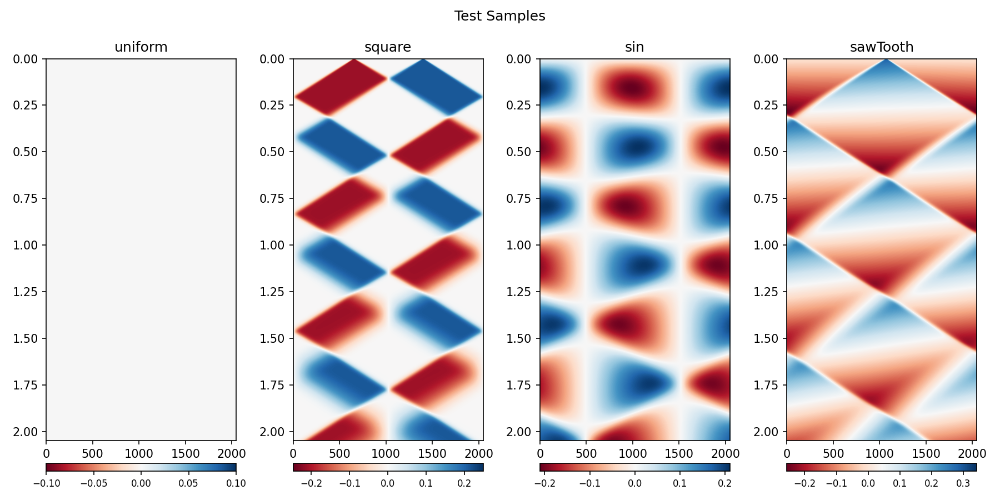

In [7]:

fig, axis = plt.subplots(1, len(testingFiles), figsize=(len(testingFiles)*3,6), sharex = False, sharey = False, squeeze = False)

def plot(fig, axis, mat, title, cmap = 'viridis'):
    im = axis.imshow(mat, extent = [0,numParticles,dt * timesteps,0], cmap = cmap)
    axis.axis('auto')
    ax1_divider = make_axes_locatable(axis)
    cax1 = ax1_divider.append_axes("bottom", size="2%", pad="6%")
    cb1 = fig.colorbar(im, cax=cax1,orientation='horizontal')
    cb1.ax.tick_params(labelsize=8) 
    axis.set_title(title)
    
for i in range(len(testingFiles)):
    data = loadFile(testingFiles[i], False)
    plot(fig,axis[0,i], data['velocity'], testingFiles[i].split('/')[-1].split('.')[0], 'RdBu')

fig.suptitle('Test Samples')
fig.tight_layout()

In [8]:
testingFiles = trainingFiles[-4:]
trainingFiles = trainingFiles[:-4]
print(len(testingFiles))

4


In [10]:
trainingData = {}
for f in tqdm(trainingFiles):
    trainingData[f] = loadFile(f, False)
testingData = {}
for f in tqdm(testingFiles):
    testingData[f] = loadFile(f, False)

# inFile.close()

  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

In [11]:
print(trainingData[trainingFiles[0]]['positions'][:1024,:])
import matplotlib.colors as colors

tensor([[-1.0000, -0.9990, -0.9981,  ...,  0.9971,  0.9981,  0.9990],
        [-1.0000, -0.9990, -0.9981,  ...,  0.9971,  0.9981,  0.9990],
        [-1.0000, -0.9990, -0.9981,  ...,  0.9971,  0.9981,  0.9990],
        ...,
        [-0.9886, -0.9877, -0.9867,  ...,  1.0085,  1.0095,  1.0104],
        [-0.9887, -0.9878, -0.9868,  ...,  1.0084,  1.0093,  1.0103],
        [-0.9889, -0.9879, -0.9869,  ...,  1.0083,  1.0092,  1.0102]])


<IPython.core.display.Javascript object>


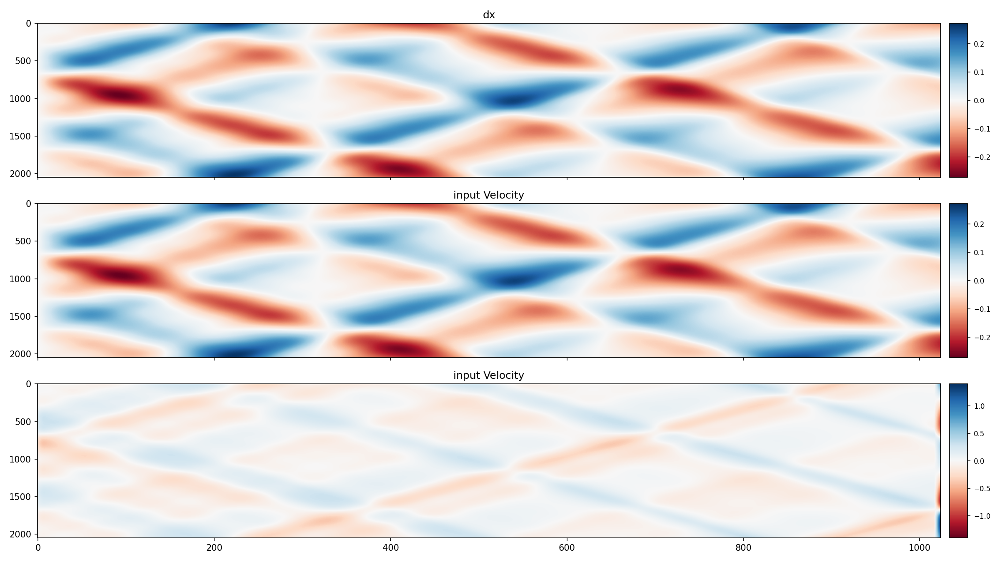

In [12]:
def getStackedUpdates(positions, velocities, accelerations, offset):
    dx = (velocities + accelerations)
    x = dx.mT
    cumsum = torch.cumsum(x, axis = 1)
    s = torch.sum(x, axis = 1, keepdims=True)
    r2lcumsum = x + s - cumsum
    stacked = torch.hstack((r2lcumsum[:,:-offset] - r2lcumsum[:,offset:], r2lcumsum[:,-offset:]))
    return stacked

    
    
    
offset = 8

positions = trainingData[trainingFiles[0]]['positions'][:1024,:]
velocities = trainingData[trainingFiles[0]]['velocity'][:1024,:]
accelerations = trainingData[trainingFiles[0]]['dudt'][:1024,:]
dx = velocities + accelerations

x = dx.mT
cumsum = torch.cumsum(x, axis = 1)
s = torch.sum(x, axis = 1, keepdims=True)
r2lcumsum = x + s - cumsum
stacked = torch.hstack((r2lcumsum[:,:-offset] - r2lcumsum[:,offset:], r2lcumsum[:,-offset:]))

stacked = getStackedUpdates(positions, velocities, accelerations, offset)

fig, axis = plt.subplots(3, 1, figsize=(16,9), sharex = True, sharey = False, squeeze = False)
def imPlot(fig, axis, mat, title):
    im = axis.imshow(mat, cmap = 'RdBu', norm = colors.Normalize(vmin = -np.max(np.abs(mat)), vmax = np.max(np.abs(mat))))
    axis.axis('auto')
    ax1_divider = make_axes_locatable(axis)
    cax1 = ax1_divider.append_axes("right", size="2%", pad="1%")
    cb1 = fig.colorbar(im, cax=cax1,orientation='vertical')
    cb1.ax.tick_params(labelsize=8) 
    axis.set_title(title)
imPlot(fig,axis[0,0], dx.mT.detach().cpu().numpy(), 'dx')
# imPlot(fig,axis[1,0], cumsum.detach().cpu().numpy(), 'cumsum')
# imPlot(fig,axis[2,0], (cumsum[:,1:] - cumsum[:,:-1]).detach().cpu().numpy(), 'cumsum diff')
# imPlot(fig,axis[1,0], r2lcumsum.detach().cpu().numpy(), 'r2l cumsum')
# imPlot(fig,axis[2,0], stacked.detach().cpu().numpy(), 'stacked')


avgVelocity = torch.ones_like(stacked) * 0
avgVelocity[:,offset:] = stacked[:,:-offset]
for i in range(1,offset):
    s = torch.vstack([dx[t,:] for t in range(i)])
    summed = torch.sum(s, dim = 0)
    avgVelocity[:,i] = summed
    
# avgVelocity[:,:offset] = 0
# avgVelocity[:,-offset:] = 0
# stacked[:,:offset] = 0
# stacked[:,-offset:] = 0

# imPlot(fig,axis[1,0], avgVelocity.detach().cpu().numpy(), 'input Velocity')
imPlot(fig,axis[1,0], velocities.mT.detach().cpu().numpy(), 'input Velocity')

imPlot(fig,axis[2,0], (stacked - avgVelocity).detach().cpu().numpy(), 'input Velocity')


# axis[2,0].imshow(stacked.detach().cpu().numpy(), cmap = 'RdBu')
# axis[2,0].axis('auto')
# axis[2,0].set_title('stacked')

fig.tight_layout()

In [13]:
offset = 16
def getStackedUpdates(positions, velocities, accelerations, offset):
    dx = (velocities + accelerations)
    x = dx.mT
    cumsum = torch.cumsum(x, axis = 1)
    s = torch.sum(x, axis = 1, keepdims=True)
    r2lcumsum = x + s - cumsum
    stacked = torch.hstack((r2lcumsum[:,:-offset] - r2lcumsum[:,offset:], r2lcumsum[:,-offset:]))
    return stacked.mT


for f in tqdm(trainingFiles):
    trainingData[f]['stacked'] = getStackedUpdates(trainingData[f]['positions'], trainingData[f]['velocity'], trainingData[f]['dudt'], offset - 1)
for f in tqdm(testingFiles):
    testingData[f]['stacked'] = getStackedUpdates(testingData[f]['positions'], testingData[f]['velocity'], testingData[f]['dudt'], offset - 1)
#     trainingData[f]['averagedVelocity'] = torch.zeros

  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

# Task: Learn density (1 timestep)

In [14]:
normalized = False # rbf normalization
batchSize = 4
maxUnrollsteps = 1
# offset = 0

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# device = 'cpu'
dataSet = []
for f in trainingFiles:
    nSteps = settings[f]['timesteps'] - maxUnrollsteps * (offset - 1)
    for j in range(offset - 1, nSteps):
        dataSet.append((f, j))
print('Dataset contains %d samples [%d files @ %d timesteps]' % (len(dataSet), len(trainingFiles), len(dataSet) / len(trainingFiles)))

Dataset contains 64576 samples [32 files @ 2018 timesteps]


In [15]:
# dataSet = [(trainingFiles[0], offset)] * batchSize
# print(dataSet)

In [16]:
# Reading frame t:
t = 0
x = trainingData[f]['positions'][t]
vel = x - trainingData[f]['positions'][max(0, t - (offset - 1))]
gt = trainingData[f]['stacked'][t]
print('vel', trainingData[f]['velocity'][t])
print('dudt', trainingData[f]['dudt'][t])
print('')
print('x', x)
print('gt', gt)
print('vel', vel)


vel tensor([0., 0., 0.,  ..., 0., 0., 0.])
dudt tensor([-0.0003, -0.0003, -0.0003,  ..., -0.0004, -0.0004, -0.0003])

x tensor([-1.0000, -0.9990, -0.9980,  ...,  0.9970,  0.9980,  0.9990])
gt tensor([-0.0298, -0.0282, -0.0263,  ..., -0.0348, -0.0331, -0.0316])
vel tensor([0., 0., 0.,  ..., 0., 0., 0.])


In [17]:
settings[trainingFiles[0]]['dt']

0.001

In [18]:
# Reading frame t:
t = offset - 1
x = trainingData[f]['positions'][t]
print(max(0, t - (offset)))
print(x)
print(trainingData[f]['positions'][max(0, t - (offset - 1))])
vel = (x - trainingData[f]['positions'][max(0, t - (offset -1 ))]) / dt
gt = trainingData[f]['stacked'][t]
print('vel', trainingData[f]['velocity'][t])
print('dudt', trainingData[f]['dudt'][t])
print('')
print('x', x)
print('gt', gt)
print('vel', vel)

0
tensor([-1.0000, -0.9990, -0.9980,  ...,  0.9970,  0.9980,  0.9990])
tensor([-1.0000, -0.9990, -0.9980,  ...,  0.9970,  0.9980,  0.9990])
vel tensor([-0.0029, -0.0028, -0.0025,  ..., -0.0035, -0.0033, -0.0031])
dudt tensor([ 9.1478e-06,  3.9115e-05,  1.2014e-05,  ..., -3.5965e-05,
        -1.2142e-05,  6.4528e-06])

x tensor([-1.0000, -0.9990, -0.9980,  ...,  0.9970,  0.9980,  0.9990])
gt tensor([-0.0357, -0.0329, -0.0291,  ..., -0.0461, -0.0426, -0.0396])
vel tensor([-0.0299, -0.0281, -0.0264,  ..., -0.0347, -0.0332, -0.0316])


In [19]:
# Reading frame t:
t = offset  + offset - 2
x = trainingData[f]['positions'][t]
print(max(0, t - (offset)))
print(x)
print(trainingData[f]['positions'][max(0, t - (offset - 1))])
vel = (x - trainingData[f]['positions'][max(0, t - (offset -1 ))]) / dt
gt = trainingData[f]['stacked'][t]
print('vel', trainingData[f]['velocity'][t])
print('dudt', trainingData[f]['dudt'][t])
print('')
print('x', x)
print('gt', gt)
print('vel', vel)

14
tensor([-1.0001, -0.9991, -0.9980,  ...,  0.9969,  0.9979,  0.9989])
tensor([-1.0000, -0.9990, -0.9980,  ...,  0.9970,  0.9980,  0.9990])
vel tensor([-0.0019, -0.0017, -0.0014,  ..., -0.0026, -0.0023, -0.0022])
dudt tensor([ 9.8341e-07,  1.6052e-05, -4.0979e-05,  ..., -4.5118e-06,
         2.3169e-05,  2.8031e-05])

x tensor([-1.0001, -0.9991, -0.9980,  ...,  0.9969,  0.9979,  0.9989])
gt tensor([-0.0562, -0.0528, -0.0513,  ..., -0.0642, -0.0615, -0.0584])
vel tensor([-0.0358, -0.0330, -0.0292,  ..., -0.0460, -0.0426, -0.0395])


In [20]:
torch.manual_seed('1337')

dataLoader = DataLoader(dataSet, shuffle=True, batch_size = batchSize).batch_sampler
dataIter = iter(dataLoader)

In [21]:
from util import *

In [198]:
def getGroundTruth(positions, velocities, areas, densities, dudts, inVel, outVel, i, j, distance, direction):
#     print(dudts, dt)
#     gt = [v + td for v,d in zip(velocities, dudts)] # Learning Density
#     gt = dudts
    term = scatter_sum(torch.hstack(areas)[j] * kernelGradient(torch.abs(distance), direction, particleSupport), i, dim = 0, dim_size = torch.hstack(areas).shape[0])
#     term = scatter_sum(torch.hstack(areas)[j] * kernel(torch.abs(distance), particleSupport), i, dim = 0, dim_size = torch.hstack(areas).shape[0])
    return term

    gt = outVel
#     gt = densities
    groundTruth = torch.hstack(gt)
    return groundTruth
def getFeatures(positions, velocities, areas, densities, dudts, inVel, outVel):
    features = torch.ones_like(areas )[:,None]
#     features = areas[:,None]
#     features = torch.vstack((inVel, densities,torch.ones_like(areas))).mT
    return features
#     features = torch.ones_like(areas)
#     return features[:,None]
def lossFunction(prediction, groundTruth):
    return (prediction - groundTruth)**2 # MSE

In [199]:
# Hyperparameters for the NN
lr = 1e-2 # Learning rate
iterations = 1000 # update iterations per epoch
epochs = 5 # total number of epochs, LR is halved every epoch
n = 17 # number of weights per continuous convolution
basis = 'fourier' # basis for the convolution, set to linear for CConv

window = 'cubicSpline'
windowNorm = 'integral'
window = None

In [200]:
layers = [1]
initialLR = 1e-2
particleData = trainingData
groundTruthFn = getGroundTruth
featureFn = getFeatures
lossFn = lossFunction

In [201]:
print(particleSupport)
print(dt)

0.0078125
0.001


In [202]:
def loadTestcase(testingData, settings, f, frames, device, groundTruthFn, featureFn, offset):
    positions, velocities, areas, dudts, density, inputVelocity, outputVelocity, setup = getTestcase(testingData, settings, f, frames, device, offset)

    i, j, distance, direction = batchedNeighborsearch(positions, setup)
    x, u, v, rho, dudt, inVel, outVel = flatten(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity)

    x = x[:,None].to(device)    
    groundTruth = groundTruthFn(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity, i, j, distance, direction).to(device)
    distance = (distance * direction)[:,None].to(device)
    features = featureFn(x, u, v, rho, dudt, inVel, outVel).to(device)
#     print(groundTruth)
    return positions, velocities, areas, density, dudts, features, i, j, distance, groundTruth, x, u


In [203]:
testData = {}
for i in range(len(testingFiles)):
#     testData[testingFiles[i].split('/')[-1].split('.')[0]] = loadTestcase(testingData, settings, testingFiles[i], [0, 128, 256, 1024], device, getGroundTruth, getFeatures, offset)
    testData['_'.join(testingFiles[i].split('/')[-1].split('.')[0].split('_')[1:3])] = loadTestcase(testingData, settings, testingFiles[i], [offset, 128, 256, 1024], device, getGroundTruth, getFeatures, offset)
# testData = {}
# for i in range(len(testingFiles)):
#     testData[testingFiles[i].split('/')[-1].split('.')[0]] = loadTestcase(testingData, settings, testingFiles[i], [0], device, getGroundTruth, getFeatures)

In [204]:
# print('_'.join(list(testData.keys())[0].split('_')[1:3]))
# testData.keys()

In [205]:
            try:
                bdata = next(dataIter)
                if len(bdata) < batchSize :
                    raise Exception('batch too short')
            except:
                dataIter = iter(dataLoader)
                bdata = next(dataIter)

In [206]:
def plotBatch(trainingData, settings, dataSet, bdata, device, offset, model = None):
    positions, velocities, areas, dudts, density, inputVelocity, outputVelocity, setup = loadBatch(trainingData, settings, dataSet, bdata, device, offset)
    i, j, distance, direction = batchedNeighborsearch(positions, setup)
    x, u, v, rho, dudt, inVel, outVel = flatten(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity)

    x = x[:,None].to(device)    
    groundTruth = groundTruthFn(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity, i, j, distance, direction).to(device)
    distance = (distance * direction)[:,None].to(device)
    features = featureFn(x, u, v, rho, dudt, inVel, outVel).to(device)

#     optimizer.zero_grad()
#     prediction = model(features.to(device), i.to(device), j.to(device), distance.to(device))[:,0]
#     lossTerm = lossFn(prediction, groundTruth)
#     loss = torch.mean(lossTerm)
    
    fig, axis = plt.subplot_mosaic('''AF
    BC
    DE''', figsize=(12,8), sharey = False, sharex = False)
    
    positions = torch.vstack(positions).mT.detach().cpu().numpy()
    vel = u.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    area = v.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    dudt = dudt.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    density = rho.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    inVel = inVel.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    outVel = outVel.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    gt = groundTruth.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    ft = features[:,0].reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    
    axis['A'].set_title('Position')
    axis['A'].plot(positions)
    axis['B'].set_title('Density')
    axis['B'].plot(positions, density)
    axis['C'].set_title('Difference')
    axis['C'].plot(positions, gt - ft)
    axis['D'].set_title('Instantenous Velocity')
    axis['D'].plot(positions, vel)
    axis['E'].set_title('Ground Truth')
    axis['E'].plot(positions, gt)
    axis['F'].set_title('Features[:,0]')
    axis['F'].plot(positions, ft)
    
    fig.tight_layout()
    
def plotTrainedBatch(trainingData, settings, dataSet, bdata, device, offset, modelState, groundTruthFn, featureFn, lossFn):
    positions, velocities, areas, dudts, density, inputVelocity, outputVelocity, setup = loadBatch(trainingData, settings, dataSet, bdata, device, offset)
    i, j, distance, direction = batchedNeighborsearch(positions, setup)
    x, u, v, rho, dudt, inVel, outVel = flatten(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity)

    x = x[:,None].to(device)    
    groundTruth = groundTruthFn(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity, i, j, distance, direction).to(device)
    distance = (distance * direction)[:,None].to(device)
    features = featureFn(x, u, v, rho, dudt, inVel, outVel).to(device)
    
    with torch.no_grad():
        prediction = modelState['model'](features.to(device), i.to(device), j.to(device), distance.to(device))[:,0]
        lossTerm = lossFn(prediction, groundTruth)
        loss = torch.mean(lossTerm)
    
    fig, axis = plt.subplot_mosaic('''ABC
    DEF''', figsize=(16,5), sharey = False, sharex = True)
    
    positions = torch.vstack(positions).mT.detach().cpu().numpy()
    vel = u.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    area = v.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    dudt = dudt.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    density = rho.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    inVel = inVel.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    outVel = outVel.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    gt = groundTruth.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    ft = features[:,0].reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    loss = lossTerm.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    pred = prediction.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    
    axis['A'].set_title('Density')
    axis['A'].plot(positions, density)
    axis['E'].set_title('Ground Truth - Features[:,0]')
    axis['E'].plot(positions, gt - ft)
    axis['B'].set_title('Ground Truth')
    axis['B'].plot(positions, gt)
    axis['D'].set_title('Features[:,0]')
    axis['D'].plot(positions, ft)
    axis['C'].set_title('Prediction')
    axis['C'].plot(positions, pred)
    axis['F'].set_title('Loss')
    axis['F'].plot(positions, loss)
    
    fig.tight_layout()
    
# plotBatch(trainingData, settings, dataSet, bdata, device, offset)

In [207]:
def buildMLP(layers, inputFeatures = 1):
    modules = []
    if len(layers) > 1:
        for i in range(len(layers) - 1):
            modules.append(nn.Linear(inputFeatures if i == 0 else layers[i-1],layers[i]))
            torch.nn.init.uniform_(modules[-1].weight,-0.05, 0.05)
    #         torch.nn.init.zeros_(modules[-1].weight)
            torch.nn.init.zeros_(modules[-1].bias)
            modules.append(nn.BatchNorm1d(layers[i]))
            modules.append(nn.ReLU())
        modules.append(nn.Linear(layers[-2],layers[-1]))
    else:
        modules.append(nn.Linear(inputFeatures,layers[-1]))        
    torch.nn.init.uniform_(modules[-1].weight,-0.05, 0.05)
    torch.nn.init.zeros_(modules[-1].bias)
    return nn.Sequential(*modules)

In [208]:
# vertices:
#     'MP-PDE': mlp(curr vtx features + messages)
#     'MessagePassing': messages
#     'PointNet': mlp(curr vtx features)
# edges:
#     'PointNet' do nothing
#     'CConv': do dpcconv 
#     'MP-PDE': mlp(curr vtx features + edge features)
# #     'dpc': mlp(x_ij) * f_in
#     'mpde': mlp(x_ij, f_in, u_ij)
#     'mlp': mlp(e_ij) * f_in  and mlp on edges
#     'mlpde': mlp(e_ij, f_in, u_ij) and mlp on edges

In [209]:
positions, velocities, areas, dudts, density, inputVelocity, outputVelocity, setup = loadBatch(trainingData, settings, dataSet, bdata, device, offset)
i, j, distance, direction = batchedNeighborsearch(positions, setup)
x, u, v, rho, dudt, inVel, outVel = flatten(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity)

x = x[:,None].to(device)    
groundTruth = groundTruthFn(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity, i, j, distance, direction).to(device)
distance = (distance * direction)[:,None].to(device)
features = featureFn(x, u, v, rho, dudt, inVel, outVel).to(device)
inputFeatures = features.shape[1]

In [210]:
# random.randint(0,2**30)

In [211]:
      
class mlpNetwork(nn.Module):
    def __init__(self,
                 feedThroughVertexFeatures = 0,
                 feedThroughEdgeFeatures = 0,
                 vertexHiddenLayout = [8,8,8], 
                 edgeHiddenLayout = [8,8,8],
                 vertexFeatures = [8,8,4,1],
                 messageFeatures = None,
                 edgeFeatures = None,
                 vertexMode = 'MessagePassing',
                 edgeMode = 'CConv',
                 edgeMLP = False,
                 inputEncode = False,
                 outputEncode = False,
                 inputEdgeEncode = False,
                 seed = None,
                 verbose = False):
        super(mlpNetwork, self).__init__()        
        if seed is not None:
            self.seed = seed
        else:
            self.seed = random.randint(0,2**30)
        torch.manual_seed(self.seed)
        torch.cuda.manual_seed(self.seed)
        np.random.seed(self.seed)
#         self.layout = layers
        self.inputVertexFeatures = vertexFeatures[0]
        self.outputVertexFeatures = vertexFeatures[-1]
        self.inputEdgeFeatures = edgeFeatures[0] if edgeFeatures is not None else 1
        self.edgeMLP = edgeMLP
#         self.outputEdgeFeatures = vertexFeatures[-1]
        self.vertexMode = vertexMode
        self.edgeMode = edgeMode
        self.vertexHiddenLayout = vertexHiddenLayout
        self.edgeHiddenLayout = edgeHiddenLayout
        self.inputEncode = inputEncode
        self.outputEncode = outputEncode
        self.inputEdgeEncode = inputEdgeEncode
        self.feedThroughVertexFeatures = feedThroughVertexFeatures
        self.feedThroughEdgeFeatures = feedThroughEdgeFeatures
        
        self.vertexFeatures = vertexFeatures
#         self.vertexFeatures = [e + feedThroughVertexFeatures for e in self.vertexFeatures]
        self.edgeFeatures = [1] + [1] * (len(vertexFeatures)) if edgeFeatures is None else edgeFeatures
        self.messageFeatures = self.edgeFeatures[1:] if messageFeatures is None else messageFeatures
#         self.edgeFeatures = [e + feedThroughEdgeFeatures for e in self.edgeFeatures]
        self.verbose = verbose
    
        if verbose:
            print('Building MLP MessagePassing network with %2d input features and %2d output features' % (vertexFeatures[0], vertexFeatures[-1]))
            print(f"Vertex Mode: {vertexMode} with vertex Features: [{' '.join([str(v) for v in vertexFeatures])}]")
            print(f"Processed Vertex Layout [{' '.join([str(v) for v in self.vertexFeatures])}]")
            print(f"Edge   Mode: {edgeMode} with edge Features  : [{' '.join([str(e) for e in edgeFeatures]) if edgeFeatures is not None else 'N/A'}]")
            print(f"Processed edge   Layout [{' '.join([str(v) for v in self.edgeFeatures])}]")
            print(f"Input Encoder: {'true' if inputEncode else 'false'}")
            print(f"Output Encoder: {'true' if outputEncode else 'false'}")
            print(f"Input Edge Encoder: {'true' if inputEdgeEncode else 'false'}")           
            print(f"Feed through features for vertices {feedThroughVertexFeatures} and edges {feedThroughEdgeFeatures}")
        
        
        if self.inputEncode:
            encoderLayout = vertexHiddenLayout + [self.vertexFeatures[1]]
            if verbose:
                print(f"Building inputEncoder from {self.vertexFeatures[0]} to {self.vertexFeatures[1]} with hidden layout {[{' '.join([str(v) for v in vertexHiddenLayout])}]}")
            self.vertexFeatures = self.vertexFeatures[1:]
            if verbose:
                print(f"New Vertex Layout: [{' '.join([str(v) for v in self.vertexFeatures])}]")
            self.inputEncoder = buildMLP(encoderLayout, inputFeatures = self.vertexFeatures[0] + feedThroughVertexFeatures)
            
        if self.outputEncode:
            encoderLayout = vertexHiddenLayout + [self.vertexFeatures[-1]]
            if verbose:
                print(f"Building outputEncoder from {self.vertexFeatures[-2] + feedThroughVertexFeatures} to {self.vertexFeatures[-1]} with hidden layout {[{' '.join([str(v) for v in vertexHiddenLayout])}]}")
            self.vertexFeatures = self.vertexFeatures[:-1]
            if verbose:
                print(f"New Vertex Layout: [{' '.join([str(v) for v in self.vertexFeatures])}]")
            self.outputEncoder = buildMLP(encoderLayout, inputFeatures = self.vertexFeatures[-1] + feedThroughVertexFeatures)
        
        if self.inputEdgeEncode:
            if vertexMode == 'PointNet':
                raise Exception(f"Vertex Mode 'PointNet' does not support edge features, please disable inputEdgeEncode")
            encoderLayout = edgeHiddenLayout + [self.edgeFeatures[1]]
            if verbose:
                print(f"Building inputEdgeEncoder from {1 + feedThroughEdgeFeatures} to {self.edgeFeatures[0]} with hidden layout {[{' '.join([str(v) for v in edgeHiddenLayout])}]}")
            self.edgeFeatures = self.edgeFeatures[1:]
            if verbose:
                print(f"New Edge Layout: [{' '.join([str(v) for v in self.edgeFeatures])}]")
            self.inputEdgeEncoder = buildMLP(encoderLayout, inputFeatures = 1 + feedThroughEdgeFeatures)
            
        self.messageFeatures = self.vertexFeatures[1:] if messageFeatures is None else messageFeatures
        
        if verbose:
            print(f"Final vertex Layout: [{' '.join([str(v) for v in self.vertexFeatures])}]")
            print(f"Final edge   Layout: [{' '.join([str(v) for v in self.edgeFeatures])}]")
            
            print('Starting construction of Message Passing Steps: ')
            for i in range(len(self.vertexFeatures)-1):
                if i != len(self.vertexFeatures) - 2:
                    print(f'\tLayer {i}: vertex Features: {self.vertexFeatures[i]} -> {self.vertexFeatures[i+1]}, edge Features: {self.edgeFeatures[i]} -> {self.edgeFeatures[i+1]}')
                else:                    
                    print(f'\tLayer {i}: vertex Features: {self.vertexFeatures[i]} -> {self.vertexFeatures[i+1]}')
        
        self.vertexModules = nn.ModuleList([])
        self.edgeModules = nn.ModuleList([])
        self.edgeMLPModules = nn.ModuleList([])
        if edgeMLP:            
            for i in range(len(self.edgeFeatures) - 1):
                layerInput = self.edgeFeatures[i] + feedThroughEdgeFeatures
                layerOutput = self.edgeFeatures[i+1]
                mlp = buildMLP(layers  = edgeHiddenLayout + [layerOutput], inputFeatures = layerInput)
                if verbose:
                    print('Processing Layer %2d' % i)
                    print(f"\tEdge Input: {layerInput}, edge Output: {layerOutput}")
#                     print(f"\tEdge Features: {self.edgeFeatures[i]}")
                self.edgeMLPModules.append(mlp)
        
        if vertexMode == 'PointNet':
            pass
        elif edgeMode == 'CConv':
            for i in range(len(self.vertexFeatures) - 1):
                if verbose:
                    print('Processing Layer %2d' % i)
                    print(f"\tVertex Input: {self.vertexFeatures[i]}, vertex Output: {self.vertexFeatures[i+1]}")
                    print(f"\tEdge Features: {self.edgeFeatures[i]}")
                layerInput = self.vertexFeatures[i] + feedThroughVertexFeatures
                layerOutput = self.messageFeatures[i] if self.vertexMode == 'MP-PDE' else self.vertexFeatures[i+1] #self.vertexFeatures[i+1] if messageFeatures is None else self.messageFeatures[i]
                mlp = buildMLP(layers  = edgeHiddenLayout + [layerInput * layerOutput], inputFeatures = self.edgeFeatures[i] + feedThroughEdgeFeatures)
                self.edgeModules.append(mlp)
        elif edgeMode == 'MP-PDE':
            for i in range(len(self.vertexFeatures) - 1):
                layerInput = self.vertexFeatures[i]*2 + feedThroughVertexFeatures + self.edgeFeatures[i] + feedThroughEdgeFeatures
                layerOutput =  self.vertexFeatures[i+1] if self.vertexMode == 'MessagePassing' else self.messageFeatures[i]
                if verbose:
                    print('Processing Layer %2d' % i)
                    print(f"\tLayer Input: {layerInput}, layer Output: {layerOutput}")
#                     print(f"\tEdge Features: {self.edgeFeatures[i]}")
                mlp = buildMLP(layers  = edgeHiddenLayout + [layerOutput], inputFeatures = layerInput)
                self.edgeModules.append(mlp)        
            pass
        else:
            raise Exception(f'Edge Mode {edgeMode} is not supported')
            
        if vertexMode == 'MessagePassing':
            pass
        elif vertexMode == 'PointNet':    
            for i in range(len(self.vertexFeatures) - 1):
                layerInput = self.vertexFeatures[i] + feedThroughVertexFeatures
                layerOutput = self.vertexFeatures[i+1]
                mlp = buildMLP(layers  = vertexHiddenLayout + [layerOutput], inputFeatures = layerInput)
                if verbose:
                    print('Processing Layer %2d' % i)
                    print(f"\tVertex Input: {layerInput}, vertex Output: {layerOutput}")
#                     print(f"\tEdge Features: {self.edgeFeatures[i]}")
                self.vertexModules.append(mlp)
        elif vertexMode == 'MP-PDE':
            for i in range(len(self.vertexFeatures) - 1):
                layerInput = self.vertexFeatures[i] + feedThroughVertexFeatures + (self.vertexFeatures[i] if messageFeatures is None else self.messageFeatures[i])
                layerOutput = self.vertexFeatures[i+1]
                mlp = buildMLP(layers  = vertexHiddenLayout + [layerOutput], inputFeatures = layerInput)
                if verbose:
                    print('Processing Layer %2d' % i)
                    print(f"\tVertex Input: {layerInput} ({self.vertexFeatures[i]} + {feedThroughVertexFeatures} + {(self.vertexFeatures[i] if messageFeatures is None else self.messageFeatures[i])}), vertex Output: {layerOutput}")
                self.vertexModules.append(mlp)            
        else :
            raise Exception(f'Vertex Mode {vertexMode} is not supported')
    def verbosePrint(self, s):
        if self.verbose:
            print(s)
        
    
    def forward(self, i, j, inputVertexFeatures, inputEdgeFeatures, feedThroughVertexFeatures = None, feedThroughEdgeFeatures = None ): 
        if self.inputVertexFeatures != inputVertexFeatures.shape[1]:
            raise Exception(f'Input shape {inputVertexFeatures.shape} does not match expected input feature size {self.inputFeatures}') 
        if self.inputEdgeFeatures != inputEdgeFeatures.shape[1]:
            raise Exception(f'Input shape {inputEdgeFeatures.shape} does not match expected input feature size {self.inputFeatures}')
        if self.feedThroughVertexFeatures != 0 and feedThroughVertexFeatures == None:
            raise Exception(f'Expected {self.feedThroughVertexFeatures} feed through vertex features but got None')
        if self.feedThroughEdgeFeatures != 0 and feedThroughEdgeFeatures == None:
            raise Exception(f'Expected {self.feedThroughEdgeFeatures} feed through edge features but got None')
        if self.feedThroughVertexFeatures != 0 and feedThroughVertexFeatures.shape[1] != self.feedThroughVertexFeatures:
            raise Exception(f'Expected {self.feedThroughVertexFeatures} feed through vertex features but got input of shape {feedThroughVertexFeatures.shape}')
        if self.feedThroughEdgeFeatures != 0 and feedThroughEdgeFeatures.shape[1] != self.feedThroughEdgeFeatures:
            raise Exception(f'Expected {self.feedThroughEdgeFeatures} feed through edge features but got input of shape {feedThroughVertexFeatures.shape}')
        if self.feedThroughVertexFeatures == 0 and feedThroughVertexFeatures != None:
            raise Exception(f'Expected {self.feedThroughVertexFeatures} feed through vertex features but got input of shape {feedThroughVertexFeatures.shape}')
        if self.feedThroughEdgeFeatures == 0 and feedThroughEdgeFeatures != None:
            raise Exception(f'Expected {self.feedThroughEdgeFeatures} feed through edge features but got input of shape {feedThroughEdgeFeatures.shape}')
            
        
        self.verbosePrint('Running forward pass through NN:')
        self.verbosePrint(f"\tInput Vertex Features shape: {inputVertexFeatures.shape}")
        self.verbosePrint(f"\tInput Edge   Features shape: {inputEdgeFeatures.shape}")
        self.verbosePrint(f"\tNeighborhood shape: {i.shape} and {j.shape}")
        self.verbosePrint(f"\tFeed through vertex feature shape: {'N/A' if feedThroughVertexFeatures is None else feedThroughVertexFeatures.shape}")
        self.verbosePrint(f"\tFeed through edge   feature shape: {'N/A' if feedThroughEdgeFeatures is None else feedThroughEdgeFeatures.shape}")
            
        edgeFeatures = torch.clone(inputEdgeFeatures)
        vertexFeatures = torch.clone(inputVertexFeatures)
        
        if self.inputEncode:
            self.verbosePrint(f'Running input vertex encoder ({inputVertexFeatures.shape[1]} -> {self.vertexFeatures[0]})')
            vertexFeatures = self.inputEncoder(torch.hstack((vertexFeatures, feedThroughVertexFeatures)) if feedThroughVertexFeatures is not None else vertexFeatures)
        if self.inputEdgeEncode:
            self.verbosePrint(f'Running input edge   encoder ({edgeFeatures.shape[1]} -> {self.edgeFeatures[0]})')
            edgeFeatures = self.inputEdgeEncoder(torch.hstack((edgeFeatures, feedThroughEdgeFeatures)) if feedThroughEdgeFeatures is not None else edgeFeatures)
        
        if self.edgeMode == 'CConv':
            for l, layer in enumerate(self.edgeModules):
                self.verbosePrint('Processing Layer %2d' % l)
                self.verbosePrint(f"\tVertex Input: {self.vertexFeatures[l]}, vertex Output: {self.vertexFeatures[l+1]}")
                self.verbosePrint(f"\tEdge Features: {self.edgeFeatures[l]}")
                if feedThroughEdgeFeatures is not None:
                    filterOutput = layer(torch.hstack((edgeFeatures,feedThroughEdgeFeatures))).reshape(i.shape[0], self.vertexFeatures[l] + self.feedThroughVertexFeatures, self.messageFeatures[l] if self.vertexMode == 'MP-PDE' else self.vertexFeatures[l+1])
                else:
                    filterOutput = layer(edgeFeatures).reshape(i.shape[0], self.vertexFeatures[l] + self.feedThroughVertexFeatures, self.messageFeatures[l] if self.vertexMode == 'MP-PDE' else self.vertexFeatures[l+1])
                if feedThroughVertexFeatures is not None:
                    vertexFeatures = torch.hstack((vertexFeatures, feedThroughVertexFeatures))
                    
                self.verbosePrint(f"\tProcessed edge mlp, input shape {edgeFeatures.shape} -> output shape {filterOutput.shape}")
                self.verbosePrint(f"\tVertex Feature Shape {vertexFeatures.shape}")
                message = torch.sum(filterOutput * vertexFeatures[j].unsqueeze(2), dim = 1)
                self.verbosePrint(f"\tMessage shape: {message.shape}")
                aggrMessage = scatter_sum(message, i, dim = 0, dim_size = vertexFeatures.shape[0])
                self.verbosePrint(f"\tAggregated message shape: {aggrMessage.shape}")

                if self.vertexMode == 'MessagePassing':
#                     if feedThroughVertexFeatures is None:
                    vertexFeatures = aggrMessage
#                     elif feedThroughVertexFeatures is not None and self.outputEncode:
#                         vertexFeatures = torch.hstack((aggrMessage, feedThroughVertexFeatures))
#                     elif feedThroughVertexFeatures is not None and not self.outputEncode and l == len(self.edgeModules) - 1:
#                         vertexFeatures = aggrMessage
                    if feedThroughVertexFeatures is not None and self.outputEncode and l == len(self.edgeModules)-1:
                        vertexFeatures = torch.hstack((vertexFeatures, feedThroughVertexFeatures))
                elif self.vertexMode == 'MP-PDE':
#                     if feedThroughVertexFeatures is None:
#                     if l == 0:
#                     if feedThroughVertexFeatures is not None:
#                         vertexFeatures = torch.hstack((vertexFeatures, feedThroughVertexFeatures))
#                     print('vertexFeatures:', vertexFeatures.shape)
#                     print('feedThroughVertexFeatures:', feedThroughVertexFeatures.shape)
#                     print('aggrMessage:', aggrMessage.shape)
            
                    vertexFeatures = self.vertexModules[l](torch.hstack((vertexFeatures, aggrMessage)))
#                     elif feedThroughVertexFeatures is not None:
#                         vertexFeatures = self.vertexModules[l](torch.hstack((vertexFeatures, aggrMessage, feedThroughVertexFeatures)))
#                     if self.outputEncode and l == len(self.vertexModules) - 1 and feedThroughVertexFeatures is not None:
#                         vertexFeatures = torch.hstack((vertexFeatures, feedThroughVertexFeatures))
                    if feedThroughVertexFeatures is not None and self.outputEncode and l == len(self.edgeModules)-1:
                        vertexFeatures = torch.hstack((vertexFeatures, feedThroughVertexFeatures))
#                         vertexFeatures = torch.hstack((vertexFeatures, feedThroughVertexFeatures))
#                     elif feedThroughVertexFeatures is not None and not self.outputEncode and l == len(self.edgeModules) - 1:
#                         vertexFeatures = self.vertexModules[l](torch.hstack((vertexFeatures, aggrMessage)))
                else:
                    raise Exception(f'Vertex Mode {self.vertexMode} x Edge mode {self.edgeMode} combination is not supported')     
                if self.edgeMLP and l != len(self.edgeModules)-1:
#                     print(l, len(self.vertexModules), len(self.edgeMLPModules))
                    self.verbosePrint(f"\tRunning edge MLP {edgeFeatures.shape[1] + feedThroughEdgeFeatures.shape[1] if feedThroughEdgeFeatures is not None else edgeFeatures.shape[1]} -> {self.edgeFeatures[l+1]}")
                    edgeFeatures = self.edgeMLPModules[l](torch.hstack((edgeFeatures, feedThroughEdgeFeatures)) if feedThroughEdgeFeatures is not None else edgeFeatures)
                    
                self.verbosePrint(f"\tNew Vertex feature shape: {vertexFeatures.shape}")     
        elif self.edgeMode == 'MP-PDE':
            for l, layer in enumerate(self.edgeModules):
                self.verbosePrint('Processing Layer %2d' % l)
                self.verbosePrint(f"\tVertex Input: {self.vertexFeatures[l]}, vertex Output: {self.vertexFeatures[l+1]}")
                self.verbosePrint(f"\tEdge Features: {self.edgeFeatures[l]}")
                if feedThroughEdgeFeatures is not None:
                    self.verbosePrint(f"\tGathered Edge Features: {edgeFeatures.shape[1]} + {feedThroughEdgeFeatures.shape[1]} via feed through")
                    eFeatures = torch.hstack((edgeFeatures,feedThroughEdgeFeatures))
                else:
                    self.verbosePrint(f"\tGathered Edge Features: {edgeFeatures.shape[1]}")
                    eFeatures = edgeFeatures
                if feedThroughVertexFeatures is not None:
                    self.verbosePrint(f"\tGathered Vertex Features: {vertexFeatures.shape[1]} + {feedThroughVertexFeatures.shape[1]} via feed through")
                    vFeatures = torch.hstack((vertexFeatures[i], vertexFeatures[j],feedThroughVertexFeatures[j]))
                else:
                    self.verbosePrint(f"\tGathered Vertex Features: {vertexFeatures.shape[1]}")
                    vFeatures = torch.hstack((vertexFeatures[i], vertexFeatures[j]))
#                 print(vFeatures.shape, eFeatures.shape)
                features = torch.hstack((eFeatures, vFeatures))         
                self.verbosePrint(f"\tProcessed edge mlp, input shape {features.shape}")           
                message = layer(features)
#                 message = torch.sum(filterOutput * vertexFeatures[j].unsqueeze(2), dim = 1)
                self.verbosePrint(f"\tMessage shape: {message.shape}")
                aggrMessage = scatter_sum(message, i, dim = 0, dim_size = vertexFeatures.shape[0])
                self.verbosePrint(f"\tAggregated message shape: {aggrMessage.shape}")

                if self.vertexMode == 'MessagePassing':
#                     if feedThroughVertexFeatures is None:
                    vertexFeatures = aggrMessage
#                     elif feedThroughVertexFeatures is not None and self.outputEncode:
#                         vertexFeatures = torch.hstack((aggrMessage, feedThroughVertexFeatures))
#                     elif feedThroughVertexFeatures is not None and not self.outputEncode and l == len(self.edgeModules) - 1:
#                         vertexFeatures = aggrMessage
                    if feedThroughVertexFeatures is not None and self.outputEncode and l == len(self.edgeModules)-1:
                        vertexFeatures = torch.hstack((vertexFeatures, feedThroughVertexFeatures))
#                     print(vertexFeatures.shape)
                elif self.vertexMode == 'MP-PDE':
            
#                     if feedThroughVertexFeatures is None:
#                     if l == 0:
                    if feedThroughVertexFeatures is not None:
                        vertexFeatures = torch.hstack((vertexFeatures, feedThroughVertexFeatures))
                    vertexFeatures = self.vertexModules[l](torch.hstack((vertexFeatures, aggrMessage)))
#                     elif feedThroughVertexFeatures is not None:
#                         vertexFeatures = self.vertexModules[l](torch.hstack((vertexFeatures, aggrMessage, feedThroughVertexFeatures)))
#                     if self.outputEncode and l == len(self.vertexModules) - 1 and feedThroughVertexFeatures is not None:
#                         vertexFeatures = torch.hstack((vertexFeatures, feedThroughVertexFeatures))
                    if (feedThroughVertexFeatures is not None and self.outputEncode and l == len(self.vertexModules)-1):
                        vertexFeatures = torch.hstack((vertexFeatures, feedThroughVertexFeatures))
#                         vertexFeatures = torch.hstack((vertexFeatures, feedThroughVertexFeatures))
#                     elif feedThroughVertexFeatures is not None and not self.outputEncode and l == len(self.edgeModules) - 1:
#                         vertexFeatures = self.vertexModules[l](torch.hstack((vertexFeatures, aggrMessage)))
                else:
                    raise Exception(f'Vertex Mode {self.vertexMode} x Edge mode {self.edgeMode} combination is not supported')     
                if self.edgeMLP and l != len(self.vertexModules)-1:
                    self.verbosePrint(f"\tRunning edge MLP {edgeFeatures.shape[1] + feedThroughEdgeFeatures.shape[1] if feedThroughEdgeFeatures is not None else edgeFeatures.shape[1]} -> {self.edgeFeatures[l+1]}")
                    edgeFeatures = self.edgeMLPModules[l](torch.hstack((edgeFeatures, feedThroughEdgeFeatures)) if feedThroughEdgeFeatures is not None else edgeFeatures)
                self.verbosePrint(f"\tNew Vertex feature shape: {vertexFeatures.shape}")      
        elif self.edgeMode == 'PointNet':
            for l, layer in enumerate(self.vertexModules):
                self.verbosePrint('Processing Layer %2d' % l)
                self.verbosePrint(f"\tVertex Input: {self.vertexFeatures[l]}, vertex Output: {self.vertexFeatures[l+1]}")
                if feedThroughVertexFeatures is None:
                    vertexFeatures = self.vertexModules[l](vertexFeatures)
                elif feedThroughVertexFeatures is not None:
                    vertexFeatures = self.vertexModules[l](torch.hstack((vertexFeatures, feedThroughVertexFeatures)))
                if self.outputEncode and l == len(self.vertexModules) - 1:
                    vertexFeatures = torch.hstack((vertexFeatures, feedThroughVertexFeatures))
        else:
            raise Exception(f'Vertex Mode {self.vertexMode} x Edge mode {self.edgeMode} combination is not supported')
            
        if self.outputEncode:
            self.verbosePrint(f'Running output vertex decoder ({self.vertexFeatures[-1] + self.feedThroughVertexFeatures} -> {self.outputVertexFeatures})')
            vertexFeatures = self.outputEncoder(vertexFeatures)
        return vertexFeatures / particleSupport
    
    def printProcess(self): 
        self.verbosePrint('Running forward pass through NN:')
        self.verbosePrint(f"Input Vertex Features shape: {self.inputVertexFeatures}")
        self.verbosePrint(f"Input Edge   Features shape: {self.inputEdgeFeatures}")
        
        self.verbosePrint(f"Feed through vertex feature shape: {'N/A' if self.feedThroughVertexFeatures == 0 else self.feedThroughVertexFeatures}")
        self.verbosePrint(f"Feed through edge   feature shape: {'N/A' if self.feedThroughEdgeFeatures == 0 else self.feedThroughEdgeFeatures}")
        
        print('---------------------------------------\n')
        
        stepCounter = 0
        feedThroughVertexText = f"feedThrough @ {self.feedThroughVertexFeatures} ..." if self.feedThroughVertexFeatures != 0 else ''
        feedThroughEdgeText = f"feedThrough @ {self.feedThroughEdgeFeatures} ..." if self.feedThroughEdgeFeatures != 0 else ''
        
        print(f'[{stepCounter:3}] - Pre-Processing')
        stepCounter = stepCounter + 1
        if self.inputEncode:
            inputShape = self.inputVertexFeatures if self.feedThroughVertexFeatures == 0 else self.inputVertexFeatures + self.feedThroughVertexFeatures
            outputShape = self.vertexFeatures[0]
            print(f'[{stepCounter:3}] - Vertex OP - {"Input encoder":24}: [inputVertexFeatures @ {inputShape} ... {feedThroughVertexText}] -> [{outputShape}]')
            stepCounter = stepCounter + 1
        if self.inputEdgeEncode:
            inputShape = self.inputEdgeFeatures if self.feedThroughEdgeFeatures == 0 else self.inputEdgeFeatures + self.feedThroughEdgeFeatures
            outputShape = self.edgeFeatures[0]
            print(f'[{stepCounter:3}] - Edge   OP - {"Input encoder":24}: [  inputEdgeFeatures @ {inputShape} ... {feedThroughEdgeText}] -> [{outputShape}]')
            stepCounter = stepCounter + 1
#         return
        
        if self.edgeMode == 'CConv':     
            print(f'[{stepCounter:3}] - Layer Processing')
            stepCounter = stepCounter + 1       
            for l, layer in enumerate(self.edgeModules):
                print(f'[{stepCounter:3}] - Layer {l:2} - \tEdge OP (Message Passing): [edgeFeatures @ {self.edgeFeatures[l]} ... {feedThroughEdgeText}] @ {self.edgeFeatures[l] + self.feedThroughEdgeFeatures} -> [message @ {self.vertexFeatures[l] + self.feedThroughVertexFeatures, self.vertexFeatures[l+1]}]')
                print(f'[{stepCounter:3}] - Layer {l:2} - \tReshape OP: [message @ {self.vertexFeatures[l] + self.feedThroughVertexFeatures, self.vertexFeatures[l+1]}] -> M @ {self.vertexFeatures[l] + self.feedThroughVertexFeatures} x {self.vertexFeatures[l+1]}')
                print(f'[{stepCounter:3}] - Layer {l:2} - \tMessage aggregation : M @ {self.vertexFeatures[l] + self.feedThroughVertexFeatures} x {self.vertexFeatures[l+1]} x [vertexFeatures @ {self.vertexFeatures[l]} ... {feedThroughVertexText}]')
                if self.vertexMode == 'MessagePassing':
                    if self.feedThroughVertexFeatures != 0 and self.outputEncode and l == len(self.edgeModules)-1:
                        print(f'[{stepCounter:3}] - Layer {l:2} - \tOutput   Gathering (last step)-> Vertex Features: [vertexFeatures @ {self.vertexFeatures[l]} ... {feedThroughVertexText}]')
                        stepCounter = stepCounter + 1
                elif self.vertexMode == 'MP-PDE':
                    if l == 0:
                        if feedThroughVertexFeatures is not None:
                            print(f'[{stepCounter:3}] - Layer {l:2} - \tInput expansion: [vertexFeatures @ {self.vertexFeatures[0]}] -> [vertexFeatures @ {self.vertexFeatures[0]} ... {feedThroughVertexText}]  ')           
                    print(f'[{stepCounter:3}] - Layer {l:2} - \tVertex MLP (MP-PDE)      : [messageFeatures @ {self.messageFeatures[l]} ... vertexFeatures @ {self.vertexFeatures[l]} ... {feedThroughVertexText}] -> [vertexFeatures @ {self.vertexFeatures[l + 1]}]')
                    stepCounter = stepCounter + 1
                    if self.feedThroughVertexFeatures != 0 and self.outputEncode and l == len(self.edgeModules)-1:
                        print(f'[{stepCounter:3}] - Layer {l:2} - \tOutput   Gathering (last step)-> Vertex Features: [vertexFeatures @ {self.vertexFeatures[l]} ... {feedThroughVertexText}]')
                        stepCounter = stepCounter + 1
                else:
                    raise Exception(f'Vertex Mode {self.vertexMode} x Edge mode {self.edgeMode} combination is not supported')     
                if self.edgeMLP and l != len(self.edgeModules)-1:
                    print(f'[{stepCounter:3}] - Layer {l:2} - \tEdge MLP (GNS)           : [edgeFeatures @ {self.edgeFeatures[l]} ... {feedThroughEdgeText}] @ {self.edgeFeatures[l] + self.feedThroughEdgeFeatures} -> [edgeFeatures @ {self.edgeFeatures[l+1]}]')
                    stepCounter = stepCounter + 1
                    
#                 self.verbosePrint(f"\tNew Vertex feature shape: {vertexFeatures.shape}")     
        elif self.edgeMode == 'MP-PDE':
            print(f'[{stepCounter:3}] - Layer Processing')
            stepCounter = stepCounter + 1
            for l, layer in enumerate(self.edgeModules):
                print(f'[{stepCounter:3}] - Layer {l:2} - \tEdge OP (Message Passing): [edgeFeatures @ {self.edgeFeatures[l]} ... {feedThroughEdgeText} vertexFeatures[i] @ {self.vertexFeatures[l]} vertexFeatures[j] @ {self.vertexFeatures[l]} ... {feedThroughVertexText}] @ {self.edgeFeatures[l] + self.vertexFeatures[l] * 2 + self.feedThroughEdgeFeatures + self.feedThroughVertexFeatures} -> [message @ {self.messageFeatures[l]}]')
                stepCounter = stepCounter + 1
                if self.vertexMode == 'MessagePassing':
                    if self.feedThroughVertexFeatures != 0 and self.outputEncode and l == len(self.edgeModules)-1:
                        print(f'[{stepCounter:3}] - Layer {l:2} - \tOutput   Gathering (last step)-> Vertex Features: [vertexFeatures @ {self.vertexFeatures[l]} ... {feedThroughVertexText}]')
                        stepCounter = stepCounter + 1
                elif self.vertexMode == 'MP-PDE':
                    print(f'[{stepCounter:3}] - Layer {l:2} - \tVertex MLP (MP-PDE)      : [messageFeatures @ {self.messageFeatures[l]} ... vertexFeatures @ {self.vertexFeatures[l]} ... {feedThroughVertexText}] -> [vertexFeatures @ {self.vertexFeatures[l + 1]}]')
                    stepCounter = stepCounter + 1
                    if self.feedThroughVertexFeatures != 0 and self.outputEncode and l == len(self.edgeModules)-1:
                        print(f'[{stepCounter:3}] - Layer {l:2} - \tOutput   Gathering (last step)-> Vertex Features: [vertexFeatures @ {self.vertexFeatures[l]} ... {feedThroughVertexText}]')
                        stepCounter = stepCounter + 1
                else:
                    raise Exception(f'Vertex Mode {self.vertexMode} x Edge mode {self.edgeMode} combination is not supported')     
                if self.edgeMLP and l != len(self.vertexModules)-1:
                    print(f'[{stepCounter:3}] - Layer {l:2} - \tEdge MLP (GNS)           : [edgeFeatures @ {self.edgeFeatures[l]} ... {feedThroughEdgeText}] @ {self.edgeFeatures[l] + self.feedThroughEdgeFeatures} -> [edgeFeatures @ {self.edgeFeatures[l+1]}]')
                    stepCounter = stepCounter + 1
        elif self.edgeMode == 'PointNet':
            print(f'[{stepCounter:3}] - Layer Processing')
            for l, layer in enumerate(self.vertexModules):
                print(f'[{stepCounter:3}] - Layer {l:2} - \tVertex MLP (MP-PDE)      : [messageFeatures @ {self.vertexFeatures[l]} ... {feedThroughVertexText}] -> [vertexFeatures @ {self.vertexFeatures[l + 1]}]')
                stepCounter = stepCounter + 1
        else:
            raise Exception(f'Vertex Mode {self.vertexMode} x Edge mode {self.edgeMode} combination is not supported')
            
        print(f'[{stepCounter:3}] - Post-Processing')
        stepCounter = stepCounter + 1
        if self.outputEncode:
#             self.verbosePrint(f'Running output vertex decoder ({self.vertexFeatures[-1] + self.feedThroughVertexFeatures} -> {self.outputVertexFeatures})')
#             vertexFeatures = self.outputEncoder(vertexFeatures)
            print(f'[{stepCounter:3}] - Vertex OP - {"Output decoder":24}: [vertexFeatures @ {self.vertexFeatures[-1]} ... {feedThroughVertexText}] -> [{self.outputVertexFeatures}]')
#         return vertexFeatures / particleSupport
inputFeatures = features.shape[1]

MLPmodel = mlpNetwork(
     vertexFeatures = [inputFeatures,1,4,4,8], vertexHiddenLayout = [4,4,4], feedThroughVertexFeatures = 1,
     edgeFeatures   = [1,4,4,4,4,4],             edgeHiddenLayout   = [4,4,4], feedThroughEdgeFeatures   = 1,
#      messageFeatures = [4,8,16,32],
     edgeMLP = False,
#      edgeMLP = False,
     vertexMode = 'MessagePassing',
#      vertexMode = 'MP-PDE',
    
#      vertexMode = 'PointNet',
     edgeMode = 'CConv',
#      edgeMode = 'MP-PDE',
#      edgeMode = 'PointNet',
     inputEncode = True,
#      inputEncode = False,
#      outputEncode = True,
     outputEncode = True,
#      inputEdgeEncode = True,
     inputEdgeEncode = True,
     verbose = True
).to(device)
optimizerMLP = Adam(MLPmodel.parameters(), lr=lr, weight_decay=0)

featuresOut = MLPmodel(i, j,
                       inputVertexFeatures = features, 
                       inputEdgeFeatures = distance, 
#                        feedThroughEdgeFeatures = None, 
#                        feedThroughVertexFeatures = None,
                       feedThroughEdgeFeatures = (u[j] - u[i])[:,None], 
                       feedThroughVertexFeatures = x
                      )
print('Output of GraphNetwork has shape ', featuresOut.shape)

MLPmodel.printProcess()

Building MLP MessagePassing network with  1 input features and  8 output features
Vertex Mode: MessagePassing with vertex Features: [1 1 4 4 8]
Processed Vertex Layout [1 1 4 4 8]
Edge   Mode: CConv with edge Features  : [1 4 4 4 4 4]
Processed edge   Layout [1 4 4 4 4 4]
Input Encoder: true
Output Encoder: true
Input Edge Encoder: true
Feed through features for vertices 1 and edges 1
Building inputEncoder from 1 to 1 with hidden layout [{'4 4 4'}]
New Vertex Layout: [1 4 4 8]
Building outputEncoder from 5 to 8 with hidden layout [{'4 4 4'}]
New Vertex Layout: [1 4 4]
Building inputEdgeEncoder from 2 to 1 with hidden layout [{'4 4 4'}]
New Edge Layout: [4 4 4 4 4]
Final vertex Layout: [1 4 4]
Final edge   Layout: [4 4 4 4 4]
Starting construction of Message Passing Steps: 
	Layer 0: vertex Features: 1 -> 4, edge Features: 4 -> 4
	Layer 1: vertex Features: 4 -> 4
Processing Layer  0
	Vertex Input: 1, vertex Output: 4
	Edge Features: 4
Processing Layer  1
	Vertex Input: 4, vertex Output:

In [212]:
def buildMessagePassingNetwork(inputFeatures, vertexFeatures = None, vertexMLPLayout = [4,4,4], feedThroughEdgeFeatures = 0, edgeMLP = False, edgeFeatures = None, inputEncode = False, outputDecode = False, seed = None):
#     print([inputFeatures] + layout + [1])
    GraphNet = mlpNetwork(
     vertexFeatures = [inputFeatures,1] if vertexFeatures is None else [inputFeatures] + vertexFeatures + [1], vertexHiddenLayout = vertexMLPLayout, feedThroughVertexFeatures = 0, feedThroughEdgeFeatures = feedThroughEdgeFeatures,
    edgeFeatures = None if not edgeMLP else edgeFeatures,
        edgeHiddenLayout = vertexMLPLayout,
     edgeMLP = edgeMLP,
     vertexMode = 'MessagePassing',
     edgeMode = 'CConv',
     verbose = False,
        inputEncode = inputEncode,
        outputEncode = outputDecode,
        seed = seed
    ).to(device)
    return GraphNet

MLPmodel = buildMessagePassingNetwork(inputFeatures, feedThroughEdgeFeatures = 1, vertexFeatures = [2, 2], vertexMLPLayout = [4,4,4], edgeMLP = True, edgeFeatures = [1,2,2])
featuresOut = MLPmodel(i, j,
                       inputVertexFeatures = features, 
                       inputEdgeFeatures = distance, 
                       feedThroughVertexFeatures = None,
                       feedThroughEdgeFeatures = (u[j] - u[i])[:,None], 
                      )
print('Output of GraphNetwork has shape ', featuresOut.shape)
MLPmodel.printProcess()

Output of GraphNetwork has shape  torch.Size([8192, 1])
---------------------------------------

[  0] - Pre-Processing
[  1] - Layer Processing
[  2] - Layer  0 - 	Edge OP (Message Passing): [edgeFeatures @ 1 ... feedThrough @ 1 ...] @ 2 -> [message @ (1, 2)]
[  2] - Layer  0 - 	Reshape OP: [message @ (1, 2)] -> M @ 1 x 2
[  2] - Layer  0 - 	Message aggregation : M @ 1 x 2 x [vertexFeatures @ 1 ... ]
[  2] - Layer  0 - 	Edge MLP (GNS)           : [edgeFeatures @ 1 ... feedThrough @ 1 ...] @ 2 -> [edgeFeatures @ 2]
[  3] - Layer  1 - 	Edge OP (Message Passing): [edgeFeatures @ 2 ... feedThrough @ 1 ...] @ 3 -> [message @ (2, 2)]
[  3] - Layer  1 - 	Reshape OP: [message @ (2, 2)] -> M @ 2 x 2
[  3] - Layer  1 - 	Message aggregation : M @ 2 x 2 x [vertexFeatures @ 2 ... ]
[  3] - Layer  1 - 	Edge MLP (GNS)           : [edgeFeatures @ 2 ... feedThrough @ 1 ...] @ 3 -> [edgeFeatures @ 2]
[  4] - Layer  2 - 	Edge OP (Message Passing): [edgeFeatures @ 2 ... feedThrough @ 1 ...] @ 3 -> [messa

In [213]:
def buildPointNet(inputFeatures, vertexFeatures = None, vertexMLPLayout = [4,4,4], feedThroughVertexFeatures = 0, inputEncode = False, outputDecode = False, seed = None):
    GraphNet = mlpNetwork(
     vertexFeatures = [inputFeatures,1] if vertexFeatures is None else [inputFeatures] + vertexFeatures + [1], vertexHiddenLayout = vertexMLPLayout, feedThroughVertexFeatures = feedThroughVertexFeatures, feedThroughEdgeFeatures = 0,
     edgeFeatures = None,
    edgeHiddenLayout = vertexMLPLayout,
     edgeMLP = False,
     vertexMode = 'PointNet',
     edgeMode = 'PointNet',
     verbose = False,
        inputEncode = inputEncode,
        outputEncode = outputDecode,
        seed = seed
    ).to(device)
    return GraphNet

MLPmodel = buildPointNet(inputFeatures, feedThroughVertexFeatures = 1, vertexFeatures = None, vertexMLPLayout = [4,4,4])
featuresOut = MLPmodel(i, j,
                       inputVertexFeatures = features, 
                       inputEdgeFeatures = distance, 
                       feedThroughVertexFeatures = x
                      )
print('Output of GraphNetwork has shape ', featuresOut.shape)
MLPmodel.printProcess()

Output of GraphNetwork has shape  torch.Size([8192, 1])
---------------------------------------

[  0] - Pre-Processing
[  1] - Layer Processing
[  1] - Layer  0 - 	Vertex MLP (MP-PDE)      : [messageFeatures @ 1 ... feedThrough @ 1 ...] -> [vertexFeatures @ 1]
[  2] - Post-Processing


In [214]:
def buildGNS(inputFeatures, vertexFeatures = None, vertexMLPLayout = [], messageFeatures = None, feedThroughEdgeFeatures = 0, edgeMLP = False, edgeFeatures = None,feedThroughVertexFeatures = 0, inputEncode = False, outputDecode = False, seed = None):
#     print([inputFeatures] + layout + [1])
    GraphNet = mlpNetwork(
     vertexFeatures = [inputFeatures,1] if vertexFeatures is None else [inputFeatures] + vertexFeatures + [1], vertexHiddenLayout = vertexMLPLayout, feedThroughVertexFeatures = feedThroughVertexFeatures, feedThroughEdgeFeatures = feedThroughEdgeFeatures,
    edgeFeatures = None if not edgeMLP else edgeFeatures,
        edgeHiddenLayout = vertexMLPLayout,
    messageFeatures  = messageFeatures,
     edgeMLP = edgeMLP,
     vertexMode = 'MP-PDE',
     edgeMode = 'MP-PDE',
     verbose = False,
        inputEncode = inputEncode,
        outputEncode = outputDecode,
        seed = seed,
    ).to(device)
    return GraphNet

MLPmodel = buildGNS(inputFeatures, feedThroughVertexFeatures = 1, feedThroughEdgeFeatures = 1, vertexFeatures = None, vertexMLPLayout = [1,2,3,4], edgeMLP = False, edgeFeatures = [1], messageFeatures = [8])
featuresOut = MLPmodel(i, j,
                       inputVertexFeatures = features, 
                       inputEdgeFeatures = distance, 
                       feedThroughEdgeFeatures = (u[j] - u[i])[:,None], 
                       feedThroughVertexFeatures = x
                      )
print(f'Output of GraphNetwork has shape: {featuresOut.shape}, number of parameters: {count_parameters(MLPmodel)}, output statistics: min {torch.min(featuresOut)} med {torch.median(featuresOut)} +- {torch.std(featuresOut)} max {torch.max(featuresOut)}')

MLPmodel.printProcess()

Output of GraphNetwork has shape: torch.Size([8192, 1]), number of parameters: 160, output statistics: min -3.4351303577423096 med -1.9626591205596924 +- 1.142930030822754 max 0.7118848562240601
---------------------------------------

[  0] - Pre-Processing
[  1] - Layer Processing
[  2] - Layer  0 - 	Edge OP (Message Passing): [edgeFeatures @ 1 ... feedThrough @ 1 ... vertexFeatures[i] @ 1 vertexFeatures[j] @ 1 ... feedThrough @ 1 ...] @ 5 -> [message @ 8]
[  3] - Layer  0 - 	Vertex MLP (MP-PDE)      : [messageFeatures @ 8 ... vertexFeatures @ 1 ... feedThrough @ 1 ...] -> [vertexFeatures @ 1]
[  4] - Post-Processing


In [215]:
import pandas as pd
seed = 1

In [216]:
net = MLPmodel
data = pd.DataFrame({
    'Vertex': net.vertexMode, 
    'Edge': net.edgeMode, 
    'inputEncode': net.inputEncode,
    'outputDecode': net.outputEncode,
    'inputEdgeEncode': net.inputEdgeEncode,
    'vertexFeatures': f"[{' '.join([str(s) for s in net.vertexFeatures])}]",
    'vertexHiddenLayout': f"[{' '.join([str(s) for s in net.vertexHiddenLayout])}]",
    'feedThroughVertexFeatures': net.feedThroughVertexFeatures,
    'edgeMLP': net.edgeMLP,
    'edgeFeatures': f"[{' '.join([str(s) for s in net.edgeFeatures])}]",
    'edgeHiddenLayout': f"[{' '.join([str(s) for s in net.edgeHiddenLayout])}]",
    'feedThroughEdgeFeatures': net.feedThroughEdgeFeatures,
    'messagelayout': f"[{' '.join([str(s) for s in net.messageFeatures])}]",
    'parameters': count_parameters(net),
    'seed': net.seed
    
}, index = [0])

display(data)

,Vertex,Edge,inputEncode,outputDecode,inputEdgeEncode,vertexFeatures,vertexHiddenLayout,feedThroughVertexFeatures,edgeMLP,edgeFeatures,edgeHiddenLayout,feedThroughEdgeFeatures,messagelayout,parameters,seed
0,MP-PDE,MP-PDE,False,False,False,[1 1],[1 2 3 4],1,False,[1 1 1],[1 2 3 4],1,[8],160,1019750587


In [217]:
net = buildGNS(inputFeatures, feedThroughVertexFeatures = 1, feedThroughEdgeFeatures = 1, vertexFeatures = None, vertexMLPLayout = [1,2,3,4], edgeMLP = False, edgeFeatures = [1], messageFeatures = [8])
featuresOut = net(i, j,
                       inputVertexFeatures = features, 
                       inputEdgeFeatures = distance, 
                       feedThroughEdgeFeatures = (u[j] - u[i])[:,None], 
                       feedThroughVertexFeatures = x
                      )
print(f'Output of GraphNetwork has shape: {featuresOut.shape}, number of parameters: {count_parameters(net)}, output statistics: min {torch.min(featuresOut)} med {torch.median(featuresOut)} +- {torch.std(featuresOut)} max {torch.max(featuresOut)}')


Output of GraphNetwork has shape: torch.Size([8192, 1]), number of parameters: 160, output statistics: min 0.004706676118075848 med 3.7958405017852783 +- 2.2847371101379395 max 8.188858032226562


In [218]:
import sklearn
import pandas
def signaltonoise_dB(a, axis=0, ddof=0):
    a = np.asanyarray(a)
    m = a.mean(axis)
    sd = a.std(axis=axis, ddof=ddof)
    return 20*np.log10(abs(np.where(sd == 0, 0, m/sd)))

def getTestingLossFrameMLP(net, testData, plot = False):
#     label = '%s x %2d @ %s' % (modelState['basis'], modelState['n'], str(modelState['layers']))
    testPredictions = {}
    testGTs = {}
    testPositions = {}
    with torch.no_grad():
        for i, k in  enumerate(testData.keys()):
            gt = testData[k][9].reshape(len(testData[k][0]), testData[k][0][0].shape[0])
            prediction = net(testData[k][6], testData[k][7], testData[k][5], testData[k][8], testData[k][-2] if net.feedThroughVertexFeatures != 0 else None, (testData[k][-1][testData[k][7]] - testData[k][-1][testData[k][6]])[:,None] if net.feedThroughEdgeFeatures != 0 else None).reshape(len(testData[k][0]), testData[k][0][0].shape[0]).detach().cpu().numpy()
            testPredictions[k] = prediction
            testGTs[k] = gt.detach().cpu().numpy()
            testPositions[k] = testData[k][0]
    if plot:
        fig, axis = plt.subplots(len(testPredictions.keys()),3, figsize=(16,8), sharex = True, sharey = 'col', squeeze = False)

        for s, k in  enumerate(testData.keys()):
            norm = mpl.colors.Normalize(vmin=0, vmax=len(testPredictions[k]) - 1)
            for i, (xs, rhos) in enumerate(zip(testPositions[k], testGTs[k])):
                c = cmap(norm(i))
                axis[s,0].plot(xs.cpu().numpy(), rhos, ls = '-', c = c)
            for i, (xs, rhos) in enumerate(zip(testPositions[k], testPredictions[k])):
                c = cmap(norm(i))
                axis[s,1].plot(xs.cpu().numpy(), rhos, ls = '-', c = c)
            for i, (xs, pred, gt) in enumerate(zip(testPositions[k], testPredictions[k], testGTs[k])):
                c = cmap(norm(i))
                axis[s,2].plot(xs.cpu().numpy(), pred- gt, ls = '-', c = c)
        axis[0,0].set_title('GT')
        axis[0,1].set_title('Pred')
        axis[0,2].set_title('Loss')
        fig.tight_layout()
        # axis[0,0].plot()
    lossDict = []
    for s, k in  enumerate(testData.keys()):
        lossTerms = []
        for i, (xs, pred, gt) in enumerate(zip(testPositions[k], testPredictions[k], testGTs[k])):
            loss = (pred - gt)**2
            r2 = sklearn.metrics.r2_score(gt, pred)
            l2 = sklearn.metrics.mean_squared_error(gt, pred)

            maxSignal = np.max(np.abs(gt))
    #         mse = np.mean((pred - gt)**2)
            psnr = 20 * math.log10(maxSignal / np.sqrt(l2))
    #         print(20 * math.log10(maxSignal / np.sqrt(mse)))
    #         print(maxSignal, mse)
    #         male = np.mean(np.abs(np.log(np.abs(pred) / np.abs(gt))[gt != 0]))
    #         rmsle = np.sqrt(np.mean(np.log(np.abs(pred) / np.abs(gt))[gt != 0]**2)
            minVal = np.min(loss)
            maxVal = np.max(loss)
            std = np.std(loss)
            q1, q3 = np.percentile(loss, [25, 75])
    #         print('r2', r2, 'l2', l2, 'psnr', l2, 'min', minVal, 'max', maxVal, 'q1', q1, 'q3', q3, 'std', std)
            lossTerms.append({
                    'Vertex': net.vertexMode, 
                    'Edge': net.edgeMode, 
                    'inputEncode': net.inputEncode,
                    'outputDecode': net.outputEncode,
                    'inputEdgeEncode': net.inputEdgeEncode,
                    'vertexFeatures': f"[{' '.join([str(s) for s in net.vertexFeatures])}]",
                    'vertexHiddenLayout': f"[{' '.join([str(s) for s in net.vertexHiddenLayout])}]",
                    'feedThroughVertexFeatures': net.feedThroughVertexFeatures,
                    'edgeMLP': net.edgeMLP,
                    'edgeFeatures': f"[{' '.join([str(s) for s in net.edgeFeatures])}]",
                    'edgeHiddenLayout': f"[{' '.join([str(s) for s in net.edgeHiddenLayout])}]",
                    'feedThroughEdgeFeatures': net.feedThroughEdgeFeatures,
                    'messagelayout': f"[{' '.join([str(s) for s in net.messageFeatures])}]",
                    'parameters': count_parameters(net),
                    'seed': net.seed,
                    'file':k, 'entry':str(i),'r2':r2,'l2':l2,'psnr':psnr, 'min':minVal, 'max':maxVal, 'q1':q1, 'q3':q3, 'std':std})
    #         print(r2, l2, psnr)
    #         print(male, rmsle)
    #         break
        lossDict += lossTerms
    #     break
    return pandas.DataFrame(data = lossDict)

In [219]:
getTestingLossFrameMLP(net, testData)

,Vertex,Edge,inputEncode,outputDecode,inputEdgeEncode,vertexFeatures,vertexHiddenLayout,feedThroughVertexFeatures,edgeMLP,edgeFeatures,...,file,entry,r2,l2,psnr,min,max,q1,q3,std
0,MP-PDE,MP-PDE,False,False,False,[1 1],[1 2 3 4],1,False,[1 1 1],...,perlin_433611252,0,-150.188889,35.602753,-15.851421,0.008815,69.694954,14.413544,61.415446,23.867920
1,MP-PDE,MP-PDE,False,False,False,[1 1],[1 2 3 4],1,False,[1 1 1],...,perlin_433611252,1,-610.911078,38.931858,-20.311169,0.019914,72.565384,14.464083,66.828539,26.527754
2,MP-PDE,MP-PDE,False,False,False,[1 1],[1 2 3 4],1,False,[1 1 1],...,perlin_433611252,2,-246.043146,36.173183,-16.885664,0.031306,79.835663,11.634422,74.878349,30.901766
3,MP-PDE,MP-PDE,False,False,False,[1 1],[1 2 3 4],1,False,[1 1 1],...,perlin_433611252,3,-255.098090,34.457558,-14.181896,0.078115,90.012604,12.019581,72.166901,30.199743
4,MP-PDE,MP-PDE,False,False,False,[1 1],[1 2 3 4],1,False,[1 1 1],...,perlin_960745502,0,-148.976158,34.690643,-17.103815,0.117029,90.593170,11.328932,67.991686,30.834517
5,MP-PDE,MP-PDE,False,False,False,[1 1],[1 2 3 4],1,False,[1 1 1],...,perlin_960745502,1,-248.537564,41.710796,-20.378912,0.203367,89.618439,11.869137,75.069914,33.605427
6,MP-PDE,MP-PDE,False,False,False,[1 1],[1 2 3 4],1,False,[1 1 1],...,perlin_960745502,2,-944.613430,37.046349,-23.066146,0.013294,87.456093,11.585592,78.567104,33.022568
7,MP-PDE,MP-PDE,False,False,False,[1 1],[1 2 3 4],1,False,[1 1 1],...,perlin_960745502,3,-1857.581310,36.135498,-21.927989,0.000452,85.967850,12.417065,78.795254,32.638168
8,MP-PDE,MP-PDE,False,False,False,[1 1],[1 2 3 4],1,False,[1 1 1],...,perlin_759352143,0,-260.860727,34.968361,-17.614893,0.001178,81.249840,13.456536,70.642206,29.654095
9,MP-PDE,MP-PDE,False,False,False,[1 1],[1 2 3 4],1,False,[1 1 1],...,perlin_759352143,1,-510.212680,41.835503,-17.930473,0.092676,80.535378,12.911319,76.866804,31.083956


In [220]:
def trainMLP(particleData, testData, settings, dataSet, trainingFiles, offset, model, epochs = 5, iterations = 1000, testInterval = 10, initialLR = 1e-2, groundTruthFn = None, featureFn = None, lossFn = None, device = 'cpu'):   
#     random.seed(seed)
#     torch.manual_seed(seed)
#     torch.cuda.manual_seed(seed)
#     np.random.seed(seed)
    
#     windowFn = getWindowFunction(window, norm = windowNorm) if window is not None else None
#     model = mlpNetwork(inputFeatures = fluidFeatures, mlpLayout = mlpLayout, layers = layers).to(device) 
#     model = RbfNet(fluidFeatures = fluidFeatures, 
#                    layers = layers, 
#                    denseLayer = True, activation = 'ReLU', coordinateMapping = 'cartesian', 
#                    n = n, windowFn = windowFn, rbf = basis, batchSize = 32, ignoreCenter = True, normalized = False).to(device)   
    lr = initialLR
#     with torch.no_grad():
#         if weightOverride is not None:
#             model.convs[0].weight[:,0,0] = torch.tensor(weightOverride).to(device)
    
    optimizer = Adam(model.parameters(), lr=lr, weight_decay=0)
    losses = []
    lossValues = []
    testLosses = {}
    testPredictions = {}
    for e in (pb := tqdm(range(epochs), leave = False)):
        for b in (pbl := tqdm(range(iterations), leave=False)):
            
            try:
                bdata = next(dataIter)
                if len(bdata) < batchSize :
                    raise Exception('batch too short')
            except:
                dataIter = iter(dataLoader)
                bdata = next(dataIter)

            positions, velocities, areas, dudts, density, inputVelocity, outputVelocity, setup = loadBatch(trainingData, settings, dataSet, bdata, device, offset)
            i, j, distance, direction = batchedNeighborsearch(positions, setup)
            x, u, v, rho, dudt, inVel, outVel = flatten(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity)

            x = x[:,None].to(device)    
            groundTruth = groundTruthFn(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity, i, j, distance, direction).to(device)
            distance = (distance * direction)[:,None].to(device)
            features = featureFn(x, u, v, rho, dudt, inVel, outVel).to(device)

            optimizer.zero_grad()
            prediction = model(i,j, features.to(device), distance.to(device), x if net.feedThroughVertexFeatures != 0 else None, (u[j] - u[i])[:,None] if net.feedThroughEdgeFeatures!=0 else None)[:,0]
            lossTerm = lossFn(prediction, groundTruth)
            loss = torch.mean(lossTerm)

            loss.backward()
            optimizer.step()
            losses.append(lossTerm.detach().cpu())
            lossValues.append(loss.detach().cpu().item())

            lossString = np.array2string(torch.mean(lossTerm.reshape(batchSize, positions[0].shape[0]),dim=1).detach().cpu().numpy(), formatter={'float_kind':lambda x: "%.4e" % x})
            batchString = str(np.array2string(np.array(bdata), formatter={'float_kind':lambda x: "%.2f" % x, 'int':lambda x:'%6d' % x}))

            pbl.set_description('%s:  %s -> %.4e' %(batchString, lossString, loss.detach().cpu().numpy()))
            pb.set_description('epoch %2dd, lr %6.4g: loss %.4e [rolling %.4e]' % (e, lr, np.mean(lossValues), np.mean(lossValues[-100:] if len(lossValues) > 100 else lossValues)))
            
            it = e * iterations + b
            if it % testInterval == 0:
                with torch.no_grad():
                    testLossDict = {}
                    testPreds = {}
                    for i, k in  enumerate(testData.keys()):
                        gt = testData[k][9].reshape(len(testData[k][0]), testData[k][0][0].shape[0])
                        prediction = net(testData[k][6], testData[k][7], testData[k][5], testData[k][8], testData[k][-2] if net.feedThroughVertexFeatures != 0 else None, (testData[k][-1][testData[k][7]] - testData[k][-1][testData[k][6]])[:,None] if net.feedThroughEdgeFeatures != 0 else None).reshape(len(testData[k][0]), testData[k][0][0].shape[0])
            
#                         prediction = model(testData[k][6], testData[k][7], testData[k][5], testData[k][8]).reshape(len(testData[k][0]), testData[k][0][0].shape[0])
                        arr = []
                        for i, (xs, pred, gt) in enumerate(zip(testData[k][0], prediction, gt)):
                             arr.append(lossFn(pred, gt).detach().cpu().numpy())
                        testLossDict[k] = arr
                        testPreds[k] = prediction.detach().cpu()
#                         print(testLossDict[k])
                    testLosses[it] = testLossDict
                    testPredictions[it] = testPreds
#             break
#         break
        
        lr = lr * 0.5
        for param_group in optimizer.param_groups:
            param_group['lr'] = 0.5 * param_group['lr']
            
    return {'model': model, 'optimizer': optimizer, 'finalLR': lr, 'losses': losses, 'testLosses': testLosses, 'testPredictions': testPredictions, 'seed': model.seed, 'epochs': epochs, 'iterations': iterations}

In [231]:

# MLPmodel = buildMessagePassingNetwork(inputFeatures, feedThroughEdgeFeatures = 1, vertexFeatures = [2, 2], vertexMLPLayout = [4,4,4], edgeMLP = True, edgeFeatures = [1,2,2])
# featuresOut = MLPmodel(i, j,
#                        inputVertexFeatures = features, 
#                        inputEdgeFeatures = distance, 
#                        feedThroughVertexFeatures = None,
#                        feedThroughEdgeFeatures = (u[j] - u[i])[:,None], 
#                       )
# print('Output of GraphNetwork has shape ', featuresOut.shape)
# MLPmodel.printProcess()

net = buildMessagePassingNetwork(inputFeatures, feedThroughEdgeFeatures = 0, vertexFeatures = None, vertexMLPLayout = l, edgeMLP = False, edgeFeatures = [1], seed = s)
    
modelstate = trainMLP(particleData, testData, settings, dataSet, trainingFiles, offset, net,
        epochs = 5, iterations = 1000, initialLR = 1e-3, device = device, testInterval = 100,
        groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)  


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [234]:
seeds = np.random.randint(0, 2**30, 4)
widths = [1,4,16,64]
depths = [0,1,2,3,4,5,6,7,8]
messages = [8]

basis = 'MessagePassing'

layouts = []
for d in depths:
    for w in widths:
        l = [w] * d
        if l not in layouts:
#             print([w] * d + [1])
            layouts.append(l)
print(len(widths) * len(depths) * len(messages) * len(seeds) * len(layouts))

dataset = pandas.DataFrame()
for l in tqdm(layouts, leave = False):
    for m in tqdm(messages, leave = False):
        for s in tqdm(seeds, leave = False):
            net = buildMessagePassingNetwork(inputFeatures, feedThroughEdgeFeatures = 0, vertexFeatures = None, vertexMLPLayout = l, edgeMLP = False, edgeFeatures = [1], seed = s)
#             net = buildGNS(inputFeatures, feedThroughVertexFeatures = 0, feedThroughEdgeFeatures = 0, vertexFeatures = None, vertexMLPLayout = l, edgeMLP = False, edgeFeatures = [1], messageFeatures = [m], seed = s)
            modelstate = trainMLP(particleData, testData, settings, dataSet, trainingFiles, offset, net,
                epochs = 5, iterations = 1000, initialLR = 1e-3, device = device, testInterval = 100,
                groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)  
            df = getTestingLossFrameMLP(net, testData)
#             df = getTestingLossFrame(trainedModel, testData, plot = False)
            dataset = pandas.concat([dataset, df])
            dataset.to_csv('ablationStudy_densityGradient_%s ws %s ds %s seeds %s messsages %s.csv' % (basis, '[' + ' '.join([str(d) for d in widths]) + ']', '[' + ' '.join([str(d) for d in depths]) + ']', '[' + ' '.join([str(d) for d in seeds]) + ']','[' + ' '.join([str(d) for d in messages]) + ']'))



4752


  0%|          | 0/33 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

In [233]:
display(dataset)
cdata = copy.deepcopy(dataset).reset_index()

,Vertex,Edge,inputEncode,outputDecode,inputEdgeEncode,vertexFeatures,vertexHiddenLayout,feedThroughVertexFeatures,edgeMLP,edgeFeatures,...,file,entry,r2,l2,psnr,min,max,q1,q3,std
0,MP-PDE,MP-PDE,False,False,False,[1 1],[],0,False,[1 1 1],...,perlin_433611252,0,0.007862,0.233634,5.978055,3.652886e-09,0.931043,0.004491,0.378066,0.304029
1,MP-PDE,MP-PDE,False,False,False,[1 1],[],0,False,[1 1 1],...,perlin_433611252,1,0.013571,0.062760,7.615058,8.338304e-09,0.365349,0.005139,0.088149,0.087520
2,MP-PDE,MP-PDE,False,False,False,[1 1],[],0,False,[1 1 1],...,perlin_433611252,2,0.009425,0.145044,7.083191,1.132510e-07,0.747455,0.026196,0.217218,0.141642
3,MP-PDE,MP-PDE,False,False,False,[1 1],[],0,False,[1 1 1],...,perlin_433611252,3,-0.004611,0.135169,9.882188,8.519983e-07,1.324194,0.029932,0.086889,0.235981
4,MP-PDE,MP-PDE,False,False,False,[1 1],[],0,False,[1 1 1],...,perlin_960745502,0,0.015446,0.227735,4.724010,2.346532e-08,0.681506,0.070186,0.340628,0.172775
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11,MP-PDE,MP-PDE,False,False,False,[1 1],[64 64 64 64 64 64 64 64],0,False,[1 1 1],...,perlin_759352143,3,0.638350,0.012984,11.995934,2.993957e-09,0.145749,0.000865,0.013830,0.020736
12,MP-PDE,MP-PDE,False,False,False,[1 1],[64 64 64 64 64 64 64 64],0,False,[1 1 1],...,perlin_37078787,0,0.769700,0.036588,15.526570,3.591901e-09,0.550126,0.001592,0.027671,0.076414
13,MP-PDE,MP-PDE,False,False,False,[1 1],[64 64 64 64 64 64 64 64],0,False,[1 1 1],...,perlin_37078787,1,0.919559,0.008603,18.914991,1.916654e-09,0.218016,0.000882,0.010107,0.017184
14,MP-PDE,MP-PDE,False,False,False,[1 1],[64 64 64 64 64 64 64 64],0,False,[1 1 1],...,perlin_37078787,2,0.853939,0.008724,19.158672,1.879386e-12,0.233616,0.000469,0.007997,0.020496


In [224]:
display(int(cdata['vertexHiddenLayout'][0][1:-1].split(' ')[0]) if cdata['vertexHiddenLayout'][0] != '[]' else 0)

0

In [225]:
processedData = pd.DataFrame()

for e in tqdm(cdata.index):
    processedData = pd.concat([processedData, pd.DataFrame({
        'Vertex': cdata['Vertex'][e],
        'Edge': cdata['Edge'][e],
        'Layout': cdata['vertexHiddenLayout'][e],
        'Width': int(cdata['vertexHiddenLayout'][e][1:-1].split(' ')[0]) if cdata['vertexHiddenLayout'][e] != '[]' else 0,
        'Depth': len(cdata['vertexHiddenLayout'][e][1:-1].split(' ')),
        'Parameters': cdata['parameters'][e],
        'Metric': 'PSNR',
        'Value': cdata['psnr'][e],
        'Seed': cdata['seed'][e],
        'File': cdata['file'][e],
        'Messages': cdata['messagelayout'][e][1:-1].split(' ')[0],
        'Entry': cdata['entry'][e]
        },index=[0])], ignore_index=True)
    processedData = pd.concat([processedData, pd.DataFrame({
        'Vertex': cdata['Vertex'][e],
        'Edge': cdata['Edge'][e],
        'Layout': cdata['vertexHiddenLayout'][e],
        'Width': int(cdata['vertexHiddenLayout'][e][1:-1].split(' ')[0]) if cdata['vertexHiddenLayout'][e] != '[]' else 0,
        'Depth': len(cdata['vertexHiddenLayout'][e][1:-1].split(' ')),
        'Parameters': cdata['parameters'][e],
        'Metric': 'r2',
        'Value': cdata['r2'][e],
        'Seed': cdata['seed'][e],
        'File': cdata['file'][e],
        'Messages': cdata['messagelayout'][e][1:-1].split(' ')[0],
        'Entry': cdata['entry'][e]
        },index=[0])], ignore_index=True)
    processedData = pd.concat([processedData, pd.DataFrame({
        'Vertex': cdata['Vertex'][e],
        'Edge': cdata['Edge'][e],
        'Layout': cdata['vertexHiddenLayout'][e],
        'Width': int(cdata['vertexHiddenLayout'][e][1:-1].split(' ')[0]) if cdata['vertexHiddenLayout'][e] != '[]' else 0,
        'Depth': len(cdata['vertexHiddenLayout'][e][1:-1].split(' ')),
        'Parameters': cdata['parameters'][e],
        'Metric': 'L2',
        'Value': cdata['l2'][e],
        'Seed': cdata['seed'][e],
        'File': cdata['file'][e],
        'Messages': cdata['messagelayout'][e][1:-1].split(' ')[0],
        'Entry': cdata['entry'][e]
        },index=[0])], ignore_index=True)
#     display(processedData)
#     break
processedData['Parameters'] = processedData['Parameters'].astype(int)
processedData['Depth'] = processedData['Depth'].astype(str)
processedData['Width'] = processedData['Width'].astype(str)
display(processedData)

  0%|          | 0/2112 [00:00<?, ?it/s]

,Vertex,Edge,Layout,Width,Depth,Parameters,Metric,Value,Seed,File,Messages,Entry
0,MP-PDE,MP-PDE,[],0,1,42,PSNR,5.978058,843395704,perlin_433611252,8,0
1,MP-PDE,MP-PDE,[],0,1,42,r2,0.007862,843395704,perlin_433611252,8,0
2,MP-PDE,MP-PDE,[],0,1,42,L2,0.233634,843395704,perlin_433611252,8,0
3,MP-PDE,MP-PDE,[],0,1,42,PSNR,7.614118,843395704,perlin_433611252,8,1
4,MP-PDE,MP-PDE,[],0,1,42,r2,0.013358,843395704,perlin_433611252,8,1
...,...,...,...,...,...,...,...,...,...,...,...,...
6331,MP-PDE,MP-PDE,[64 64 64 64 64 64 64 64],64,8,61769,r2,0.851402,576137147,perlin_37078787,8,2
6332,MP-PDE,MP-PDE,[64 64 64 64 64 64 64 64],64,8,61769,L2,0.008876,576137147,perlin_37078787,8,2
6333,MP-PDE,MP-PDE,[64 64 64 64 64 64 64 64],64,8,61769,PSNR,19.965728,576137147,perlin_37078787,8,3
6334,MP-PDE,MP-PDE,[64 64 64 64 64 64 64 64],64,8,61769,r2,0.846332,576137147,perlin_37078787,8,3


In [226]:
cdata.keys()

Index(['index', 'Vertex', 'Edge', 'inputEncode', 'outputDecode',
       'inputEdgeEncode', 'vertexFeatures', 'vertexHiddenLayout',
       'feedThroughVertexFeatures', 'edgeMLP', 'edgeFeatures',
       'edgeHiddenLayout', 'feedThroughEdgeFeatures', 'messagelayout',
       'parameters', 'seed', 'file', 'entry', 'r2', 'l2', 'psnr', 'min', 'max',
       'q1', 'q3', 'std'],
      dtype='object')

<IPython.core.display.Javascript object>


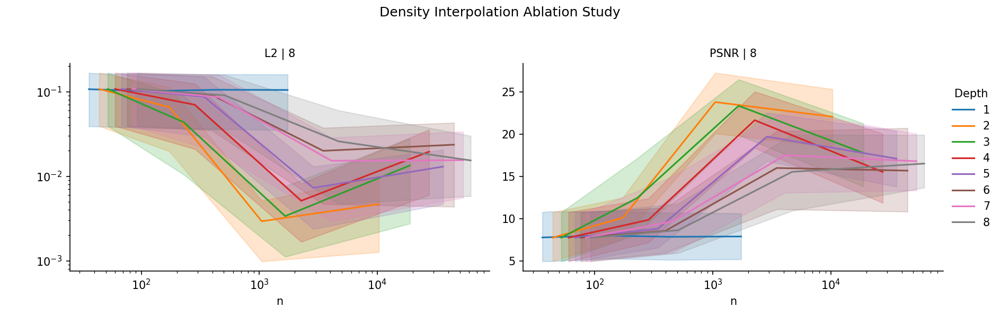

In [227]:
g = sns.relplot(x = 'Parameters', y = 'Value', hue = 'Depth', col = 'Metric', data = processedData, row = 'Messages',
                kind = 'line', errorbar = ('pi',70), height = 4, 
#                 hue_order = ['CConv','SplineConv','DMCF', 'Fourier', 'Fourier (even)', 'Chebyshev'],
                facet_kws = {'sharey':False},
                col_order = ['L2', 'PSNR'], aspect = 1.5)
g.set_axis_labels('n','')
# g.axes[0,0].set_title('PSNR')
# g.axes[0,1].set_title('R2')
g.axes[0,0].set_yscale('log')
g.set_titles('{col_name} | {row_name}')
g.despine(left=False)
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Density Interpolation Ablation Study')
g.axes[0,0].set_xscale('log')
# g.axes[0,0].set_xlim(2, 2**16)

<IPython.core.display.Javascript object>


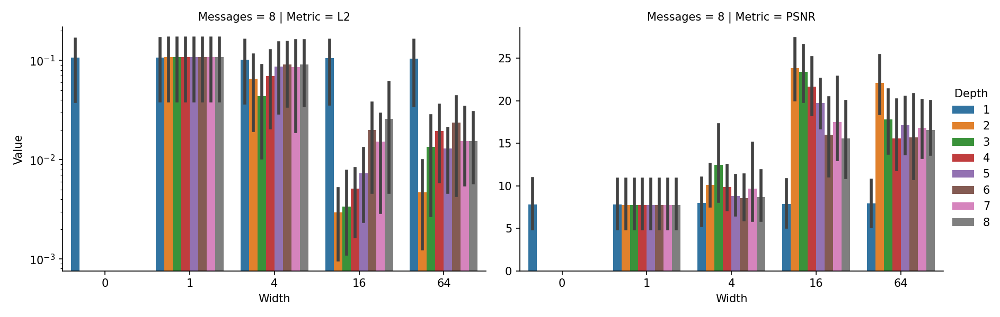

In [228]:
g = sns.catplot(x = 'Width', y = 'Value', hue = 'Depth', col = 'Metric', data = processedData, row = 'Messages',
                kind = 'bar', errorbar = ('pi',70), height = 4, 
#                 hue_order = ['CConv','SplineConv','DMCF', 'Fourier', 'Fourier (even)', 'Chebyshev'],
                facet_kws = {'sharey':False},
                col_order = ['L2', 'PSNR'], aspect = 1.5, sharey = False)
# g.set_axis_labels('n','')
# # g.axes[0,0].set_title('PSNR')
# # g.axes[0,1].set_title('R2')
g.axes[0,0].set_yscale('log')
# g.set_titles('{col_name} | {row_name}')
# g.despine(left=False)
# g.fig.subplots_adjust(top=0.8)
# g.fig.suptitle('Density Interpolation Ablation Study')
# g.axes[0,0].set_xscale('log')
# g.axes[0,0].set_xlim(2, 2**16)

In [ ]:
basis = 'rbf square'


ns = [1,2,3,4,5,6,7,8,16,32]
# ns = [4]
widths = [1][::-1]
depths = [0][::-1]
# widths = [16]
# depths = [3]

layouts = []
for d in depths:
    for w in widths:
        l = [w] * d + [1]
        if l not in layouts:
#             print([w] * d + [1])
            layouts.append(l)
# print(layouts)
# print(len(layouts) * len(seeds) * len(ns))
dataset = pandas.DataFrame()
# models = []

for basis in tqdm(bases, leave = False):
    dataset = pandas.DataFrame()
    for n in tqdm(ns, leave = False):
        for l in tqdm(layouts, leave = False):
            for s in tqdm(seeds, leave = False):
                trainedModel = trainModel(particleData, testData, settings, dataSet, trainingFiles, fluidFeatures = 1, offset = offset,
                                  n = n, basis = basis, layers = l, seed = s,
                                 window = window, windowNorm = windowNorm,
                                 epochs = 5, iterations = 1000, initialLR = 1e-3, device = device, testInterval = 1000,
                                 groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)
        #         models.append(trainedModel)
                df = getTestingLossFrame(trainedModel, testData, plot = False)
                dataset = pandas.concat([dataset, df])
                dataset.to_csv('ablationStudy_densityGradient_%s ns %s ws %s ds %s seeds %s.csv' % (basis, '[' + ' '.join([str(d) for d in ns]) + ']', '[' + ' '.join([str(d) for d in widths]) + ']', '[' + ' '.join([str(d) for d in depths]) + ']', '[' + ' '.join([str(d) for d in seeds]) + ']'))
                


In [311]:
positions, velocities, areas, dudts, density, inputVelocity, outputVelocity, setup = loadBatch(trainingData, settings, dataSet, bdata, device, offset)
i, j, distance, direction = batchedNeighborsearch(positions, setup)
x, u, v, rho, dudt, inVel, outVel = flatten(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity)

x = x[:,None].to(device)    
groundTruth = groundTruthFn(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity, i, j, distance, direction).to(device)
distance = (distance * direction)[:,None].to(device)
features = featureFn(x, u, v, rho, dudt, inVel, outVel).to(device)

MLPmodel.train()
optimizerMLP.zero_grad()
featuresOut = MLPmodel(features, i, j, distance)
print(features, featuresOut)

print(featuresOut,groundTruth)
diff = torch.mean((features - featuresOut)**2)
diff.backward()
# print(list(MLPmodel.parameters())[0], list(MLPmodel.parameters())[0].grad)

IndexError: tuple index out of range

<IPython.core.display.Javascript object>


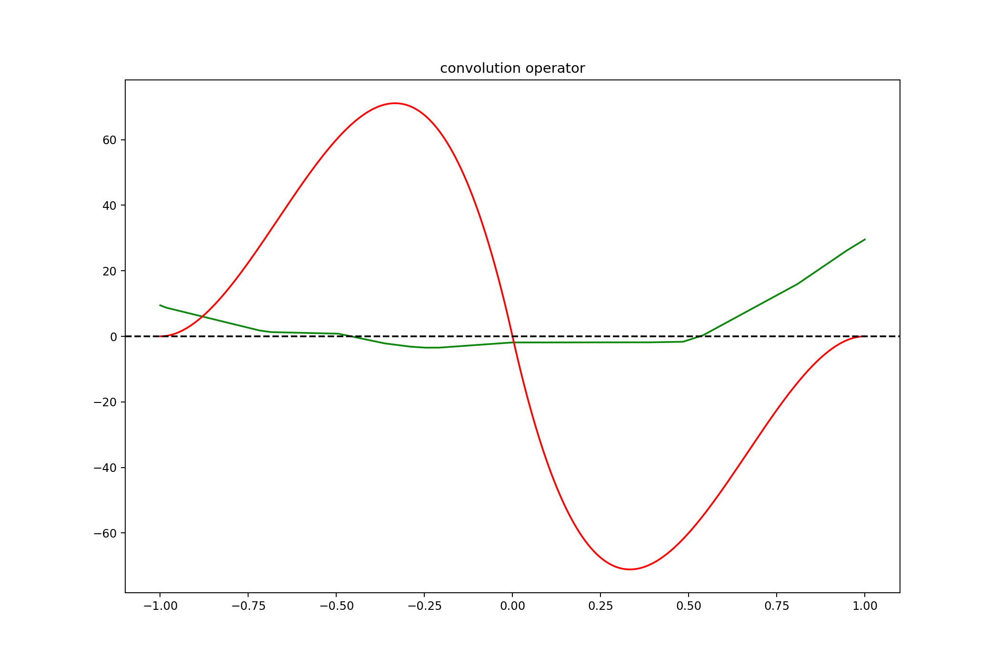

In [131]:
fig, axis = plt.subplots(1,1, figsize=(12,8), sharex = True, sharey = False, squeeze = False)

xSynthetic, featuresSynthetic, iSynthetic, jSynthetic = generateSyntheticData(511, device)

# if modelState['fluidFeatures'] == 1:
modelSynth = MLPmodel(featuresSynthetic , iSynthetic, jSynthetic, xSynthetic).detach().cpu().numpy()
#         print(np.min(modelSynth))
#         print(np.max(modelSynth))
axis[0,0].plot(xSynthetic[:,0].detach().cpu().numpy(), modelSynth, ls='-',c= 'green', alpha = 0.95)
#         axis['F'].plot(xSynthetic[:,0].detach().cpu().numpy(), baseArea * kernel(torch.abs(xSynthetic), particleSupport).detach().cpu().numpy(), c = 'blue')
fxBase = baseArea * kernelGradient(torch.abs(xSynthetic), torch.sign(xSynthetic), particleSupport).detach().cpu().numpy()
#         print(np.min(fxBase))
#         print(np.max(fxBase))
axis[0,0].plot(xSynthetic[:,0].detach().cpu().numpy(), fxBase, c = 'red')
axis[0,0].set_title('convolution operator')
axis[0,0].axhline(0, ls = '--', c = 'black')


In [109]:
list(MLPmodel.parameters())

[Parameter containing:
 tensor([[ 0.0406],
         [-0.0292],
         [-0.0346],
         [ 0.0337]], device='cuda:0', requires_grad=True),
 Parameter containing:
 tensor([0., 0., 0., 0.], device='cuda:0', requires_grad=True),
 Parameter containing:
 tensor([1., 1., 1., 1.], device='cuda:0', requires_grad=True),
 Parameter containing:
 tensor([0., 0., 0., 0.], device='cuda:0', requires_grad=True),
 Parameter containing:
 tensor([[-0.0203, -0.0377,  0.0236, -0.0441],
         [ 0.0024, -0.0337,  0.0162, -0.0198],
         [-0.0370, -0.0433, -0.0207,  0.0295],
         [ 0.0273,  0.0395, -0.0308, -0.0082]], device='cuda:0',
        requires_grad=True),
 Parameter containing:
 tensor([0., 0., 0., 0.], device='cuda:0', requires_grad=True),
 Parameter containing:
 tensor([1., 1., 1., 1.], device='cuda:0', requires_grad=True),
 Parameter containing:
 tensor([0., 0., 0., 0.], device='cuda:0', requires_grad=True),
 Parameter containing:
 tensor([[-0.0421,  0.0330, -0.0102, -0.0359],
        

In [110]:
features.shape

torch.Size([8192, 1])

In [111]:
def trainMLP(particleData, testData, settings, dataSet, trainingFiles, offset, seed, mlpLayout = [8,8,8,8,1], fluidFeatures = 1, n = 16, basis = 'linear', layers = [1], window = None, windowNorm = None, epochs = 5, iterations = 1000, testInterval = 10, initialLR = 1e-2, groundTruthFn = None, featureFn = None, lossFn = None, device = 'cpu', weightOverride = None):   
#     random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    np.random.seed(seed)
    
    windowFn = getWindowFunction(window, norm = windowNorm) if window is not None else None
    model = mlpNetwork(inputFeatures = fluidFeatures, mlpLayout = mlpLayout, layers = layers).to(device) 
#     model = RbfNet(fluidFeatures = fluidFeatures, 
#                    layers = layers, 
#                    denseLayer = True, activation = 'ReLU', coordinateMapping = 'cartesian', 
#                    n = n, windowFn = windowFn, rbf = basis, batchSize = 32, ignoreCenter = True, normalized = False).to(device)   
    lr = initialLR
    with torch.no_grad():
        if weightOverride is not None:
            model.convs[0].weight[:,0,0] = torch.tensor(weightOverride).to(device)
    
    optimizer = Adam(model.parameters(), lr=lr, weight_decay=0)
    losses = []
    lossValues = []
    testLosses = {}
    testPredictions = {}
    for e in (pb := tqdm(range(epochs), leave = False)):
        for b in (pbl := tqdm(range(iterations), leave=False)):
            
            try:
                bdata = next(dataIter)
                if len(bdata) < batchSize :
                    raise Exception('batch too short')
            except:
                dataIter = iter(dataLoader)
                bdata = next(dataIter)

            positions, velocities, areas, dudts, density, inputVelocity, outputVelocity, setup = loadBatch(trainingData, settings, dataSet, bdata, device, offset)
            i, j, distance, direction = batchedNeighborsearch(positions, setup)
            x, u, v, rho, dudt, inVel, outVel = flatten(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity)

            x = x[:,None].to(device)    
            groundTruth = groundTruthFn(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity, i, j, distance, direction).to(device)
            distance = (distance * direction)[:,None].to(device)
            features = featureFn(x, u, v, rho, dudt, inVel, outVel).to(device)

            optimizer.zero_grad()
            prediction = model(features.to(device), i.to(device), j.to(device), distance.to(device))[:,0]
            lossTerm = lossFn(prediction, groundTruth)
            loss = torch.mean(lossTerm)

            loss.backward()
            optimizer.step()
            losses.append(lossTerm.detach().cpu())
            lossValues.append(loss.detach().cpu().item())

            lossString = np.array2string(torch.mean(lossTerm.reshape(batchSize, positions[0].shape[0]),dim=1).detach().cpu().numpy(), formatter={'float_kind':lambda x: "%.4e" % x})
            batchString = str(np.array2string(np.array(bdata), formatter={'float_kind':lambda x: "%.2f" % x, 'int':lambda x:'%6d' % x}))

            pbl.set_description('%s:  %s -> %.4e' %(batchString, lossString, loss.detach().cpu().numpy()))
            pb.set_description('epoch %2dd, lr %6.4g: loss %.4e [rolling %.4e]' % (e, lr, np.mean(lossValues), np.mean(lossValues[-100:] if len(lossValues) > 100 else lossValues)))
            
            it = e * iterations + b
            if it % testInterval == 0:
                with torch.no_grad():
                    testLossDict = {}
                    testPreds = {}
                    for i, k in  enumerate(testData.keys()):
                        gt = testData[k][9].reshape(len(testData[k][0]), testData[k][0][0].shape[0])
                        prediction = model(testData[k][5], testData[k][6], testData[k][7], testData[k][8]).reshape(len(testData[k][0]), testData[k][0][0].shape[0])
                        arr = []
                        for i, (xs, pred, gt) in enumerate(zip(testData[k][0], prediction, gt)):
                             arr.append(lossFn(pred, gt).detach().cpu().numpy())
                        testLossDict[k] = arr
                        testPreds[k] = prediction.detach().cpu()
#                         print(testLossDict[k])
                    testLosses[it] = testLossDict
                    testPredictions[it] = testPreds
#             break
#         break
        
        lr = lr * 0.5
        for param_group in optimizer.param_groups:
            param_group['lr'] = 0.5 * param_group['lr']
            
    return {'model': model, 'optimizer': optimizer, 'finalLR': lr, 'losses': losses, 'testLosses': testLosses, 'testPredictions': testPredictions, 'seed': seed,
            'window': window, 'windowNorm': windowNorm, 'n':n, 'basis':basis, 'layers':layers, 'epochs': epochs, 'iterations': iterations, 'fluidFeatures': fluidFeatures          
           }

In [112]:
def trainModel(particleData, testData, settings, dataSet, trainingFiles, offset, seed, fluidFeatures = 1, n = 16, basis = 'linear', layers = [1], window = None, windowNorm = None, epochs = 5, iterations = 1000, testInterval = 10, initialLR = 1e-2, groundTruthFn = None, featureFn = None, lossFn = None, device = 'cpu', weightOverride = None):   
#     random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    np.random.seed(seed)
    
    windowFn = getWindowFunction(window, norm = windowNorm) if window is not None else None
    model = RbfNet(fluidFeatures = fluidFeatures, 
                   layers = layers, 
                   denseLayer = True, activation = 'ReLU', coordinateMapping = 'cartesian', 
                   n = n, windowFn = windowFn, rbf = basis, batchSize = 32, ignoreCenter = True, normalized = False).to(device)   
    lr = initialLR
    with torch.no_grad():
        if weightOverride is not None:
            model.convs[0].weight[:,0,0] = torch.tensor(weightOverride).to(device)
    
    optimizer = Adam(model.parameters(), lr=lr, weight_decay=0)
    losses = []
    lossValues = []
    testLosses = {}
    testPredictions = {}
    for e in (pb := tqdm(range(epochs), leave = False)):
        for b in (pbl := tqdm(range(iterations), leave=False)):
            
            try:
                bdata = next(dataIter)
                if len(bdata) < batchSize :
                    raise Exception('batch too short')
            except:
                dataIter = iter(dataLoader)
                bdata = next(dataIter)

            positions, velocities, areas, dudts, density, inputVelocity, outputVelocity, setup = loadBatch(trainingData, settings, dataSet, bdata, device, offset)
            i, j, distance, direction = batchedNeighborsearch(positions, setup)
            x, u, v, rho, dudt, inVel, outVel = flatten(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity)

            x = x[:,None].to(device)    
            groundTruth = groundTruthFn(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity, i, j, distance, direction).to(device)
            distance = (distance * direction)[:,None].to(device)
            features = featureFn(x, u, v, rho, dudt, inVel, outVel).to(device)

            optimizer.zero_grad()
            prediction = model(features.to(device), i.to(device), j.to(device), distance.to(device))[:,0]
            lossTerm = lossFn(prediction, groundTruth)
            loss = torch.mean(lossTerm)

            loss.backward()
            optimizer.step()
            losses.append(lossTerm.detach().cpu())
            lossValues.append(loss.detach().cpu().item())

            lossString = np.array2string(torch.mean(lossTerm.reshape(batchSize, positions[0].shape[0]),dim=1).detach().cpu().numpy(), formatter={'float_kind':lambda x: "%.4e" % x})
            batchString = str(np.array2string(np.array(bdata), formatter={'float_kind':lambda x: "%.2f" % x, 'int':lambda x:'%6d' % x}))

            pbl.set_description('%s:  %s -> %.4e' %(batchString, lossString, loss.detach().cpu().numpy()))
            pb.set_description('epoch %2dd, lr %6.4g: loss %.4e [rolling %.4e]' % (e, lr, np.mean(lossValues), np.mean(lossValues[-100:] if len(lossValues) > 100 else lossValues)))
            
            it = e * iterations + b
            if it % testInterval == 0:
                with torch.no_grad():
                    testLossDict = {}
                    testPreds = {}
                    for i, k in  enumerate(testData.keys()):
                        gt = testData[k][9].reshape(len(testData[k][0]), testData[k][0][0].shape[0])
                        prediction = model(testData[k][5], testData[k][6], testData[k][7], testData[k][8]).reshape(len(testData[k][0]), testData[k][0][0].shape[0])
                        arr = []
                        for i, (xs, pred, gt) in enumerate(zip(testData[k][0], prediction, gt)):
                             arr.append(lossFn(pred, gt).detach().cpu().numpy())
                        testLossDict[k] = arr
                        testPreds[k] = prediction.detach().cpu()
#                         print(testLossDict[k])
                    testLosses[it] = testLossDict
                    testPredictions[it] = testPreds
#             break
#         break
        
        lr = lr * 0.5
        for param_group in optimizer.param_groups:
            param_group['lr'] = 0.5 * param_group['lr']
            
    return {'model': model, 'optimizer': optimizer, 'finalLR': lr, 'losses': losses, 'testLosses': testLosses, 'testPredictions': testPredictions, 'seed': seed,
            'window': window, 'windowNorm': windowNorm, 'n':n, 'basis':basis, 'layers':layers, 'epochs': epochs, 'iterations': iterations, 'fluidFeatures': fluidFeatures          
           }

In [45]:
import sklearn
import pandas
def signaltonoise_dB(a, axis=0, ddof=0):
    a = np.asanyarray(a)
    m = a.mean(axis)
    sd = a.std(axis=axis, ddof=ddof)
    return 20*np.log10(abs(np.where(sd == 0, 0, m/sd)))

def getTestingLossFrame(modelState, testData, plot = False):
    label = '%s x %2d @ %s' % (modelState['basis'], modelState['n'], str(modelState['layers']))
    testPredictions = {}
    testGTs = {}
    testPositions = {}
    with torch.no_grad():
        for i, k in  enumerate(testData.keys()):
            gt = testData[k][9].reshape(len(testData[k][0]), testData[k][0][0].shape[0])
            prediction = modelState['model'](testData[k][5], testData[k][6], testData[k][7], testData[k][8]).reshape(len(testData[k][0]), testData[k][0][0].shape[0]).detach().cpu().numpy()
            testPredictions[k] = prediction
            testGTs[k] = gt.detach().cpu().numpy()
            testPositions[k] = testData[k][0]
    if plot:
        fig, axis = plt.subplots(len(testPredictions.keys()),3, figsize=(16,8), sharex = True, sharey = 'col', squeeze = False)

        for s, k in  enumerate(testData.keys()):
            norm = mpl.colors.Normalize(vmin=0, vmax=len(testPredictions[k]) - 1)
            for i, (xs, rhos) in enumerate(zip(testPositions[k], testGTs[k])):
                c = cmap(norm(i))
                axis[s,0].plot(xs.cpu().numpy(), rhos, ls = '-', c = c)
            for i, (xs, rhos) in enumerate(zip(testPositions[k], testPredictions[k])):
                c = cmap(norm(i))
                axis[s,1].plot(xs.cpu().numpy(), rhos, ls = '-', c = c)
            for i, (xs, pred, gt) in enumerate(zip(testPositions[k], testPredictions[k], testGTs[k])):
                c = cmap(norm(i))
                axis[s,2].plot(xs.cpu().numpy(), pred- gt, ls = '-', c = c)
        axis[0,0].set_title('GT')
        axis[0,1].set_title('Pred')
        axis[0,2].set_title('Loss')
        fig.tight_layout()
        # axis[0,0].plot()
    lossDict = []
    for s, k in  enumerate(testData.keys()):
        lossTerms = []
        for i, (xs, pred, gt) in enumerate(zip(testPositions[k], testPredictions[k], testGTs[k])):
            loss = (pred - gt)**2
            r2 = sklearn.metrics.r2_score(gt, pred)
            l2 = sklearn.metrics.mean_squared_error(gt, pred)

            maxSignal = np.max(np.abs(gt))
    #         mse = np.mean((pred - gt)**2)
            psnr = 20 * math.log10(maxSignal / np.sqrt(l2))
    #         print(20 * math.log10(maxSignal / np.sqrt(mse)))
    #         print(maxSignal, mse)
    #         male = np.mean(np.abs(np.log(np.abs(pred) / np.abs(gt))[gt != 0]))
    #         rmsle = np.sqrt(np.mean(np.log(np.abs(pred) / np.abs(gt))[gt != 0]**2)
            minVal = np.min(loss)
            maxVal = np.max(loss)
            std = np.std(loss)
            q1, q3 = np.percentile(loss, [25, 75])
    #         print('r2', r2, 'l2', l2, 'psnr', l2, 'min', minVal, 'max', maxVal, 'q1', q1, 'q3', q3, 'std', std)
            lossTerms.append({'label': label, 'seed':modelState['seed'], 'window':modelState['window'], 'file':k, 'basis':modelState['basis'], 'n':modelState['n'],'entry':str(i), 'params': count_parameters(modelState['model']), 'depth':len(modelState['layers']), 'width':np.max(modelState['layers']),'r2':r2,'l2':l2,'psnr':psnr, 'min':minVal, 'max':maxVal, 'q1':q1, 'q3':q3, 'std':std})
    #         print(r2, l2, psnr)
    #         print(male, rmsle)
    #         break
        lossDict += lossTerms
    #     break
    return pandas.DataFrame(data = lossDict)

In [133]:

class RbfNet(torch.nn.Module):
    def __init__(self, fluidFeatures, layers = [32,64,64,2], denseLayer = True, activation = 'relu',
                coordinateMapping = 'cartesian', n = 8, windowFn = None, rbf = 'linear',batchSize = 32, ignoreCenter = True, normalized = False):
        super().__init__()
        self.centerIgnore = ignoreCenter
        self.features = copy.copy(layers)
        self.convs = torch.nn.ModuleList()
        self.fcs = torch.nn.ModuleList()
        self.relu = getattr(nn.functional, 'relu')
        self.layers = layers
        self.normalized = normalized
        if len(layers) == 1:
            self.convs.append(RbfConv(
                in_channels = fluidFeatures, out_channels = self.features[0],
                dim = 1, size = [n],
                rbf = rbf,
                bias = False,
                linearLayer = False, biasOffset = False, feedThrough = False,
                preActivation = None, postActivation = None,
                coordinateMapping = coordinateMapping,
                batch_size = [batchSize, batchSize], windowFn = windowFn, normalizeWeights = False, normalizeInterpolation = normalized))

            self.centerIgnore = False
            return

        self.convs.append(RbfConv(
            in_channels = fluidFeatures, out_channels = self.features[0],
            dim = 1, size = [n],
            rbf = rbf,
            bias = True,
            linearLayer = False, biasOffset = False, feedThrough = False,
            preActivation = None, postActivation = None,
            coordinateMapping = coordinateMapping,
            batch_size = [batchSize, batchSize], windowFn = windowFn, normalizeWeights = False, normalizeInterpolation = normalized))
                
        self.fcs.append(nn.Linear(in_features=fluidFeatures,out_features= layers[0],bias=True))
        torch.nn.init.xavier_uniform_(self.fcs[-1].weight)
        torch.nn.init.zeros_(self.fcs[-1].bias)

        self.features[0] = self.features[0]
        for i, l in enumerate(layers[1:-1]):
            self.convs.append(RbfConv(
                in_channels = (2 * self.features[0]) if i == 0 else self.features[i], out_channels = layers[i+1],
                dim = 1, size = [n],
                rbf = rbf,
                bias = True,
                linearLayer = False, biasOffset = False, feedThrough = False,
                preActivation = None, postActivation = None,
                coordinateMapping = coordinateMapping,
                batch_size = [batchSize, batchSize], windowFn = windowFn, normalizeWeights = False, normalizeInterpolation = normalized))
            self.fcs.append(nn.Linear(in_features=2 * layers[0] if i == 0 else layers[i],out_features=layers[i+1],bias=True))
            torch.nn.init.xavier_uniform_(self.fcs[-1].weight)
            torch.nn.init.zeros_(self.fcs[-1].bias)
            
        self.convs.append(RbfConv(
            in_channels = self.features[-2] if  len(layers) > 2 else self.features[-2] * 2, out_channels = self.features[-1],
                dim = 1, size = [n],
                rbf = rbf,
                bias = True,
                linearLayer = False, biasOffset = False, feedThrough = False,
                preActivation = None, postActivation = None,
                coordinateMapping = coordinateMapping,
                batch_size = [batchSize, batchSize], windowFn = windowFn, normalizeWeights = False, normalizeInterpolation = normalized))
        self.fcs.append(nn.Linear(in_features=self.features[-2] if  len(layers) > 2 else self.features[-2] * 2,out_features=self.features[-1],bias=True))
        torch.nn.init.xavier_uniform_(self.fcs[-1].weight)
        torch.nn.init.zeros_(self.fcs[-1].bias)


    def forward(self, \
                fluidFeatures, \
                fi, fj, distances):
        if self.centerIgnore:
            nequals = fi != fj

        i, ni = torch.unique(fi, return_counts = True)
        self.ni = ni
        self.li = torch.exp(-1 / 16 * ni)

        if self.centerIgnore:
            fluidEdgeIndex = torch.stack([fi[nequals], fj[nequals]], dim = 0)
        else:
            fluidEdgeIndex = torch.stack([fi, fj], dim = 0)
            
        if self.centerIgnore:
            fluidEdgeLengths = distances[nequals]
        else:
            fluidEdgeLengths = distances
        fluidEdgeLengths = fluidEdgeLengths.clamp(-1,1)
            
        fluidConvolution = (self.convs[0]((fluidFeatures, fluidFeatures), fluidEdgeIndex, fluidEdgeLengths)) / particleSupport
#         fluidConvolution = scatter_sum(baseArea * fluidFeatures[fluidEdgeIndex[1]] * kernelGradient(torch.abs(fluidEdgeLengths), torch.sign(fluidEdgeLengths), particleSupport), fluidEdgeIndex[0], dim = 0, dim_size = fluidFeatures.shape[0])
        
        if len(self.layers) == 1:
            return fluidConvolution 
        linearOutput = (self.fcs[0](fluidFeatures))
        ans = torch.hstack((linearOutput, fluidConvolution))
        if verbose:
            print('first layer output', ans[:4])
        
        layers = len(self.convs)
        for i in range(1,layers):
            
            ansc = self.relu(ans)
            
            ansConv = self.convs[i]((ansc, ansc), fluidEdgeIndex, fluidEdgeLengths)
            ansDense = self.fcs[i - 0](ansc)
            
            
            if self.features[i-1] == self.features[i-0] and ans.shape == ansConv.shape:
                ans = ansConv + ansDense + ans
            else:
                ans = ansConv + ansDense
            if verbose:
                print('\tlayer output after activation', ans[:4])
        return ans
    

In [115]:
from scipy.optimize import minimize
nTerms = 4
nEval = 1023

x = np.ones(nTerms)
xvals = np.linspace(-1,1,nEval)
baseTerms = np.sin(xvals[:,None] * np.pi * (np.arange(len(x)) + 1))
terms = (x * baseTerms).T

fx = lambda x: baseArea * kernelGradient(np.abs(x), np.sign(x), particleSupport) * particleSupport
fvals = fx(np.linspace(-1,1,nEval))

error = lambda r: np.mean((fvals - np.sum((r * baseTerms).T, axis = 0))**2)
res = minimize(error, x, method="nelder-mead", options = {'disp': True, 'maxiter': 2**20, 'maxfev': 2**20})  
display(res)
# print(error(res.x))

Optimization terminated successfully.
         Current function value: 0.000037
         Iterations: 156
         Function evaluations: 257


 final_simplex: (array([[-0.4837434 , -0.18144132, -0.01795365, -0.02265835],
       [-0.48378652, -0.18140394, -0.01797717, -0.02266821],
       [-0.48374067, -0.18138091, -0.01793936, -0.02263866],
       [-0.48379755, -0.18144194, -0.01796059, -0.02264421],
       [-0.48374503, -0.18137596, -0.0178647 , -0.02267194]]), array([3.70527413e-05, 3.70530968e-05, 3.70531970e-05, 3.70532563e-05,
       3.70536848e-05]))
           fun: 3.705274129104107e-05
       message: 'Optimization terminated successfully.'
          nfev: 257
           nit: 156
        status: 0
       success: True
             x: array([-0.4837434 , -0.18144132, -0.01795365, -0.02265835])

<IPython.core.display.Javascript object>


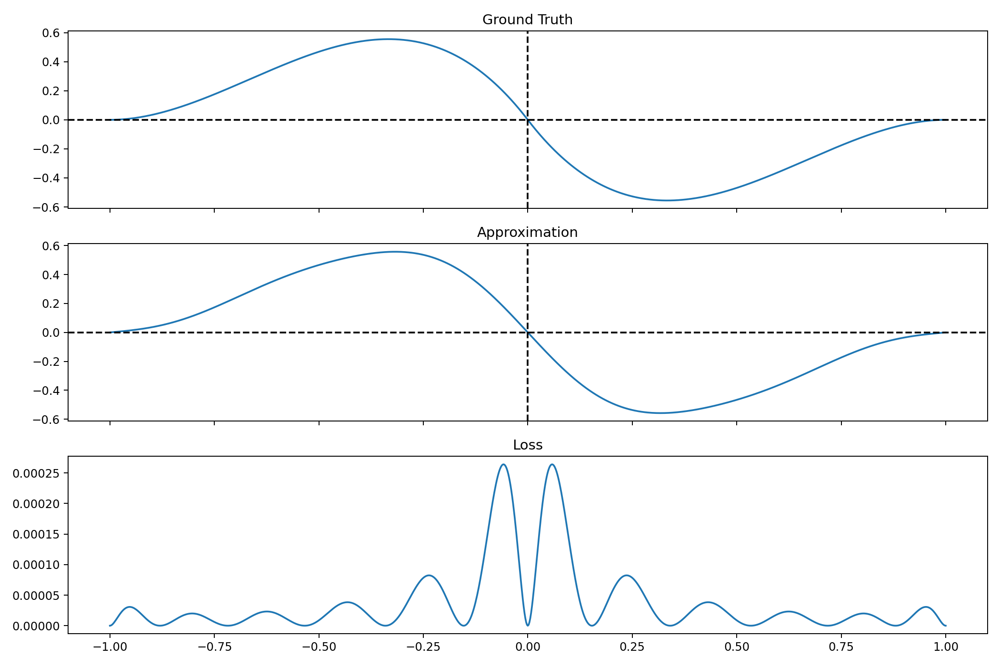

-0.5555539588304171
0.5555539588304171
[-0.4837434  -0.18144132 -0.01795365 -0.02265835]


In [116]:
fig, axis = plt.subplots(3,1, figsize=(12,8), sharex = True, sharey = False, squeeze = False)
axis[0,0].plot(np.linspace(-1,1,nEval), fx(np.linspace(-1,1,nEval)))
terms = (res.x * baseTerms).T
axis[1,0].plot(xvals, np.sum(terms, axis = 0))
axis[0,0].axvline(0, ls = '--', c = 'black')
axis[0,0].axhline(0, ls = '--', c = 'black')
axis[1,0].axvline(0, ls = '--', c = 'black')
axis[1,0].axhline(0, ls = '--', c = 'black')

axis[2,0].plot(xvals, (np.sum(terms, axis = 0) - fx(np.linspace(-1,1,nEval)))**2 )

print(np.min(fx(np.linspace(-1,1,nEval))))
print(np.max(fx(np.linspace(-1,1,nEval))))

print(res.x)

axis[0,0].set_title('Ground Truth')
axis[1,0].set_title('Approximation')
axis[2,0].set_title('Loss')

# axis[3,0].semilogy(np.abs(res.x))
fig.tight_layout()

In [117]:
n = 4

In [118]:
# with torch.no_grad():
#     torch.nn.init.uniform

In [119]:
basis = 'ffourier'
basis = 'linear'
basis = 'fourier'

In [120]:
seeds = np.random.randint(0, 2**30, 4)

In [121]:
os.environ["PYTORCH_NVFUSER_DISABLE"] = 'fallback'
os.environ["PYTORCH_JIT_LOG_LEVEL"] = 'manager.cpp'
#  export PYTORCH_JIT_LOG_LEVEL=manager.cpp`

In [122]:
[0] + res.x.tolist()

[0,
 -0.4837434026066332,
 -0.18144132179579764,
 -0.017953646139354747,
 -0.02265834588571309]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


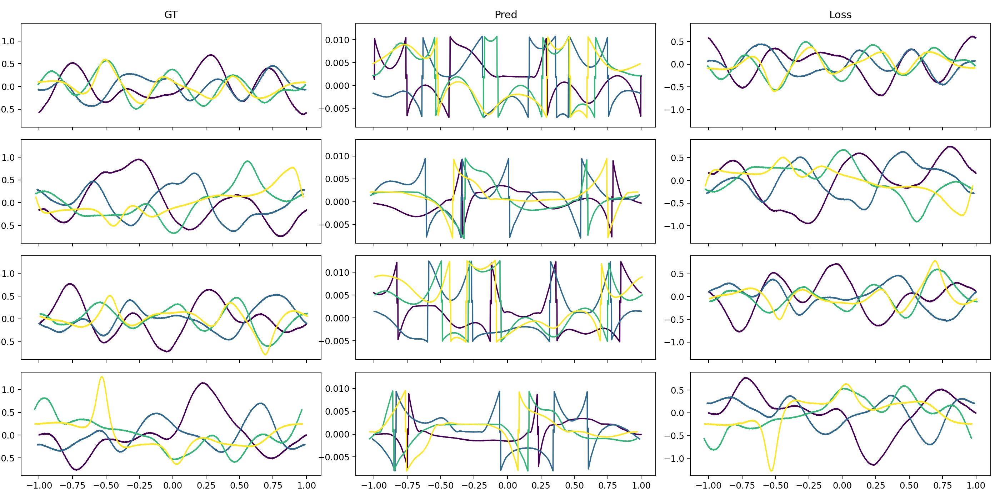

,label,seed,window,file,basis,n,entry,params,depth,width,r2,l2,psnr,min,max,q1,q3,std
0,MLP x 5 @ [1],944839437,None,perlin_882368412,MLP,5,0,997,1,1,0.000250,0.107063,6.542839,2.988996e-07,0.479634,0.021929,0.149941,0.116458
1,MLP x 5 @ [1],944839437,None,perlin_882368412,MLP,5,1,997,1,1,-0.000327,0.048685,6.364026,3.238044e-09,0.209629,0.006407,0.072228,0.054973
2,MLP x 5 @ [1],944839437,None,perlin_882368412,MLP,5,2,997,1,1,0.000190,0.071205,6.635113,8.471414e-10,0.330106,0.009486,0.110435,0.076781
3,MLP x 5 @ [1],944839437,None,perlin_882368412,MLP,5,3,997,1,1,-0.000184,0.040839,9.403169,5.535860e-09,0.361243,0.005664,0.046777,0.064480
4,MLP x 5 @ [1],944839437,None,perlin_783832494,MLP,5,0,997,1,1,0.000001,0.233808,5.896839,1.058361e-08,0.906856,0.027389,0.393234,0.237816
5,MLP x 5 @ [1],944839437,None,perlin_783832494,MLP,5,1,997,1,1,0.000190,0.114916,5.643934,1.204423e-09,0.419979,0.019145,0.180070,0.113025
6,MLP x 5 @ [1],944839437,None,perlin_783832494,MLP,5,2,997,1,1,-0.000009,0.121096,8.407022,2.605521e-07,0.833070,0.015896,0.094048,0.181084
7,MLP x 5 @ [1],944839437,None,perlin_783832494,MLP,5,3,997,1,1,0.000151,0.079523,8.776811,3.823645e-09,0.597026,0.018669,0.076197,0.125112
8,MLP x 5 @ [1],944839437,None,perlin_137881214,MLP,5,0,997,1,1,0.000080,0.145320,6.164201,2.352930e-09,0.601562,0.009095,0.253326,0.167977
9,MLP x 5 @ [1],944839437,None,perlin_137881214,MLP,5,1,997,1,1,0.000098,0.069803,6.202294,1.316631e-08,0.296096,0.004006,0.118455,0.078788


In [135]:
trainMLP
basis = 'MLP'
window = 'cubicSpline'
window = None
windowFn = getWindowFunction(window)
n = 5
trainedModel = trainMLP(particleData, testData, settings, dataSet, trainingFiles, fluidFeatures = 1, offset = offset, mlpLayout = [16,16,16,16,1],
                          n = n, basis = basis, layers = [1], seed = seeds[0],
                         window = window, windowNorm = windowNorm,
                         epochs = 5, iterations = 1000, initialLR = 1e-3, device = device, testInterval = 100,
#                          groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction, weightOverride = [0] + (res.x * np.sqrt(np.pi)).tolist())
                         groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)
# plotModel(trainedModel, testData, device, baseArea, particleSupport)
# plotTrainedBatch(trainingData, settings, dataSet, bdata, device, offset, trainedModel, groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)
df = getTestingLossFrame(trainedModel, testData, plot = True)
display(df)

<IPython.core.display.Javascript object>


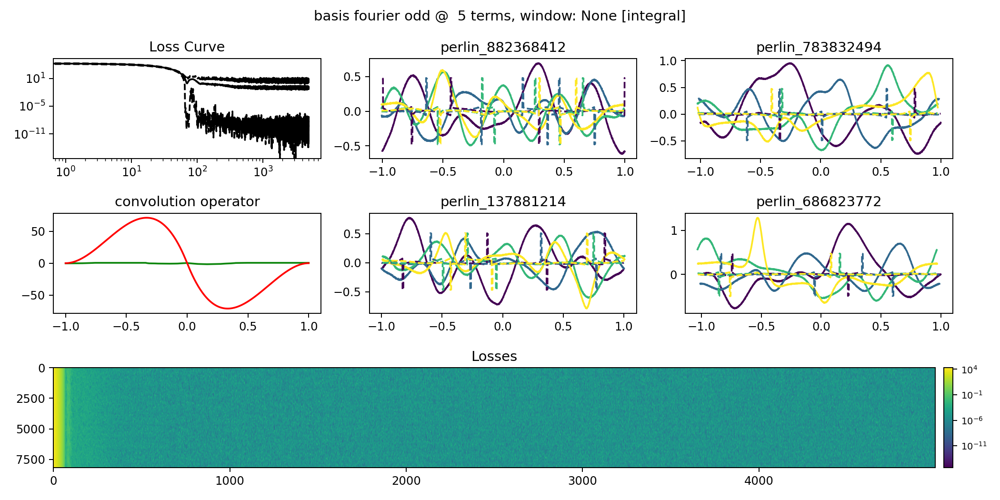

In [99]:

plotModel(trainedModel, testData, device, baseArea, particleSupport)

In [ ]:
widths = [1,2,4,8,16,32]
depths = [1,2,3,4,5,6,7]

In [ ]:
basis = 'MLP'
# ns = [1,2,3,4,5,6,7,8,16,32]
# ns = [4]
widths = [1,2,4,6,8,12,16,24,32][::-1]
depths = [1,2,3,4,5,6,7][::-1]
# widths = [16]
# depths = [3]

layouts = []
for d in depths:
    for w in widths:
        l = [w] * d + [1]
        if l not in layouts:
#             print([w] * d + [1])
            layouts.append(l)
# print(layouts)
# print(len(layouts) * len(seeds) * len(ns))
dataset = pandas.DataFrame()
# models = []
# print(len(layouts), layouts)


# for n in tqdm(ns, leave = False):
for l in tqdm(layouts, leave = False):
    for s in tqdm(seeds, leave = False):
        trainedModel = trainMLP(particleData, testData, settings, dataSet, trainingFiles, fluidFeatures = 1, offset = offset, mlpLayout = l,
                          n = n, basis = basis, layers = [1], seed = s,
                         window = window, windowNorm = windowNorm,
                         epochs = 5, iterations = 1000, initialLR = 1e-3, device = device, testInterval = 1000,
                         groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)
#         models.append(trainedModel)
        df = getTestingLossFrame(trainedModel, testData, plot = False)
        dataset = pandas.concat([dataset, df])
        dataset.to_csv('ablationStudy_density_%s ns %s ws %s ds %s seeds %s.csv' % (basis, '[' + ' '.join([str(d) for d in ns]) + ']', '[' + ' '.join([str(d) for d in widths]) + ']', '[' + ' '.join([str(d) for d in depths]) + ']', '[' + ' '.join([str(d) for d in seeds]) + ']'))

  0%|          | 0/63 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


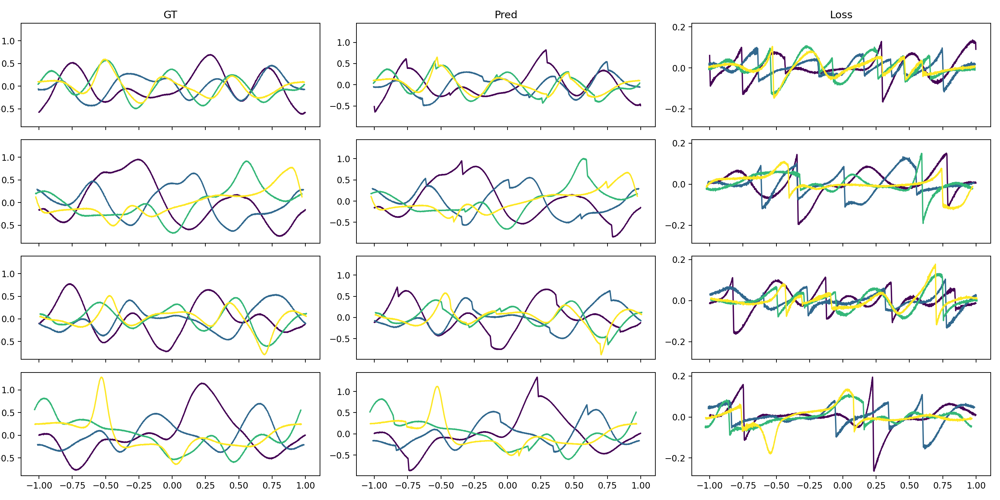

<IPython.core.display.Javascript object>


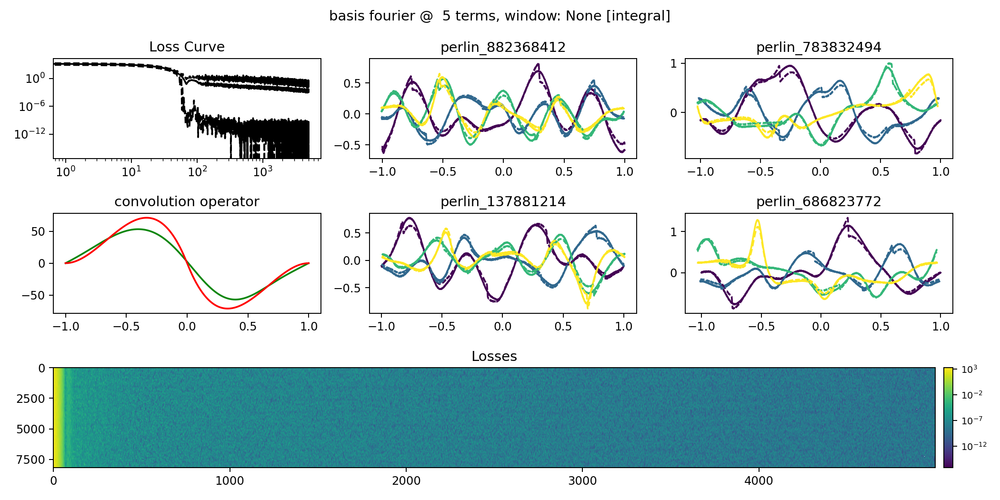

In [134]:
basis = 'fourier'
window = 'cubicSpline'
window = None
windowFn = getWindowFunction(window)
n = 5
trainedModel = trainModel(particleData, testData, settings, dataSet, trainingFiles, fluidFeatures = 1, offset = offset,
                          n = n, basis = basis, layers = [1], seed = seeds[0],
                         window = window, windowNorm = windowNorm,
                         epochs = 5, iterations = 1000, initialLR = 1e-3, device = device, testInterval = 100,
#                          groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction, weightOverride = [0] + (res.x * np.sqrt(np.pi)).tolist())
                         groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)
# plotModel(trainedModel, testData, device, baseArea, particleSupport)
# plotTrainedBatch(trainingData, settings, dataSet, bdata, device, offset, trainedModel, groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)
df = getTestingLossFrame(trainedModel, testData, plot = True)
# display(df)
plotModel(trainedModel, testData, device, baseArea, particleSupport)

<IPython.core.display.Javascript object>


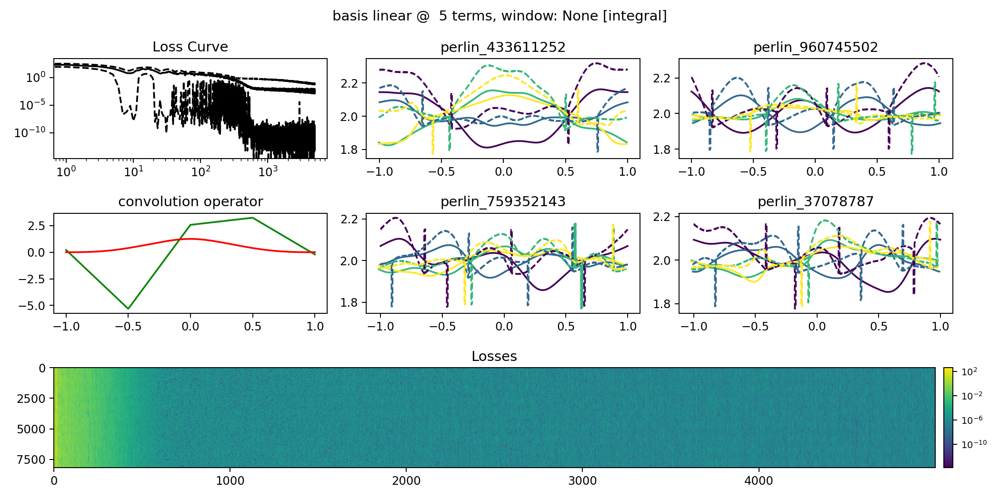

In [422]:
# with torch.no_grad():
#     trainedModel['model'].convs[0].weight[:,0,0] = torch.tensor([0] + (res.x * np.sqrt(np.pi)).tolist()).to(device)
#     print(trainedModel['model'].convs[0].weight[:,0,0])
# df = getTestingLossFrame(trainedModel, testData, plot = True)
# display(df)

In [423]:
# plotModel(trainedModel, testData, device, baseArea, particleSupport)
# plotTrainedBatch(trainingData, settings, dataSet, bdata, device, offset, trainedModel, groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)

In [96]:
def plotModel(modelState, testData, device, baseArea, particleSupport):
    if modelState['fluidFeatures'] == 1:
        fig, axis = plt.subplot_mosaic('''ABC
        FGH
        DDD''', figsize=(12,6), sharex = False)
    else:
        fig, axis = plt.subplot_mosaic('''ABC
        AGH
        DDD''', figsize=(12,6), sharex = False)

    xSynthetic, featuresSynthetic, iSynthetic, jSynthetic = generateSyntheticData(511, device)

    steps = modelState['iterations'] * modelState['epochs']
    ls = np.logspace(0, np.log10(steps), num =  50)
    ls = [int(np.floor(f)) for f in ls]
    ls = np.unique(ls).tolist()

    if modelState['fluidFeatures'] == 1:
        modelSynth = modelState['model'](featuresSynthetic , iSynthetic, jSynthetic, xSynthetic).detach().cpu().numpy()
#         print(np.min(modelSynth))
#         print(np.max(modelSynth))
        axis['F'].plot(xSynthetic[:,0].detach().cpu().numpy(), modelSynth, ls='-',c= 'green', alpha = 0.95)
#         axis['F'].plot(xSynthetic[:,0].detach().cpu().numpy(), baseArea * kernel(torch.abs(xSynthetic), particleSupport).detach().cpu().numpy(), c = 'blue')
        fxBase = baseArea * kernelGradient(torch.abs(xSynthetic), torch.sign(xSynthetic), particleSupport).detach().cpu().numpy()
#         print(np.min(fxBase))
#         print(np.max(fxBase))
        axis['F'].plot(xSynthetic[:,0].detach().cpu().numpy(), fxBase, c = 'red')
        axis['F'].set_title('convolution operator')

    axis['A'].loglog(torch.mean(torch.vstack(modelState['losses']), dim = 1), ls = '-', c = 'black')
    axis['A'].loglog(torch.min(torch.vstack(modelState['losses']), dim = 1)[0], ls = '--', c = 'black')
    axis['A'].loglog(torch.max(torch.vstack(modelState['losses']), dim = 1)[0], ls = '--', c = 'black')
    axis['A'].set_title('Loss Curve')
    with torch.no_grad():
        for i, k in  enumerate(testData.keys()):
            ax = axis['B']
            if i == 0:
                ax = axis['B']
            if i == 1:
                ax = axis['C']
            if i == 2:
                ax = axis['G']
            if i == 3:
                ax = axis['H']    
            norm = mpl.colors.Normalize(vmin=0, vmax=len(testData[k][0]) - 1)
            gt = testData[k][9].reshape(len(testData[k][0]), testData[k][0][0].shape[0])
            for i, (xs, rhos) in enumerate(zip(testData[k][0], gt)):
                c = cmap(norm(i))
                ax.plot(xs.cpu().numpy(), rhos.cpu().numpy(), c = c)
            prediction = modelState['model'](testData[k][5], testData[k][6], testData[k][7], testData[k][8]).reshape(len(testData[k][0]), testData[k][0][0].shape[0]).detach().cpu().numpy()
            for i, (xs, rhos) in enumerate(zip(testData[k][0], prediction)):
                c = cmap(norm(i))
                ax.plot(xs.cpu().numpy(), rhos, ls = '--', c = c)

            ax.set_title(k)

    def plot(fig, axis, mat, title, cmap = 'viridis', norm = 'linear'):
        im = axis.imshow(mat, cmap = cmap, norm = norm)
        axis.axis('auto')
        ax1_divider = make_axes_locatable(axis)
        cax1 = ax1_divider.append_axes("right", size="1%", pad="1%")
        cb1 = fig.colorbar(im, cax=cax1,orientation='vertical')
        cb1.ax.tick_params(labelsize=8) 
        axis.set_title(title)

    lMat = torch.vstack(modelState['losses']).mT
    plot(fig, axis['D'],lMat, title = 'Losses', norm = LogNorm(vmin=torch.min(lMat[lMat> 0]), vmax=torch.max(lMat)))
    fig.suptitle('basis %s @ %2d terms, window: %s [%s]' % (modelState['basis'], modelState['n'], modelState['window'] if modelState['window'] is not None else 'None', modelState['windowNorm'] if modelState['windowNorm'] is not None else 'None'))
    fig.tight_layout()

In [426]:
window = 'poly6'
window = None
windowFn = getWindowFunction(window)

In [427]:
bases = ['fourier', 'fourier even', 'fourier odd', 'chebyshev', 'abf cubic_spline', 'linear', 'dmcf']

In [429]:
basis = 'rbf square'


ns = [1,2,3,4,5,6,7,8,16,32]
# ns = [4]
widths = [1][::-1]
depths = [0][::-1]
# widths = [16]
# depths = [3]

layouts = []
for d in depths:
    for w in widths:
        l = [w] * d + [1]
        if l not in layouts:
#             print([w] * d + [1])
            layouts.append(l)
# print(layouts)
# print(len(layouts) * len(seeds) * len(ns))
dataset = pandas.DataFrame()
# models = []

for basis in tqdm(bases, leave = False):
    dataset = pandas.DataFrame()
    for n in tqdm(ns, leave = False):
        for l in tqdm(layouts, leave = False):
            for s in tqdm(seeds, leave = False):
                trainedModel = trainModel(particleData, testData, settings, dataSet, trainingFiles, fluidFeatures = 1, offset = offset,
                                  n = n, basis = basis, layers = l, seed = s,
                                 window = window, windowNorm = windowNorm,
                                 epochs = 5, iterations = 1000, initialLR = 1e-3, device = device, testInterval = 1000,
                                 groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)
        #         models.append(trainedModel)
                df = getTestingLossFrame(trainedModel, testData, plot = False)
                dataset = pandas.concat([dataset, df])
                dataset.to_csv('ablationStudy_densityGradient_%s ns %s ws %s ds %s seeds %s.csv' % (basis, '[' + ' '.join([str(d) for d in ns]) + ']', '[' + ' '.join([str(d) for d in widths]) + ']', '[' + ' '.join([str(d) for d in depths]) + ']', '[' + ' '.join([str(d) for d in seeds]) + ']'))

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

In [60]:
basis = 'fourier odd'
ns = [1,2,3,4,5,6,7,8,16,32]
# ns = [4]
widths = [1][::-1]
depths = [0][::-1]
# widths = [16]
# depths = [3]

layouts = []
for d in depths:
    for w in widths:
        l = [w] * d + [1]
        if l not in layouts:
#             print([w] * d + [1])
            layouts.append(l)
# print(layouts)
# print(len(layouts) * len(seeds) * len(ns))
dataset = pandas.DataFrame()
# models = []


for n in tqdm(ns, leave = False):
    for l in tqdm(layouts, leave = False):
        for s in tqdm(seeds, leave = False):
            trainedModel = trainModel(particleData, testData, settings, dataSet, trainingFiles, fluidFeatures = 1, offset = offset,
                              n = n, basis = basis, layers = l, seed = s,
                             window = window, windowNorm = windowNorm,
                             epochs = 5, iterations = 1000, initialLR = 1e-3, device = device, testInterval = 1000,
                             groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)
    #         models.append(trainedModel)
            df = getTestingLossFrame(trainedModel, testData, plot = False)
            dataset = pandas.concat([dataset, df])
            dataset.to_csv('ablationStudy_density_%s ns %s ws %s ds %s seeds %s.csv' % (basis, '[' + ' '.join([str(d) for d in ns]) + ']', '[' + ' '.join([str(d) for d in widths]) + ']', '[' + ' '.join([str(d) for d in depths]) + ']', '[' + ' '.join([str(d) for d in seeds]) + ']'))

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

In [47]:
basis = 'chebyshev'
ns = [1,2,3,4,5,6,7,8,16,32]
# ns = [4]
widths = [1][::-1]
depths = [0][::-1]
# widths = [16]
# depths = [3]

layouts = []
for d in depths:
    for w in widths:
        l = [w] * d + [1]
        if l not in layouts:
#             print([w] * d + [1])
            layouts.append(l)
# print(layouts)
# print(len(layouts) * len(seeds) * len(ns))
dataset = pandas.DataFrame()
# models = []


for n in tqdm(ns, leave = False):
    for l in tqdm(layouts, leave = False):
        for s in tqdm(seeds, leave = False):
            trainedModel = trainModel(particleData, testData, settings, dataSet, trainingFiles, fluidFeatures = 1, offset = offset,
                              n = n, basis = basis, layers = l, seed = s,
                             window = window, windowNorm = windowNorm,
                             epochs = 5, iterations = 1000, initialLR = 1e-3, device = device, testInterval = 1000,
                             groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)
    #         models.append(trainedModel)
            df = getTestingLossFrame(trainedModel, testData, plot = False)
            dataset = pandas.concat([dataset, df])
            dataset.to_csv('ablationStudy_density_%s ns %s ws %s ds %s seeds %s.csv' % (basis, '[' + ' '.join([str(d) for d in ns]) + ']', '[' + ' '.join([str(d) for d in widths]) + ']', '[' + ' '.join([str(d) for d in depths]) + ']', '[' + ' '.join([str(d) for d in seeds]) + ']'))

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

,n,params,depth,width,r2,l2,psnr,min,max,q1,q3,std
label,,,,,,,,,,,,
"linear x 1 @ [16, 16, 16, 16, 16, 1]",1.0,2818.0,6.0,16.0,0.860909,0.145052,17.470102,2.320507e-07,0.771349,0.024483,0.201019,0.176844
"linear x 1 @ [16, 16, 16, 16, 1]",1.0,2274.0,5.0,16.0,0.866299,0.137971,17.514463,9.818145e-08,0.742006,0.022427,0.190322,0.172172
"linear x 1 @ [16, 16, 16, 1]",1.0,1730.0,4.0,16.0,0.869985,0.133305,17.609250,3.640322e-07,0.750874,0.021232,0.182497,0.169258
"linear x 1 @ [16, 16, 1]",1.0,1186.0,3.0,16.0,0.868220,0.133751,17.571456,8.175422e-08,0.754849,0.021204,0.182185,0.170031
"linear x 1 @ [16, 1]",1.0,162.0,2.0,16.0,0.868883,0.133329,17.600783,7.634144e-08,0.733847,0.020886,0.182041,0.168480
"linear x 2 @ [16, 16, 16, 16, 16, 1]",2.0,4146.0,6.0,16.0,0.882326,0.119257,18.008958,1.201237e-07,0.734621,0.015980,0.155887,0.158698
"linear x 2 @ [16, 16, 16, 16, 1]",2.0,3346.0,5.0,16.0,0.881195,0.118521,18.025204,2.215380e-08,0.828900,0.016985,0.152314,0.160234
"linear x 2 @ [16, 16, 16, 1]",2.0,2546.0,4.0,16.0,0.882665,0.117483,18.158303,1.233884e-07,0.728301,0.016768,0.151994,0.154874
"linear x 2 @ [16, 16, 1]",2.0,1746.0,3.0,16.0,0.874255,0.126860,17.837041,1.415285e-07,0.791132,0.018359,0.163973,0.169853


<IPython.core.display.Javascript object>


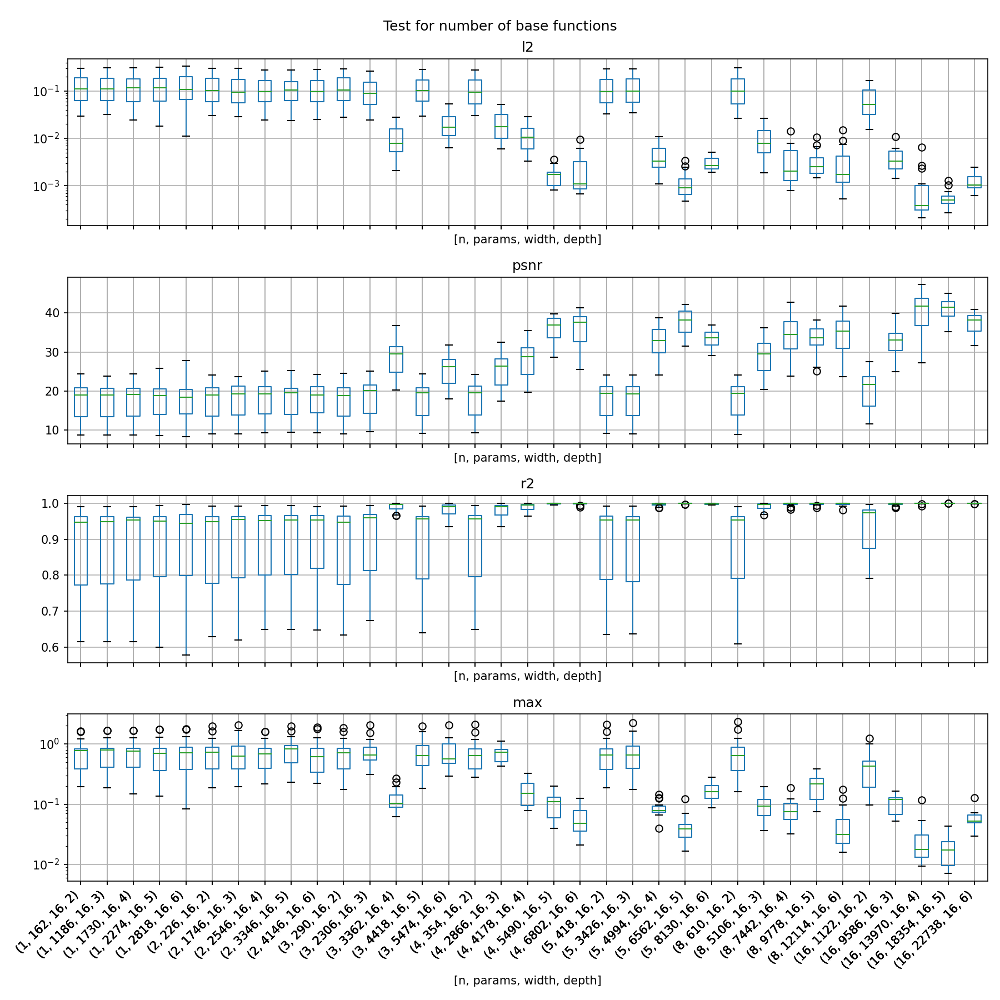

/tmp/ipykernel_202988/2425664662.py:9: UserWarning: When passing multiple axes, layout keyword is ignored.
  dataset.boxplot(column = ['l2', 'psnr', 'r2', 'max'], by = ['n','params','width','depth'], ax = axis, layout=(4,1),figsize=(18,12))
/tmp/ipykernel_202988/2425664662.py:9: UserWarning: When passing multiple axes, sharex and sharey are ignored. These settings must be specified when creating axes.
  dataset.boxplot(column = ['l2', 'psnr', 'r2', 'max'], by = ['n','params','width','depth'], ax = axis, layout=(4,1),figsize=(18,12))


In [44]:
dataset = pandas.DataFrame()
for trainedModel in models:
    df = getTestingLossFrame(trainedModel, testData, plot = False)
    dataset = pandas.concat([dataset, df])
display(dataset.groupby(['label']).mean(numeric_only = True))

fig, axis = plt.subplots(4,1, figsize=(12,12), sharex = True, sharey = False, squeeze = False)

dataset.boxplot(column = ['l2', 'psnr', 'r2', 'max'], by = ['n','params','width','depth'], ax = axis, layout=(4,1),figsize=(18,12))
# dataset.boxplot(column = ['l2', 'psnr', 'r2', 'max'], by = ['params'], ax = axis, layout=(4,1),figsize=(18,12))
# axis[0,0].set_xticks(axis[1,0].get_xticks(), axis[1,0].get_xticklabels(), rotation=45, ha='right')
axis[3,0].set_xticks(axis[3,0].get_xticks(), axis[3,0].get_xticklabels(), rotation=45, ha='right')
axis[0,0].set_yscale('log')
# axis[1,0].set_yscale('log')
axis[3,0].set_yscale('log')
fig.suptitle('Test for number of base functions')
fig.tight_layout()

,n,params,depth,width,r2,l2,psnr,min,max,q1,q3,std
label,,,,,,,,,,,,
"fourier x 1 @ [16, 16, 16, 16, 16, 1]",1.0,2818.0,6.0,16.0,0.866758,0.135689,17.548534,2.246528e-07,0.744215,0.021835,0.186251,0.170716
"fourier x 1 @ [16, 16, 16, 16, 1]",1.0,2274.0,5.0,16.0,0.867719,0.133922,17.582340,1.357756e-07,0.741408,0.021744,0.182241,0.169905
"fourier x 1 @ [16, 16, 16, 1]",1.0,1730.0,4.0,16.0,0.870918,0.131541,17.651016,2.215031e-07,0.739078,0.020158,0.180500,0.167106
"fourier x 1 @ [16, 16, 1]",1.0,1186.0,3.0,16.0,0.867567,0.134916,17.545863,1.146005e-07,0.739253,0.022040,0.183892,0.169940
"fourier x 1 @ [16, 1]",1.0,162.0,2.0,16.0,0.869800,0.133184,17.596151,1.586803e-07,0.730224,0.021607,0.183648,0.168140
"fourier x 2 @ [16, 16, 16, 16, 16, 1]",2.0,4146.0,6.0,16.0,0.999190,0.000850,39.821423,4.005443e-10,0.019076,0.000057,0.000886,0.001788
"fourier x 2 @ [16, 16, 16, 16, 1]",2.0,3346.0,5.0,16.0,0.999004,0.000968,39.438621,6.106678e-10,0.024759,0.000058,0.000959,0.002251
"fourier x 2 @ [16, 16, 16, 1]",2.0,2546.0,4.0,16.0,0.999038,0.000980,39.211341,4.601828e-10,0.023474,0.000061,0.001019,0.002150
"fourier x 2 @ [16, 16, 1]",2.0,1746.0,3.0,16.0,0.997856,0.001966,36.383333,2.108299e-09,0.058601,0.000109,0.001451,0.005321


<IPython.core.display.Javascript object>


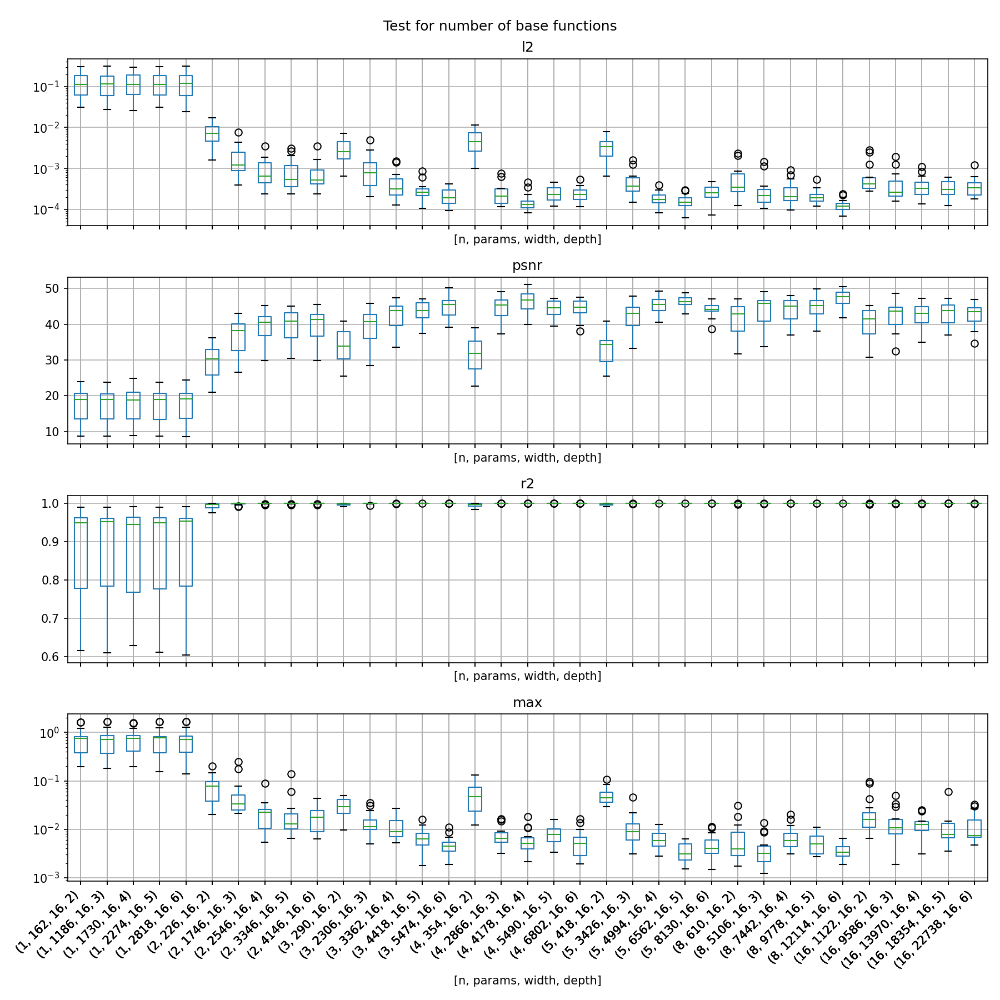

/tmp/ipykernel_202988/2425664662.py:9: UserWarning: When passing multiple axes, layout keyword is ignored.
  dataset.boxplot(column = ['l2', 'psnr', 'r2', 'max'], by = ['n','params','width','depth'], ax = axis, layout=(4,1),figsize=(18,12))
/tmp/ipykernel_202988/2425664662.py:9: UserWarning: When passing multiple axes, sharex and sharey are ignored. These settings must be specified when creating axes.
  dataset.boxplot(column = ['l2', 'psnr', 'r2', 'max'], by = ['n','params','width','depth'], ax = axis, layout=(4,1),figsize=(18,12))


In [42]:
dataset = pandas.DataFrame()
for trainedModel in models:
    df = getTestingLossFrame(trainedModel, testData, plot = False)
    dataset = pandas.concat([dataset, df])
display(dataset.groupby(['label']).mean(numeric_only = True))

fig, axis = plt.subplots(4,1, figsize=(12,12), sharex = True, sharey = False, squeeze = False)

dataset.boxplot(column = ['l2', 'psnr', 'r2', 'max'], by = ['n','params','width','depth'], ax = axis, layout=(4,1),figsize=(18,12))
# dataset.boxplot(column = ['l2', 'psnr', 'r2', 'max'], by = ['params'], ax = axis, layout=(4,1),figsize=(18,12))
# axis[0,0].set_xticks(axis[1,0].get_xticks(), axis[1,0].get_xticklabels(), rotation=45, ha='right')
axis[3,0].set_xticks(axis[3,0].get_xticks(), axis[3,0].get_xticklabels(), rotation=45, ha='right')
axis[0,0].set_yscale('log')
# axis[1,0].set_yscale('log')
axis[3,0].set_yscale('log')
fig.suptitle('Test for number of base functions')
fig.tight_layout()

,params,r2,l2,psnr,min,max,q1,q3,std
label,,,,,,,,,
"fourier x 1 @ [16, 16, 16, 1]",1730.0,0.861399,0.121055,16.359826,8.982784e-08,0.569938,0.015655,0.174128,0.146505
"fourier x 2 @ [16, 16, 16, 1]",2546.0,0.999100,0.000821,38.502220,3.001605e-10,0.013004,0.000084,0.001045,0.001285
"fourier x 3 @ [16, 16, 16, 1]",3362.0,0.999542,0.000433,41.403333,4.035574e-10,0.008908,0.000033,0.000443,0.000835
"fourier x 4 @ [16, 16, 16, 1]",4178.0,0.999722,0.000303,43.552836,5.936429e-11,0.007079,0.000017,0.000230,0.000705
"fourier x 5 @ [16, 16, 16, 1]",4994.0,0.999477,0.000500,40.998498,2.540853e-10,0.011390,0.000036,0.000562,0.000947
"fourier x 8 @ [16, 16, 16, 1]",7442.0,0.999683,0.000307,43.285029,2.195288e-10,0.007416,0.000021,0.000318,0.000598
"fourier x 16 @ [16, 16, 16, 1]",13970.0,0.999705,0.000303,42.752053,1.183473e-10,0.006504,0.000023,0.000362,0.000535


<IPython.core.display.Javascript object>


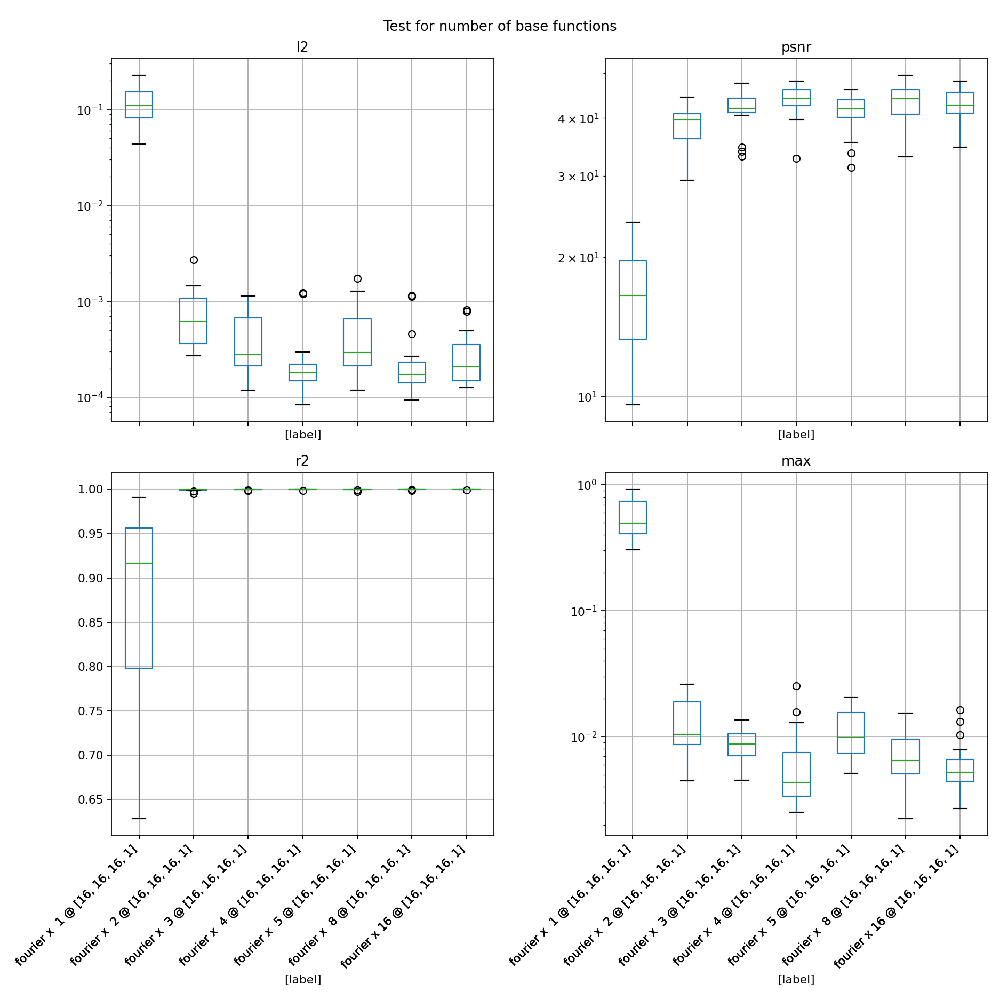

/tmp/ipykernel_619/3739864961.py:3: UserWarning: When passing multiple axes, layout keyword is ignored.
  totalData.boxplot(column = ['l2', 'psnr', 'r2', 'max'], by = ['label'], ax = axis, layout=(2,2),figsize=(12,12))
/tmp/ipykernel_619/3739864961.py:3: UserWarning: When passing multiple axes, sharex and sharey are ignored. These settings must be specified when creating axes.
  totalData.boxplot(column = ['l2', 'psnr', 'r2', 'max'], by = ['label'], ax = axis, layout=(2,2),figsize=(12,12))


<IPython.core.display.Javascript object>


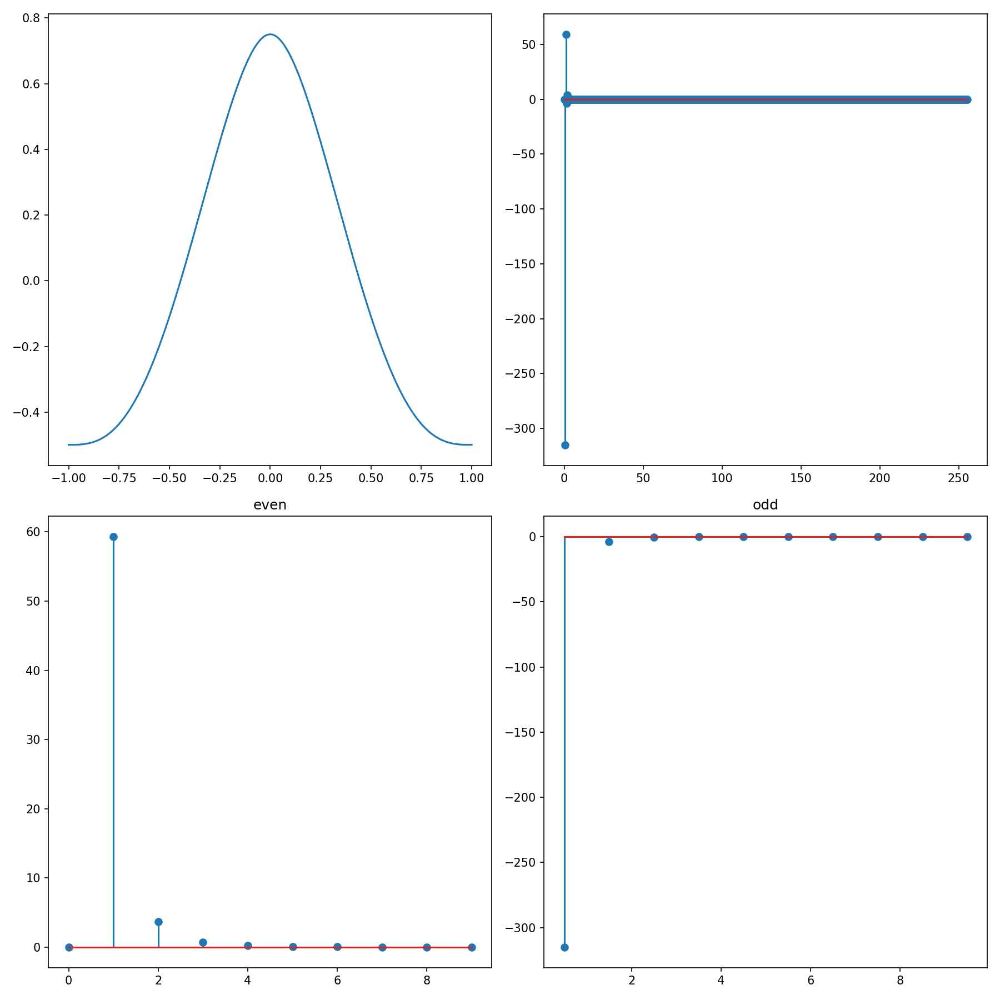

In [104]:
from numpy.fft import *

fx = lambda x: kernel(np.abs(x), 1)
# fx = lambda x: np.cos(x * np.pi)
x = np.linspace(-1,1,1023)
Y = fx(x)

fig, axis = plt.subplots(2,2, figsize=(12,12), sharex = False, sharey = False, squeeze = False)

fourier = rfft(Y - np.mean(Y))
n = len(Y)
timestep = 2 / n
freq = rfftfreq(n, d = timestep)

Y_k = fftshift(fft(Y - np.mean(Y)))
k = fftshift(fftfreq(len(Y)))


axis[0,0].plot(x,Y - np.mean(Y))

axis[0,1].stem(freq,fourier)
# axis[0,1].set_xscale('log')

axis[1,0].set_title('even')
axis[1,0].stem(freq[:20:2], fourier[:20:2])
axis[1,1].set_title('odd')
axis[1,1].stem(freq[1:20:2], fourier[1:20:2])

fig.tight_layout()

In [100]:
print(freq)

[  0.    0.5   1.    1.5   2.    2.5   3.    3.5   4.    4.5   5.    5.5
   6.    6.5   7.    7.5   8.    8.5   9.    9.5  10.   10.5  11.   11.5
  12.   12.5  13.   13.5  14.   14.5  15.   15.5  16.   16.5  17.   17.5
  18.   18.5  19.   19.5  20.   20.5  21.   21.5  22.   22.5  23.   23.5
  24.   24.5  25.   25.5  26.   26.5  27.   27.5  28.   28.5  29.   29.5
  30.   30.5  31.   31.5  32.   32.5  33.   33.5  34.   34.5  35.   35.5
  36.   36.5  37.   37.5  38.   38.5  39.   39.5  40.   40.5  41.   41.5
  42.   42.5  43.   43.5  44.   44.5  45.   45.5  46.   46.5  47.   47.5
  48.   48.5  49.   49.5  50.   50.5  51.   51.5  52.   52.5  53.   53.5
  54.   54.5  55.   55.5  56.   56.5  57.   57.5  58.   58.5  59.   59.5
  60.   60.5  61.   61.5  62.   62.5  63.   63.5  64.   64.5  65.   65.5
  66.   66.5  67.   67.5  68.   68.5  69.   69.5  70.   70.5  71.   71.5
  72.   72.5  73.   73.5  74.   74.5  75.   75.5  76.   76.5  77.   77.5
  78.   78.5  79.   79.5  80.   80.5  81.   81.5  8

In [212]:
totalData

,label,file,entry,params,r2,l2,psnr,min,max,q1,q3,std
0,"fourier x 1 @ [16, 16, 16, 1]",perlin_778030991,0,1730,0.673548,0.108647,12.535899,8.820606e-08,0.662982,0.006923,0.091369,0.176767
1,"fourier x 1 @ [16, 16, 16, 1]",perlin_778030991,1,1730,0.911366,0.099613,14.803907,9.010142e-08,0.452018,0.015787,0.132182,0.120403
2,"fourier x 1 @ [16, 16, 16, 1]",perlin_778030991,2,1730,0.839347,0.087493,15.211680,1.404084e-08,0.382198,0.016373,0.121194,0.094003
3,"fourier x 1 @ [16, 16, 16, 1]",perlin_778030991,3,1730,0.912167,0.048292,16.165241,2.513758e-08,0.303613,0.009692,0.050593,0.067070
4,"fourier x 1 @ [16, 16, 16, 1]",perlin_297699213,0,1730,0.648929,0.204711,10.878497,2.864484e-07,0.859421,0.044797,0.238153,0.233947
...,...,...,...,...,...,...,...,...,...,...,...,...
11,"fourier x 16 @ [16, 16, 16, 1]",perlin_873099211,3,13970,0.999903,0.000131,47.736695,4.259793e-11,0.002860,0.000010,0.000138,0.000269
12,"fourier x 16 @ [16, 16, 16, 1]",perlin_46852263,0,13970,0.998679,0.000811,34.556552,2.686740e-10,0.007870,0.000058,0.001187,0.001162
13,"fourier x 16 @ [16, 16, 16, 1]",perlin_46852263,1,13970,0.999938,0.000497,45.321384,5.798597e-10,0.016416,0.000042,0.000704,0.000855
14,"fourier x 16 @ [16, 16, 16, 1]",perlin_46852263,2,13970,0.999808,0.000434,42.977249,3.660752e-10,0.006000,0.000031,0.000478,0.000721


In [193]:
totalData = pandas.DataFrame()

In [194]:
df = getTestingLossFrame(trainedModel, testData, plot = False)

In [208]:
pandas.concat([totalData, df])

,label,file,entry,params,r2,l2,psnr,min,max,q1,q3,std
0,"fourier x 4 @ [32, 32, 32, 32, 1]",perlin_778030991,0,21218,0.999800,0.000066,44.667909,1.195133e-11,0.002828,0.000006,0.000086,0.000133
1,"fourier x 4 @ [32, 32, 32, 32, 1]",perlin_778030991,1,21218,0.999844,0.000175,42.348853,1.945466e-11,0.005499,0.000019,0.000203,0.000310
2,"fourier x 4 @ [32, 32, 32, 32, 1]",perlin_778030991,2,21218,0.999672,0.000178,42.117259,5.684342e-12,0.003941,0.000014,0.000222,0.000308
3,"fourier x 4 @ [32, 32, 32, 32, 1]",perlin_778030991,3,21218,0.999792,0.000115,42.411880,1.841727e-11,0.002514,0.000008,0.000124,0.000199
4,"fourier x 4 @ [32, 32, 32, 32, 1]",perlin_297699213,0,21218,0.999681,0.000186,41.297465,1.421085e-12,0.003914,0.000009,0.000143,0.000451
5,"fourier x 4 @ [32, 32, 32, 32, 1]",perlin_297699213,1,21218,0.999937,0.000206,46.006468,1.478497e-10,0.002808,0.000032,0.000291,0.000247
6,"fourier x 4 @ [32, 32, 32, 32, 1]",perlin_297699213,2,21218,0.999887,0.000160,45.345182,4.916387e-10,0.002369,0.000021,0.000235,0.000207
7,"fourier x 4 @ [32, 32, 32, 32, 1]",perlin_297699213,3,21218,0.999914,0.000155,47.321225,1.547562e-11,0.002023,0.000011,0.000202,0.000225
8,"fourier x 4 @ [32, 32, 32, 32, 1]",perlin_873099211,0,21218,0.999747,0.000152,41.009333,8.460574e-10,0.003046,0.000023,0.000165,0.000266
9,"fourier x 4 @ [32, 32, 32, 32, 1]",perlin_873099211,1,21218,0.999877,0.000151,44.067332,6.878054e-12,0.005630,0.000012,0.000171,0.000347


In [213]:
df.groupby(['label']).mean(numeric_only = True)
# fig, axis = plt.subplots(1,4, figsize=(8,4), sharex = False, sharey = False, squeeze = False)


# df.boxplot(column = ['r2', 'l2', 'max', 'psnr'], by = ['label'], ax = axis, layout=(1,4),figsize=(8,4))

# fig.tight_layout()


,params,r2,l2,psnr,min,max,q1,q3,std
label,,,,,,,,,
"fourier x 16 @ [16, 16, 16, 1]",13970.0,0.999705,0.000303,42.752044,1.258857e-10,0.006504,0.000023,0.000362,0.000535


In [112]:
modelState = trainedModel


In [113]:

#     with torch.no_grad():
#         for i, k in  enumerate(testData.keys()):
#             ax = axis['B']
#             if i == 0:
#                 ax = axis['B']
#             if i == 1:
#                 ax = axis['C']
#             if i == 2:
#                 ax = axis['G']
#             if i == 3:
#                 ax = axis['H']    
#             norm = mpl.colors.Normalize(vmin=0, vmax=len(testData[k][0]) - 1)
#             gt = testData[k][9].reshape(len(testData[k][0]), testData[k][0][0].shape[0])
#             for i, (xs, rhos) in enumerate(zip(testData[k][0], gt)):
#                 c = cmap(norm(i))
#                 ax.plot(xs.cpu().numpy(), rhos.cpu().numpy(), c = c)
#             prediction = modelState['model'](testData[k][5], testData[k][6], testData[k][7], testData[k][8]).reshape(len(testData[k][0]), testData[k][0][0].shape[0]).detach().cpu().numpy()
#             for i, (xs, rhos) in enumerate(zip(testData[k][0], prediction)):
#                 c = cmap(norm(i))
#                 ax.plot(xs.cpu().numpy(), rhos, ls = '--', c = c)

In [154]:
print('%s x %2d @ %s' % (modelState['basis'], modelState['n'], str(modelState['layers'])))

fourier x  4 @ [16, 32, 32, 16, 1]


<IPython.core.display.Javascript object>


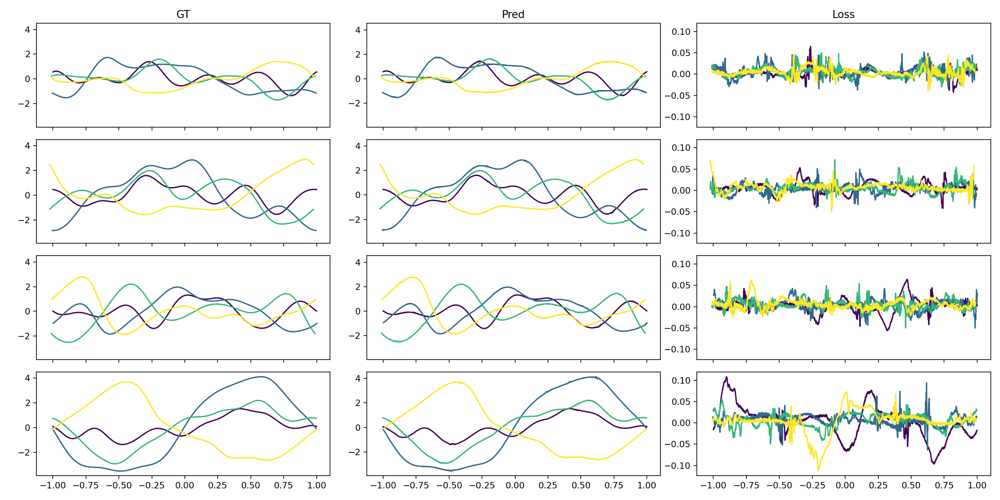

In [150]:
df = pandas.DataFrame(data = lossDict)
df
# fig, axis = plt.subplots(1,1, figsize=(8,4), sharex = False, sharey = False, squeeze = False)

# fig.tight_layout()

,r2,l2,psnr,min,max,q1,q3,std
0,0.999683,0.000106,42.657999,7.517542e-12,0.004266,0.000007,0.000100,0.000265
1,0.999820,0.000202,41.731274,2.589928e-10,0.002715,0.000016,0.000255,0.000324
2,0.999756,0.000133,43.393218,4.456524e-11,0.002500,0.000016,0.000156,0.000222
3,0.999775,0.000124,42.077339,6.963319e-11,0.002275,0.000007,0.000114,0.000239
4,0.999650,0.000204,40.894347,4.058762e-10,0.002850,0.000028,0.000206,0.000340
5,0.999953,0.000154,47.273895,2.751221e-11,0.002624,0.000013,0.000206,0.000247
6,0.999897,0.000145,45.782044,1.688392e-10,0.005127,0.000012,0.000153,0.000309
7,0.999907,0.000167,46.980776,1.365663e-11,0.004832,0.000017,0.000182,0.000359
8,0.999501,0.000300,38.050233,1.406910e-10,0.004147,0.000014,0.000230,0.000620
9,0.999870,0.000159,43.833022,2.383196e-10,0.002520,0.000019,0.000176,0.000270


In [96]:
testPredictions['perlin_778030991'].shape

(4, 2048)

In [ ]:
    positions, velocities, areas, dudts, density, inputVelocity, outputVelocity, setup = loadBatch(trainingData, settings, dataSet, bdata, device, offset)
    i, j, distance, direction = batchedNeighborsearch(positions, setup)
    x, u, v, rho, dudt, inVel, outVel = flatten(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity)

    x = x[:,None].to(device)    
    groundTruth = groundTruthFn(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity).to(device)
    distance = (distance * direction)[:,None].to(device)
    features = featureFn(x, u, v, rho, dudt, inVel, outVel).to(device)
    
    with torch.no_grad():
        prediction = modelState['model'](features.to(device), i.to(device), j.to(device), distance.to(device))[:,0]
  

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


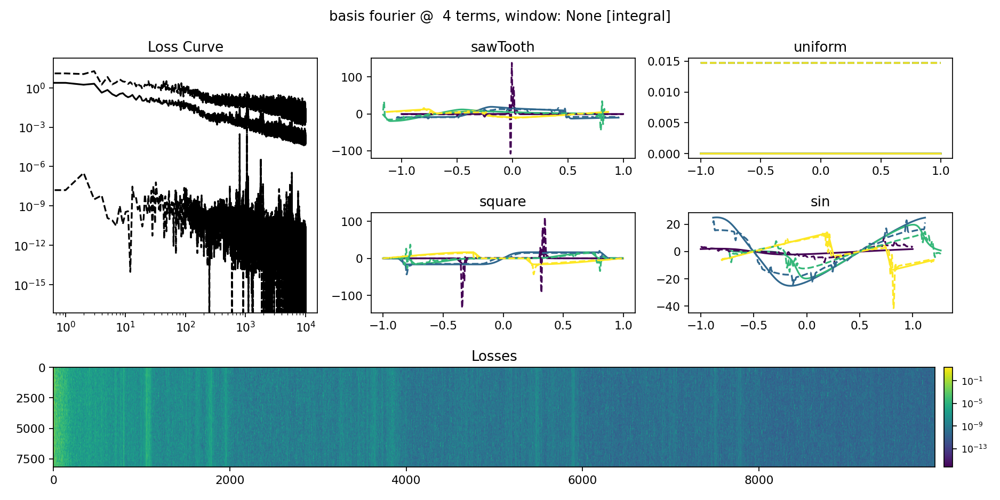

<IPython.core.display.Javascript object>


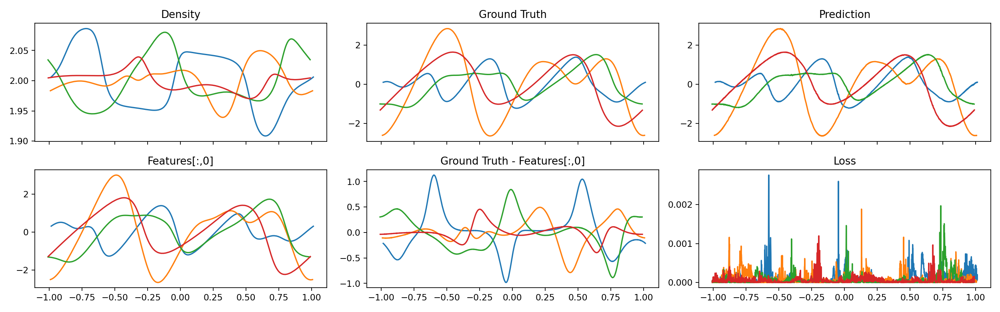

In [30]:
basis = 'fourier'
n = 4
trainedModel = trainModel(particleData, testData, settings, dataSet, trainingFiles, fluidFeatures = 3, offset = offset,
                          n = n, basis = basis, layers = [16,32,32,16,1],
                         window = window, windowNorm = windowNorm,
                         epochs = 5, iterations = 2000, initialLR = 1e-3, device = device, testInterval = 10,
                         groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)
plotModel(trainedModel, testData, device, baseArea, particleSupport)
plotTrainedBatch(trainingData, settings, dataSet, bdata, device, offset, trainedModel, groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)

<IPython.core.display.Javascript object>


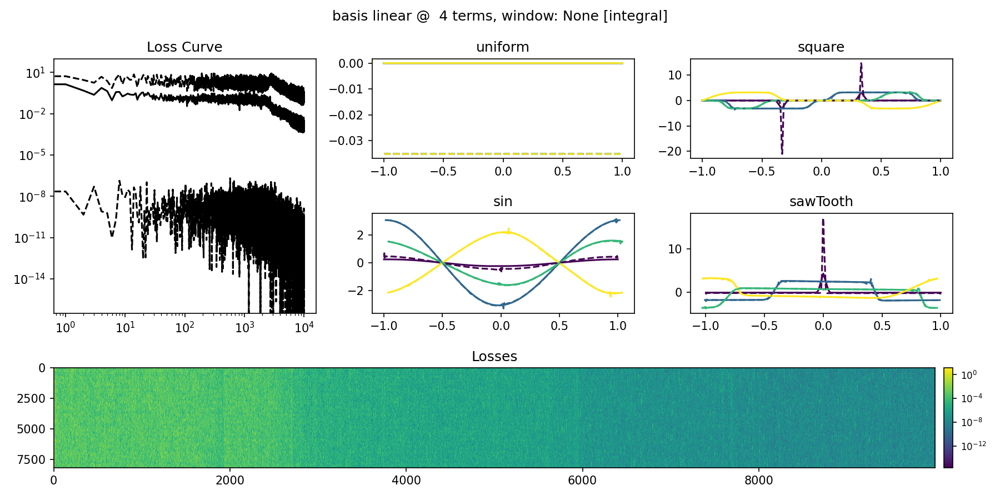

In [99]:
plotModel(trainedModel, testData, device, baseArea, particleSupport)

<IPython.core.display.Javascript object>


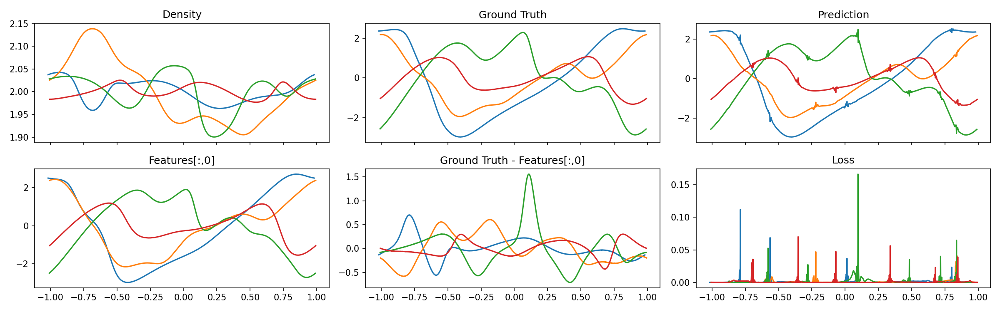

In [100]:
plotTrainedBatch(trainingData, settings, dataSet, bdata, device, offset, trainedModel, groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)

<IPython.core.display.Javascript object>


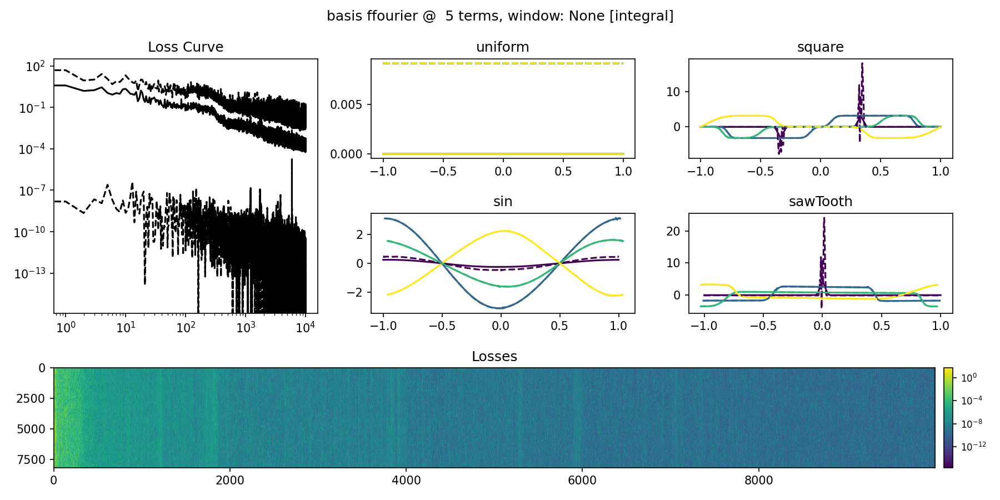

In [85]:
plotModel(trainedModel, testData, device, baseArea, particleSupport)

<IPython.core.display.Javascript object>


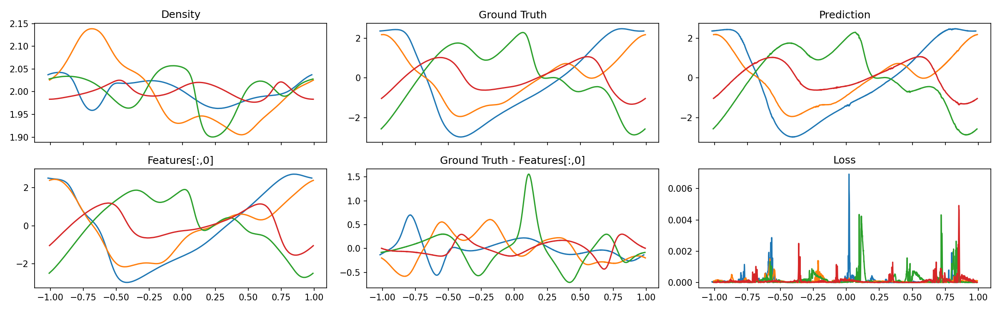

In [86]:
plotTrainedBatch(trainingData, settings, dataSet, bdata, device, offset, trainedModel, groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)

<IPython.core.display.Javascript object>


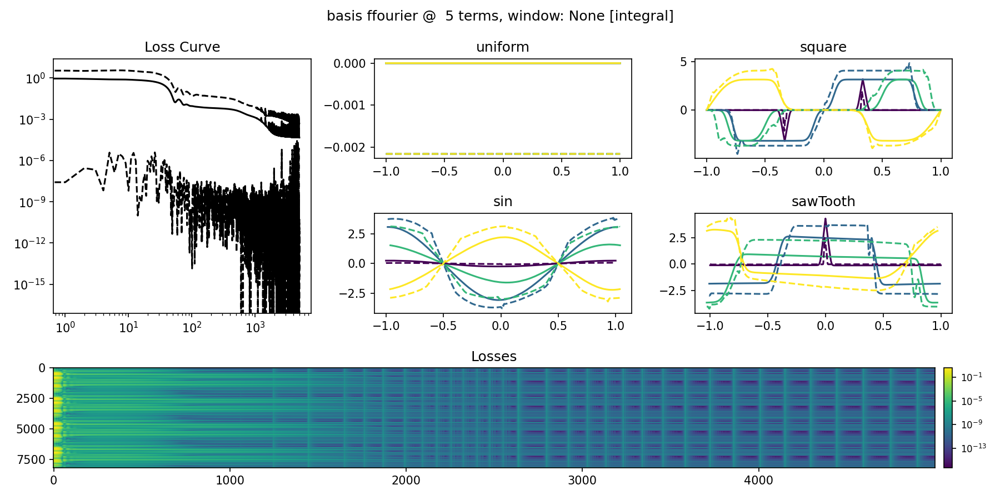

In [80]:
plotModel(trainedModel, testData, device, baseArea, particleSupport)

<IPython.core.display.Javascript object>


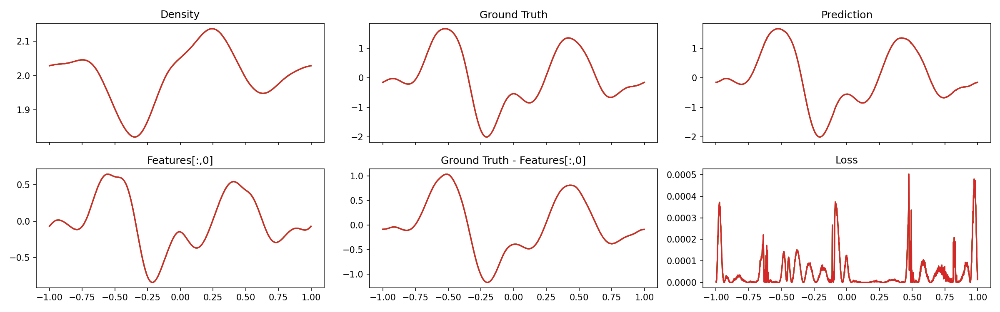

In [81]:
plotTrainedBatch(trainingData, settings, dataSet, bdata, device, offset, trainedModel, groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)

<IPython.core.display.Javascript object>


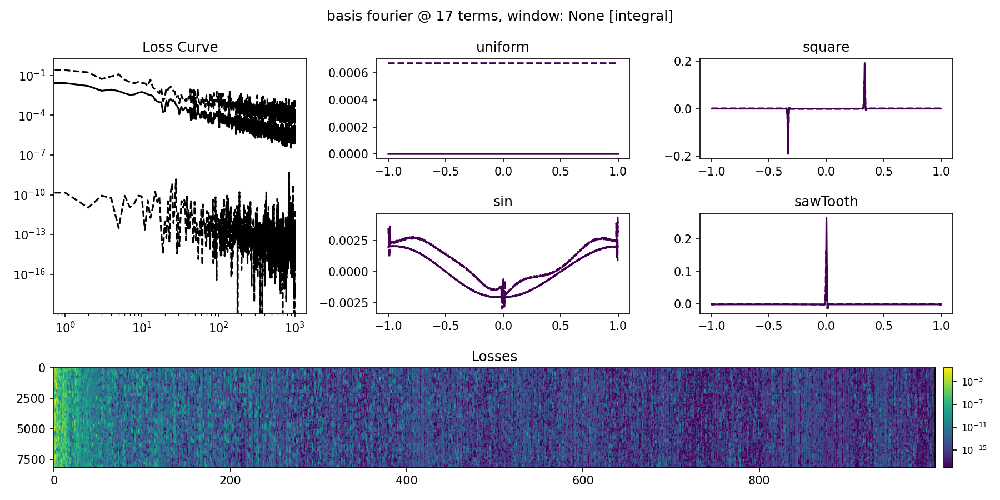

In [188]:
plotModel(trainedModel, testData, device, baseArea, particleSupport)

<IPython.core.display.Javascript object>


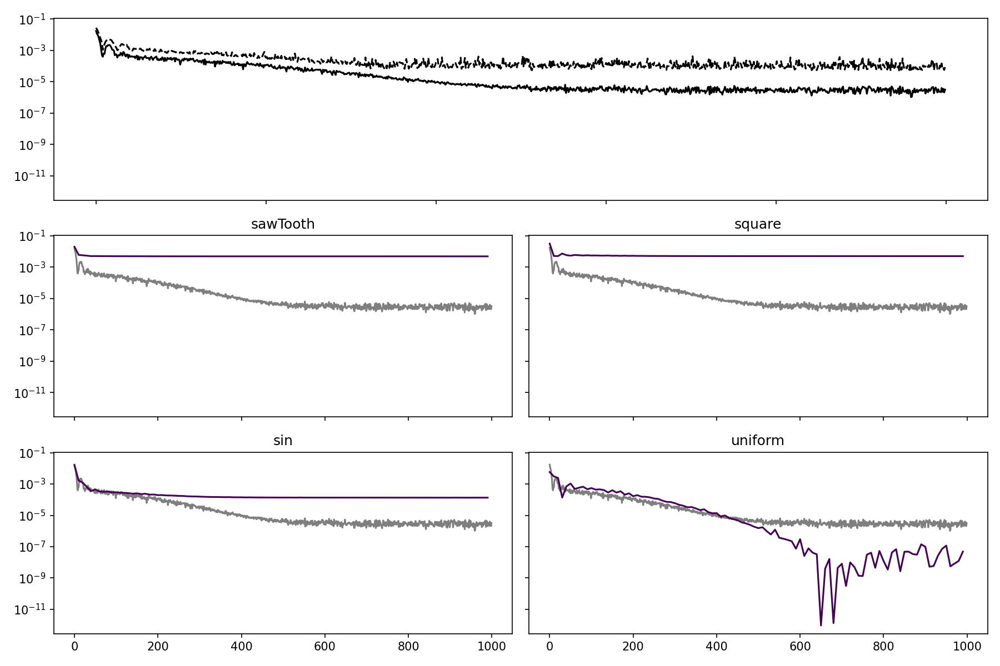

In [26]:
plotLosses(trainedModel, testData)

<IPython.core.display.Javascript object>


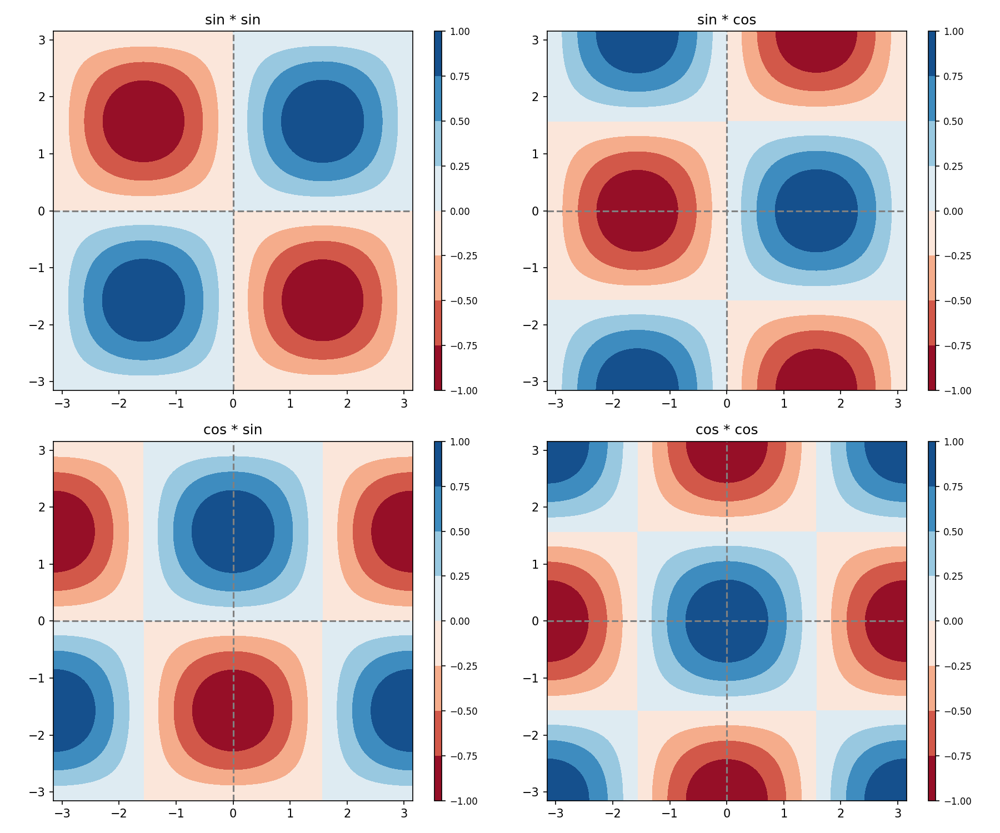

In [118]:
x = np.linspace(-np.pi,np.pi,255)
y = np.linspace(-np.pi,np.pi,255)
xx,yy = np.meshgrid(x,y)

XX = xx.flatten()
YY = yy.flatten()

# zz = xx**2 + yy**2
ZZ1 = (np.sin(xx) * np.sin(yy)).reshape(xx.shape)
ZZ2 = (np.sin(xx) * np.cos(yy)).reshape(xx.shape)
ZZ3 = (np.cos(xx) * np.sin(yy)).reshape(xx.shape)
ZZ4 = (np.cos(xx) * np.cos(yy)).reshape(xx.shape)
# print(zz - ZZ)

fig, axis = plt.subplots(2,2, figsize=(12,10), sharex = False, sharey = False, squeeze = False)

def plotCf(fig, axis, xx,yy,zz, title, cmap = 'RdBu'):
    im = axis.pcolor(xx,yy,zz, cmap = cmap)
    im = axis.contourf(xx,yy,zz, cmap = cmap)
    axis.axis('equal')
    ax1_divider = make_axes_locatable(axis)
    cax1 = ax1_divider.append_axes("right", size="2%", pad="6%")
    cb1 = fig.colorbar(im, cax=cax1,orientation='vertical')
    cb1.ax.tick_params(labelsize=8) 
    axis.axhline(0, ls = '--', c = 'grey') 
    axis.axvline(0, ls = '--', c = 'grey')
    axis.set_title(title)

plotCf(fig, axis[0,0], xx, yy, ZZ1, 'sin * sin')
plotCf(fig, axis[0,1], xx, yy, ZZ2, 'sin * cos')
plotCf(fig, axis[1,0], xx, yy, ZZ3, 'cos * sin')
plotCf(fig, axis[1,1], xx, yy, ZZ4, 'cos * cos')

fig.tight_layout()
# axis[0,0].contourf(xx,yy,xx**2 + yy**2)

<IPython.core.display.Javascript object>


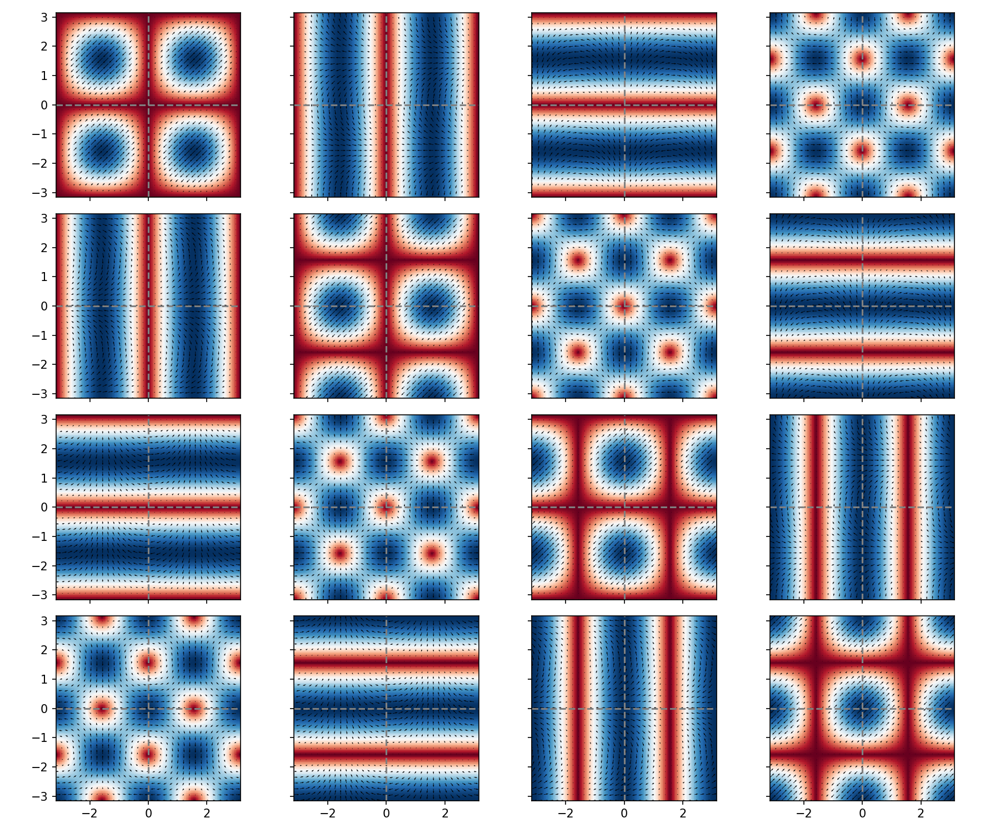

In [141]:

fig, axis = plt.subplots(4,4, figsize=(12,10), sharex = True, sharey = True, squeeze = False)

def plotQuiver(fig, axis, xx,yy,zz1,zz2, title, cmap = 'RdBu'):
    im = axis.pcolor(xx,yy,np.linalg.norm(np.stack((zz1, zz2), axis = -1), axis = -1), cmap = cmap)
#     im = axis.contourf(xx,yy,zz, cmap = cmap)
    axis.quiver(xx[::8,::8],yy[::8,::8],zz1[::8,::8],zz2[::8,::8])
    axis.set_aspect(1)
#     ax1_divider = make_axes_locatable(axis)
#     cax1 = ax1_divider.append_axes("right", size="2%", pad="6%")
#     cb1 = fig.colorbar(im, cax=cax1,orientation='vertical')
#     cb1.ax.tick_params(labelsize=8) 
    axis.axhline(0, ls = '--', c = 'grey') 
    axis.axvline(0, ls = '--', c = 'grey')
#     axis.set_title(title)

zs = [ZZ1, ZZ2, ZZ3, ZZ4]
for i in range(len(zs)):
    for j in range(len(zs)):
        plotQuiver(fig, axis[i,j], xx, yy, zs[i], zs[j], 'sin * sin')
# plotCf(fig, axis[0,1], xx, yy, ZZ2, 'sin * cos')
# plotCf(fig, axis[1,0], xx, yy, ZZ3, 'cos * sin')
# plotCf(fig, axis[1,1], xx, yy, ZZ4, 'cos * cos')

fig.tight_layout()

In [133]:
np.linalg.norm(np.stack((ZZ1, ZZ1), axis = -1), axis = -1)

array([[2.12098062e-32, 4.28378542e-18, 8.56494965e-18, ...,
        8.56494965e-18, 4.28378542e-18, 2.12098062e-32],
       [4.28378542e-18, 8.65204392e-04, 1.72987938e-03, ...,
        1.72987938e-03, 8.65204392e-04, 4.28378542e-18],
       [8.56494965e-18, 1.72987938e-03, 3.45870027e-03, ...,
        3.45870027e-03, 1.72987938e-03, 8.56494965e-18],
       ...,
       [8.56494965e-18, 1.72987938e-03, 3.45870027e-03, ...,
        3.45870027e-03, 1.72987938e-03, 8.56494965e-18],
       [4.28378542e-18, 8.65204392e-04, 1.72987938e-03, ...,
        1.72987938e-03, 8.65204392e-04, 4.28378542e-18],
       [2.12098062e-32, 4.28378542e-18, 8.56494965e-18, ...,
        8.56494965e-18, 4.28378542e-18, 2.12098062e-32]])

In [121]:
print(xx.shape)

(255, 255)


In [57]:
models = []
nMax = 32
for i in tqdm(range(1,nMax + 1)):
    trainedModel = trainModel(particleData, testData, settings, dataSet, trainingFiles,
                          n = i, basis = basis, layers = layers,
                         window = window, windowNorm = windowNorm,
                         epochs = epochs, iterations = 1000, initialLR = 1e-2, device = device, testInterval = 10,
                         groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)
    models.append(trainedModel)
#     break

  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


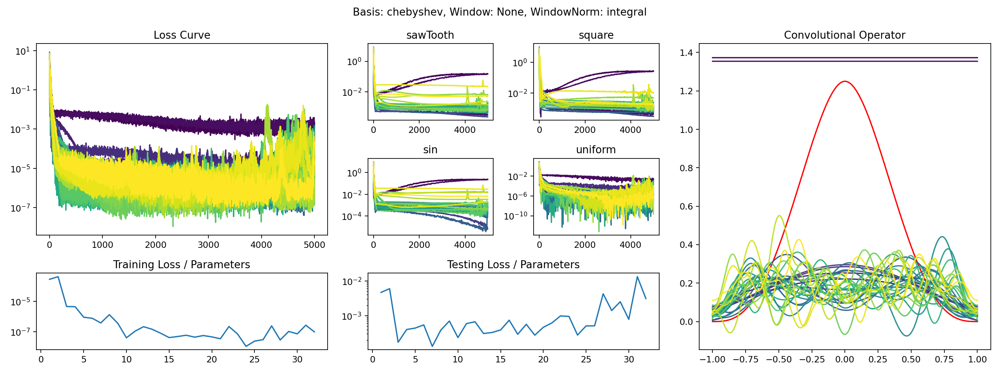

In [51]:
plotModelset2(models, testData, device,nMax)

<IPython.core.display.Javascript object>


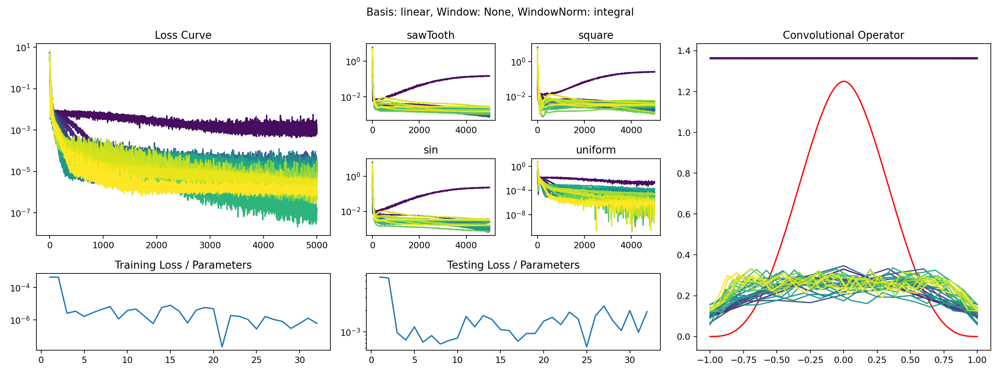

In [58]:
plotModelset2(models, testData, device,nMax)

<IPython.core.display.Javascript object>


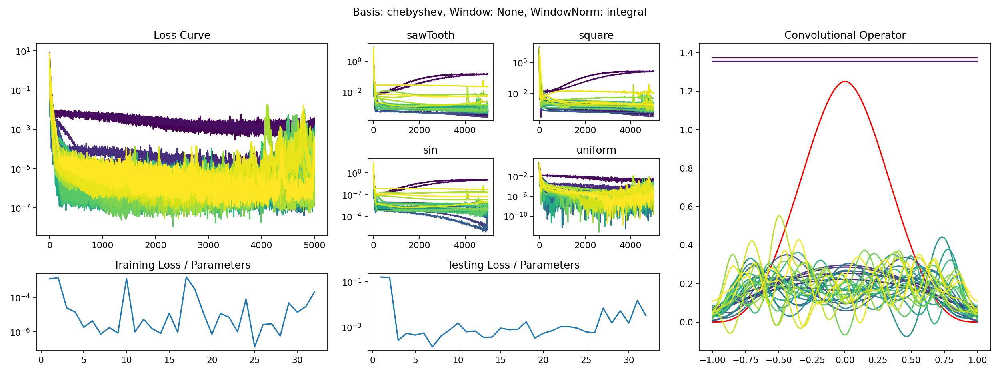

In [47]:
plotModelset2(models, testData, device,nMax)

In [26]:
plotModelset(models, device)

NameError: name 'plotModelset' is not defined

<IPython.core.display.Javascript object>


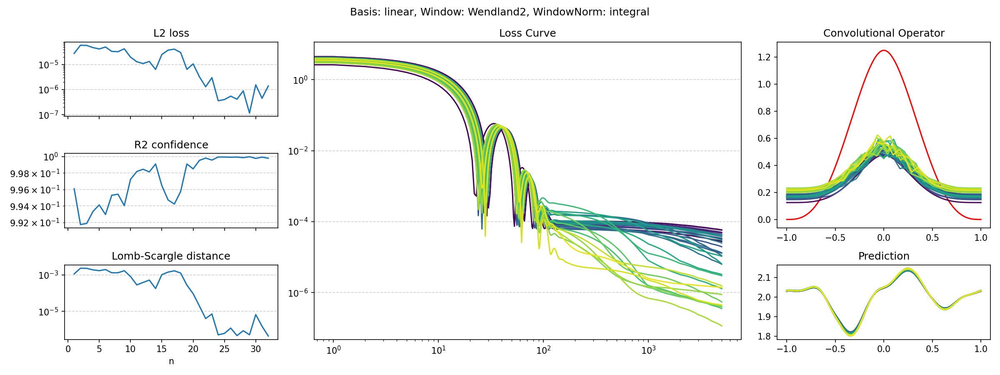

In [29]:
fig, axis = plt.subplot_mosaic('''ABE
CBE
DBF''', figsize=(16,6), sharex = False, width_ratios=[1,2,1])
fig.canvas.draw()
fig.canvas.flush_events()

if not os.path.exists('./images/'):
    os.makedirs('./images/')    
    
basii = ['linear', 'chebyshev', 'fourier', 'rbf cubic_spline', 'abf cubic_spline', 'ubf cubic_spline', 'rbf wendland2', 'rbf square']
windows = [None, 'cubicSpline', 'Wendland2', 'Spiky', 'Linear']

In [ ]:
for basis in tqdm(basii):
    for window in tqdm(windows, leave = False):
        models = []
        for i in tqdm(range(1,32 + 1), leave = False):
            trainedModel = trainModel(particleData, settings, dataSet, trainingFiles,
                                      n = i, basis = basis, layers = [1],
                                 window = window, windowNorm = windowNorm,
                                 epochs = 5, iterations = 1000, initialLR = 1e-2, device = device,
                                 groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)
            models.append(trainedModel)
        plotModelsetInteractive(fig, axis, models, device)
        fig.canvas.draw()
        fig.canvas.flush_events()
        fig.savefig('./images/%s_%s_%s.png' % (basis, models[0]['window'] if models[0]['window'] is not None else 'None', models[0]['windowNorm'] if models[0]['windowNorm'] is not None and window is not None else 'None'))
#         print(basis, window)
#         break
#     break

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


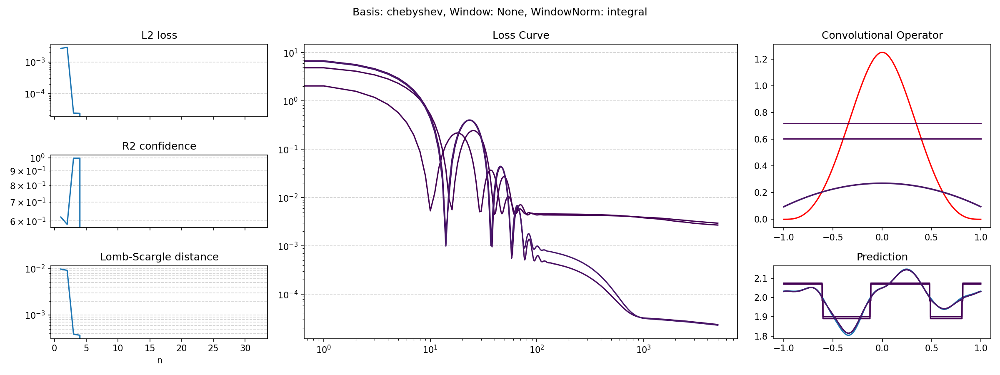

<IPython.core.display.Javascript object>


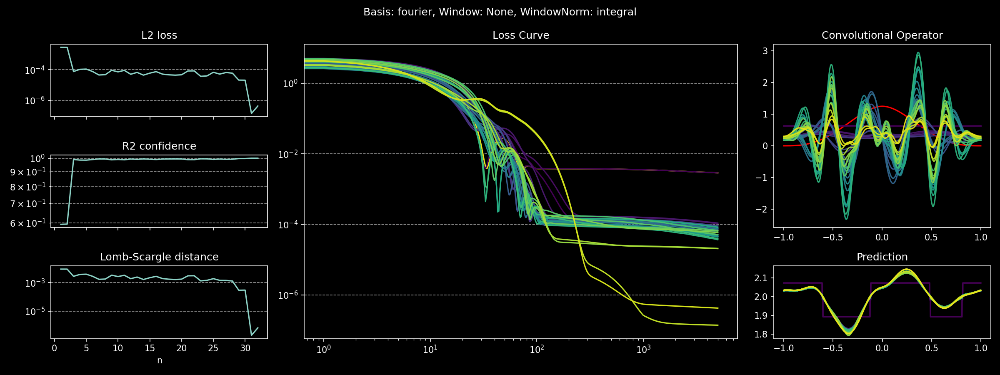

In [129]:
plotModelset(models)

   6.101


<IPython.core.display.Javascript object>


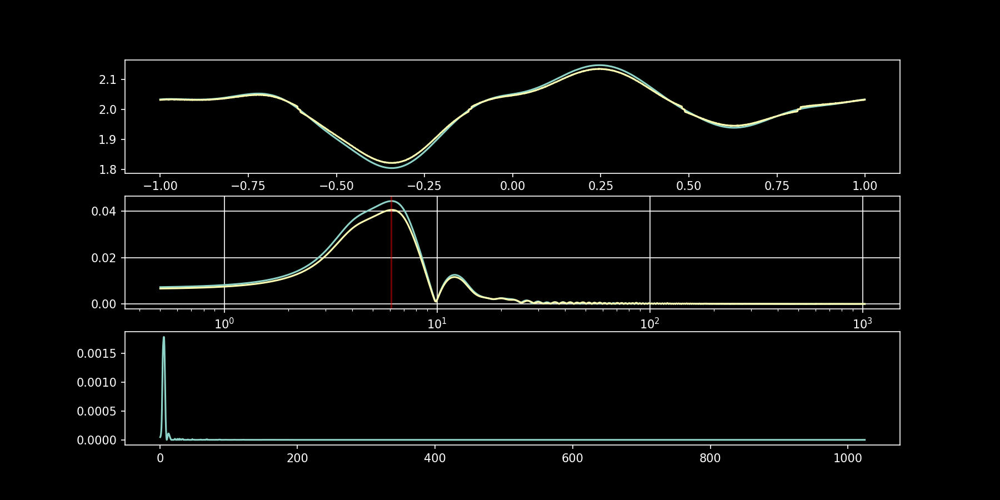

In [46]:
from scipy.signal import lombscargle

x = trainedModel['x'][:,0].numpy()
y = trainedModel['gt'].numpy()
# y = trainedModel['predictions'][-1].numpy()

dxmin = np.diff(x).min()
duration = x.ptp()
x.shape[0]
freqs = np.linspace(1/duration, x.shape[0]/duration, 5*x.shape[0])
periodogram = lombscargle(x, y - np.mean(y), freqs, normalize = False, precenter = True)
periodograma = lombscargle(x, y - np.mean(y), freqs)

kmax = periodogram.argmax()
print("%8.3f" % (freqs[kmax],))

fig, axis = plt.subplots(3, 1, figsize=(12,6), sharex = False, sharey = False, squeeze = False)

axis[0,0].plot(x, y)

axis[1,0].semilogx(freqs, np.sqrt(4*periodogram/(5*x.shape[0])))
axis[1,0].set_xlabel('Frequency (rad/s)')
axis[1,0].grid()
axis[1,0].axvline(freqs[kmax], color='r', alpha=0.25)


y2 = trainedModel['predictions'][-1].numpy()

dxmin = np.diff(x).min()
duration = x.ptp()
freqs = np.linspace(1/duration, x.shape[0]/duration, 5*x.shape[0])
periodogram = lombscargle(x, y2 - np.mean(y), freqs, normalize = False, precenter = True)
periodogramb = lombscargle(x, y2 - np.mean(y), freqs)
axis[0,0].plot(x, y2)
axis[1,0].plot(freqs, np.sqrt(4*periodogram/(5*x.shape[0])))
axis[1,0].axvline(freqs[kmax], color='r', alpha=0.25)

axis[2,0].plot(freqs, (np.sqrt(4*periodograma/(5*n)) - np.sqrt(4*periodogramb/(5*n)))**2)

plt.show()

In [31]:

windowFn = getWindowFunction(window, norm = windowNorm) if window is not None else None


In [32]:
# Setup a single layer neural network using the RbfConv class

    
model = RbfNet(fluidFeatures = 1, 
               layers = [1], 
               denseLayer = True, activation = 'ReLU', coordinateMapping = 'cartesian', 
               n = n, windowFn = windowFn, rbf = basis, batchSize = computeBatchSize, ignoreCenter = True, normalized = False).to(device)

# model = RbfNet(fluidFeatures = 1, 
#                layers = [1], 
#                denseLayer = True, activation = 'ReLU', coordinateMapping = 'cartesian', 
#                n = n, windowFn = None, rbf = basis, batchSize = computeBatchSize, ignoreCenter = True, normalized = False).to(device)

print('Network has', count_parameters(model), 'parameters')
# Create optimizer for the network
optimizer = Adam(model.parameters(), lr=lr, weight_decay=0)



Network has 18 parameters


In [33]:

# i, j, distance, direction = batchedNeighborsearch(positions, setup)
# x, u, v, dudt = flatten(positions, velocities, density, dudts)
# x = x[:,None]

In [34]:
lr = 1e-2
optimizer.zero_grad()
positions, velocities, areas, dudts, density, setup = loadFrames(particleData, settings, dataSet, trainingFiles[0], 0 + np.arange(1), device)
#                 positions, velocities, areas, dudts, setup = loadBatch(particleData, settings, dataSet, bdata, device)

i, j, distance, direction = batchedNeighborsearch(positions, setup)
x, u, v, rho, dudt = flatten(positions, velocities, areas, density, dudts)

x = x[:,None].to(device)
groundTruth = getGroundTruth(positions, velocities, areas, density, dudts).to(device)
distance = (distance * direction)[:,None].to(device)
features = getFeatures(x, u, v, rho, dudt).to(device)

predictions = []
losses = []
for e in (pb := tqdm(range(epochs))):
    for b in (pbl := tqdm(range(iterations), leave=False)):
        optimizer.zero_grad()
        prediction = model(features.to(device), i.to(device), j.to(device), distance.to(device))[:,0]
        lossTerm = lossFunction(prediction, groundTruth)
        loss = torch.mean(lossTerm)

    #     print(prediction)
    #     print(groundTruth)
    #     print(lossTerm)

        loss.backward()
        optimizer.step()
        predictions.append(prediction.detach().cpu())
        losses.append(lossTerm.detach().cpu())
        pbl.set_description('%8s[gpu %d]: %3d [%1d] @ %1.1e: :  %s -> %.2e' %('overfitting', 0, 0, 0, lr, '0', loss.detach().cpu().numpy()))
    
#     break
    if True: #epoch % 1 == 0 and epoch > 0:
        lr = lr * 0.95
        for param_group in optimizer.param_groups:
            param_group['lr'] = 0.5 * param_group['lr']
# store the losses for later processing
# losses.append(lossTerm.detach().cpu().numpy())

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

In [35]:
print(features)

tensor([[1.],
        [1.],
        [1.],
        ...,
        [1.],
        [1.],
        [1.]])


In [36]:
print(prediction)

tensor([2.0315, 2.0318, 2.0319,  ..., 2.0315, 2.0315, 2.0320],
       grad_fn=<SelectBackward0>)


In [37]:
print(groundTruth)

tensor([2.0329, 2.0330, 2.0331,  ..., 2.0326, 2.0327, 2.0328])


<IPython.core.display.Javascript object>


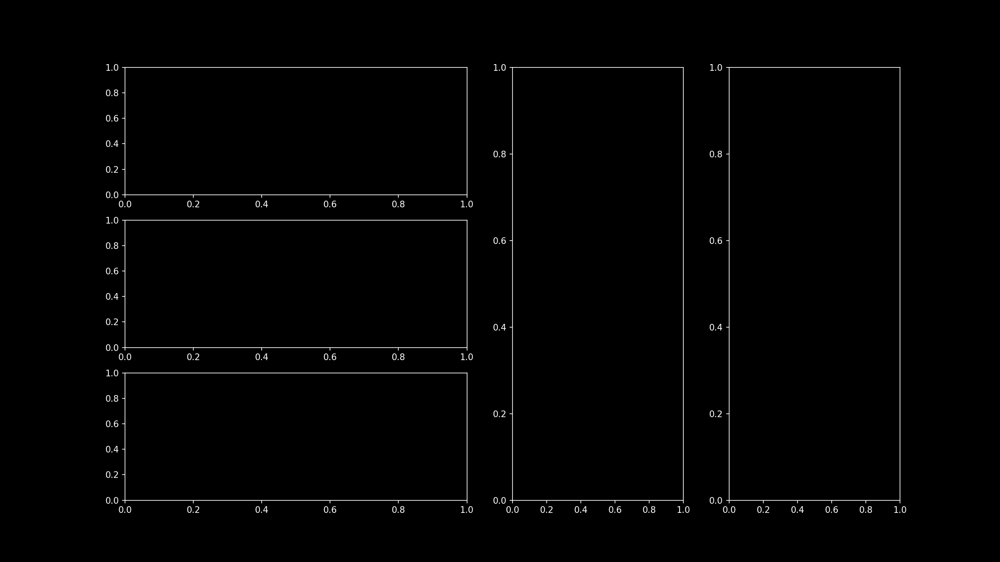

KeyError: 'groundTruths'

<IPython.core.display.Javascript object>


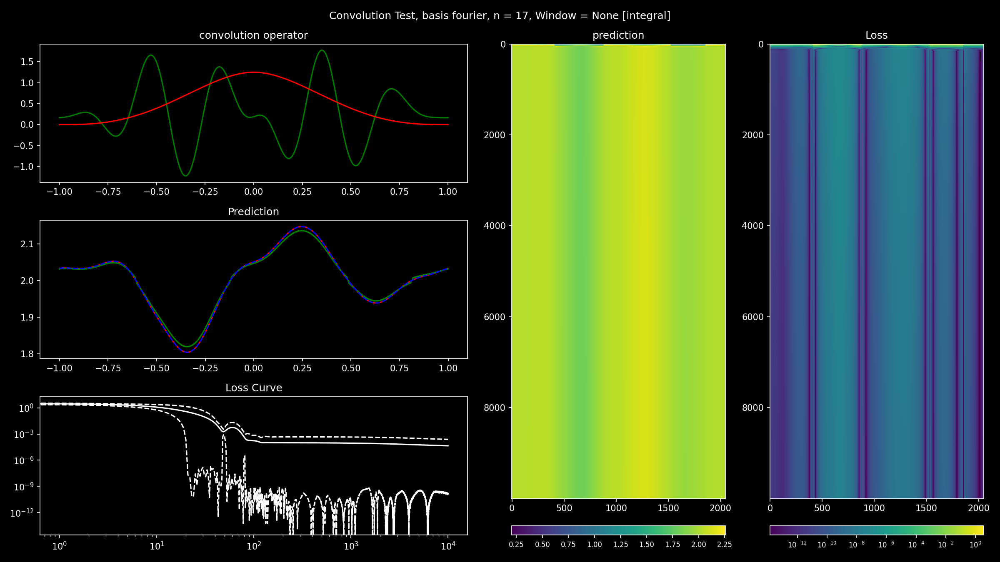

In [41]:
fig, axis = plt.subplot_mosaic('''DBC
ABC
EBC''', figsize=(16,9), sharex = False, width_ratios=[2,1,1])

def plot(fig, axis, mat, title, cmap = 'viridis', norm = 'linear'):
    im = axis.imshow(mat, cmap = cmap, norm = norm)
    axis.axis('auto')
    ax1_divider = make_axes_locatable(axis)
    cax1 = ax1_divider.append_axes("bottom", size="2%", pad="6%")
    cb1 = fig.colorbar(im, cax=cax1,orientation='horizontal')
    cb1.ax.tick_params(labelsize=8) 
    axis.set_title(title)
    
axis['A'].plot(x[:,0], groundTruth.detach().cpu().numpy(), c = 'red')
ll = np.logspace(1, np.log10(iterations * epochs + 1), num = 100)
norm = LogNorm(vmin=1, vmax=iterations * epochs + 1)
    
axis['A'].plot(x[:,0], predictions[-1][:], c = 'green')
s = scatter_sum(baseArea * kernel(torch.abs(distance[:,0]), particleSupport), i, dim = 0, dim_size = x.shape[0])
axis['A'].plot(x[:,0], s, c = 'blue', ls = '--')
    
    
plot(fig, axis['B'], torch.vstack(predictions)[:,:], title = 'prediction', norm = 'linear')
plot(fig, axis['C'], torch.vstack(losses)[:,:], title = 'Loss', norm = 'log')

xSynthetic, featuresSynthetic, iSynthetic, jSynthetic = generateSyntheticData(511, device)

steps = iterations * epochs
ls = np.logspace(0, np.log10(steps), num =  50)
ls = [int(np.floor(f)) for f in ls]
ls = np.unique(ls).tolist()

axis['D'].plot(xSynthetic[:,0].detach().cpu().numpy(), model(featuresSynthetic, iSynthetic, jSynthetic, xSynthetic).detach().cpu().numpy(),ls='-',c= 'green', alpha = 0.95)
axis['D'].plot(xSynthetic[:,0].detach().cpu().numpy(), kernel(torch.abs(xSynthetic), 1).detach().cpu().numpy(), c = 'red')

axis['D'].set_title('convolution operator')
axis['A'].set_title('Prediction')

axis['E'].loglog(torch.mean(torch.vstack(losses), dim = 1), ls = '-', c = 'white')
axis['E'].loglog(torch.min(torch.vstack(losses), dim = 1)[0], ls = '--', c = 'white')
axis['E'].loglog(torch.max(torch.vstack(losses), dim = 1)[0], ls = '--', c = 'white')
axis['E'].set_title('Loss Curve')
fig.suptitle('Convolution Test, basis %s, n = %2d, Window = %s [%s]' % (basis, n, window if window is not None else 'None', windowNorm if windowNorm is not None else 'None'))

fig.tight_layout()

In [85]:
torch.min(torch.linalg.norm(distance, axis = 1))

tensor(0.)

In [118]:
from tqdm.notebook import tqdm

In [119]:
pb = tqdm(range(epochs * iterations))
epoch = 0
b, l, w = processDataLoaderIter(pb, iterations, epoch, lr, \
                                dataLoader, dataIter, batchSize, model, optimizer, \
                                particleData, settings, dataSet, \
                                lossFunction, getFeatures, getGroundTruth, None,\
                                train = True, prefix = '', augmentAngle = False, augmentJitter = False, jitterAmount = 0.01)

  0%|          | 0/5000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [113]:
testFile = trainingFiles[2]
testFrame = 0
unrollLength = 32



positions, velocities, areas, dudts, densities, setup = loadFrames(particleData, settings, dataSet, testFile, testFrame + np.arange(unrollLength), device)

i, j, distance, direction = batchedNeighborsearch(positions, setup)
x, u, v, dudt = flatten(positions, velocities, areas, dudts)
x = x[:,None]
distance = distance[:,None]
features = torch.vstack((u, torch.ones_like(v))).mT

In [115]:
predictions = []
with torch.no_grad():
    for i in range(unrollLength):
        predictions.append(modelStep([positions[i]], [velocities[i]], [densities[i]], setup).cpu())
predictions = torch.vstack(predictions)

<IPython.core.display.Javascript object>


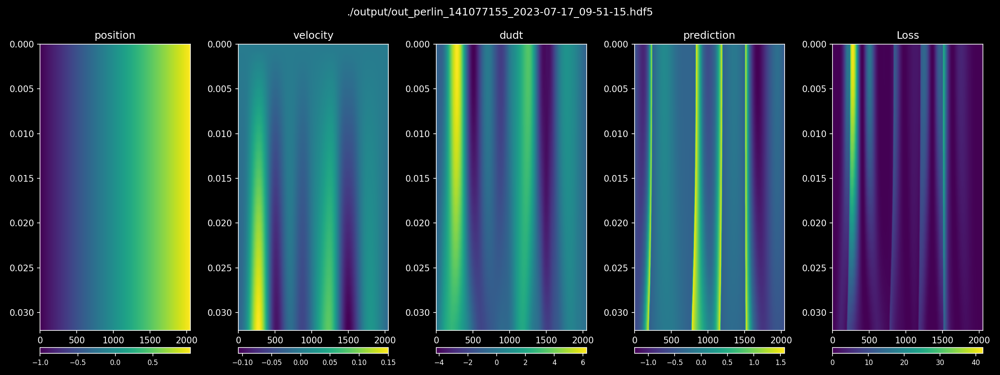

In [116]:

fig, axis = plt.subplots(1, 5, figsize=(16,6), sharex = False, sharey = False, squeeze = False)

def plot(fig, axis, mat, title, cmap = 'viridis'):
    im = axis.imshow(mat, extent = [0,numParticles,dt * (unrollLength + testFrame), testFrame * dt], cmap = cmap)
    axis.axis('auto')
    ax1_divider = make_axes_locatable(axis)
    cax1 = ax1_divider.append_axes("bottom", size="2%", pad="6%")
    cb1 = fig.colorbar(im, cax=cax1,orientation='horizontal')
    cb1.ax.tick_params(labelsize=8) 
    axis.set_title(title)
plot(fig,axis[0,0], x.reshape((unrollLength, numParticles)), 'position')
plot(fig,axis[0,1], u.reshape((unrollLength, numParticles)), 'velocity')
plot(fig,axis[0,2], dudt.reshape((unrollLength, numParticles)) / dt, 'dudt')
plot(fig,axis[0,3], predictions, 'prediction')
plot(fig,axis[0,4], (dudt.reshape((unrollLength, numParticles)) / dt - predictions)**2, 'Loss')
# plot(fig,axis[0,1], fluidDensity, 'density')
# plot(fig,axis[0,2], fluidPressure, 'pressure')
# plot(fig,axis[0,3], fluidVelocities, 'velocity', 'RdBu')
# plot(fig,axis[0,4], dudt, 'dudt', 'RdBu')

fig.suptitle(trainingFiles[0])
fig.tight_layout()

In [51]:

positions, velocities, areas, dudts, setup = loadBatch(particleData, settings, dataSet, bdata, device)

i, j, distance, direction = batchedNeighborsearch(positions, setup)
x, u, v, dudt = flatten(positions, velocities, areas, dudts)
x = x[:,None]
distance = distance[:,None]
features = torch.vstack((u, torch.ones_like(v))).mT

In [52]:
model(features, i, j, distance).reshape(4,2048)

tensor([[-0.0576, -0.0575, -0.0574,  ..., -0.0579, -0.0577, -0.0577],
        [-0.0355, -0.0355, -0.0354,  ..., -0.0357, -0.0357, -0.0356],
        [-0.0245, -0.0244, -0.0242,  ..., -0.0249, -0.0248, -0.0246],
        [-0.0670, -0.0671, -0.0672,  ..., -0.0667, -0.0668, -0.0669]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)

In [48]:
print(x.shape, x.reshape(4,2048))
print(positions)

torch.Size([8192, 1]) tensor([[-1.0040, -1.0030, -1.0020,  ...,  0.9931,  0.9940,  0.9950],
        [-1.0024, -1.0014, -1.0004,  ...,  0.9945,  0.9955,  0.9966],
        [-0.9568, -0.9558, -0.9547,  ...,  1.0401,  1.0411,  1.0422],
        [-1.0343, -1.0333, -1.0323,  ...,  0.9627,  0.9637,  0.9647]],
       device='cuda:0')
[tensor([-1.0040, -1.0030, -1.0020,  ...,  0.9931,  0.9940,  0.9950],
       device='cuda:0'), tensor([-1.0024, -1.0014, -1.0004,  ...,  0.9945,  0.9955,  0.9966],
       device='cuda:0'), tensor([-0.9568, -0.9558, -0.9547,  ...,  1.0401,  1.0411,  1.0422],
       device='cuda:0'), tensor([-1.0343, -1.0333, -1.0323,  ...,  0.9627,  0.9637,  0.9647],
       device='cuda:0')]
